# Gaussian Kafnets Suffer from Exploding Gradients

*   When scaled to deep networks (ResNets) with >~ 40 layers, we experiment the exploding gradient problem in kafnets    
*   Here we consider only Kafs which make use of the 1D Gaussian Kernel
*   Tensorboard is used to plot the evolution of the gradients and variables l2-norms throughout the training. 
* Exploding gradients is highlighted comparing the same network when Kafs are replaced with ReLUs
* The derivative distribution of each Kaf Layer wrt the activation is also plotted in Tensorboard (along with it's formula TODO)
* Dataset is CIFAR10



* References: 
  * https://arxiv.org/abs/1707.04035 (KafNets's original paper)
  * https://arxiv.org/abs/1512.03385 (ResNets white paper)
* Author: Federico Peconi (peconi dot federico at gmail dot com)

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import activationsf # Where the Kaf Layer is implemented

from activationsf import Kaf, plot_kafs_epoch_wise

from tensorflow.keras.layers import Conv2D, BatchNormalization, Activation, Add, Input, ZeroPadding2D, GlobalAveragePooling2D, Dense, Flatten, MaxPooling2D, Dropout
from tensorflow.keras.regularizers import l2 
from tensorflow.keras import Model
from tensorflow import math 

tf.keras.mixed_precision.experimental.set_policy('mixed_float16')
regularizer = l2(0.0005)

INFO:tensorflow:Mixed precision compatibility check (mixed_float16): OK
Your GPU will likely run quickly with dtype policy mixed_float16 as it has compute capability of at least 7.0. Your GPU: Tesla T4, compute capability 7.5


In [ ]:
print(tf.__version__)

2.3.0


In [ ]:
# Load CIFAR10 
from tensorflow.keras.datasets import cifar10
(x_train, y_train), (x_test, y_test) = cifar10.load_data()

## Build a ResNet-20 for CIFAR10 as explained in the original paper (Sec. 4.2)

In [ ]:
def cifar_res_block(x, s, filters, activation, kaf=False): 
  """ 
    Residual Block
  """

  x_skip = x # this will be used for addition with the residual block

  # First convolution, feature space halves when s=2 
  x = Conv2D(filters, kernel_size=(3, 3), strides=(s, s), padding='same', kernel_regularizer = regularizer)(x)
  x = BatchNormalization()(x)
  if kaf is not False:
    x = Kaf(20, True) (x)
  else:
    x = Activation(activation)(x)

  # Second convolution, no dimensionality reduction
  x = Conv2D(filters, kernel_size=(3, 3), strides=(1, 1), padding='same', kernel_regularizer = regularizer)(x)

  # Project to a lower feature space the residual too if there was a dim reduction during 1st conv
  if s > 1:
    x_skip = Conv2D(filters, kernel_size=(3, 3), strides=(s, s), padding='same', kernel_regularizer = regularizer)(x_skip)
  
  # Add the input
  x = Add()([x, x_skip])
  x = BatchNormalization()(x)
  if kaf is not False:
    x = Kaf(20, True)(x)
  else:
    x = Activation(activation)(x)

  return x

In [ ]:
# Use tf.data to improve performances
train = tf.data.Dataset.from_tensor_slices((x_train, y_train))
test = tf.data.Dataset.from_tensor_slices((x_test, y_test))

In [ ]:
# Data augmentation 
def normalize(img, label):
  img = tf.cast(img, tf.float32)
  return img/255.0, label
def augment(img, label):
  img, _ = normalize(img, label)
  img = tf.image.resize_with_crop_or_pad(img, 40, 40) # Pad evenly w/ four 0s pixels
  img = tf.image.random_flip_left_right(img) # Random horizontal flip
  img = tf.image.random_crop(img, [32, 32, 3]) # Randomly crop back to cifar dimensionality
  return img, label

In [ ]:
AUTOTUNE = tf.data.experimental.AUTOTUNE
train = (
    train
    .shuffle(1000)
    .map(augment, num_parallel_calls=AUTOTUNE)
    .batch(128)
    .prefetch(AUTOTUNE)
)
test = (
    test
    .shuffle(1000)
    .map(normalize, num_parallel_calls=AUTOTUNE)
    .batch(128)
    .prefetch(AUTOTUNE)
)  

In [ ]:
def resnet20(act = None, is_kaf = False):

  input = Input(shape=(32,32,3)) # padded cifar10 images size

  # Preparation Step
  x = Conv2D(16, kernel_size=(3, 3), padding='same', kernel_regularizer = regularizer)(input)
  x = BatchNormalization()(x)
  if is_kaf is not False:
    x = Kaf(20, True) (x)
  else:
    x = Activation(act)(x)

  # 1st stage: filter size 16, keep feature map size 
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)

  # 2nd stage: double filter size, half feature map size
  x = cifar_res_block(x, s=2, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)

  # 3rd stage: double filter size, half feature map size
  x = cifar_res_block(x, s=2, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)

  x = GlobalAveragePooling2D()(x)

  x = Dense(10, activation='softmax', kernel_initializer='he_normal', dtype=tf.float32, kernel_regularizer = regularizer)(x) 

  model = Model(inputs=input, outputs=x, name='resnet')

  return model

### We want to check that our code works, therefore we try to replicate the results from the original paper using the same settings for the training

In [ ]:
resnet_20_original = resnet20(act=tf.keras.activations.relu)

In [ ]:
resnet_20_original.summary()

Model: "resnet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 32, 16)   448         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 32, 16)   64          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 32, 32, 16)   0           batch_normalization[0][0]        
_____________________________________________________________________________________________

In [ ]:
def scheduler(epoch, lr):
  if epoch ==  80:
    lr = lr/10
  elif epoch == 120:
    lr = lr/10
  else:
    lr = lr
  return lr
lr_callback = tf.keras.callbacks.LearningRateScheduler(scheduler) 

In [ ]:
resnet_20_original.compile(
              optimizer = tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.9),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy']
              )

In [ ]:
history = resnet_20_original.fit(x = train, epochs=150, validation_data=test, callbacks=[lr_callback])

Epoch 1/150
391/391 [==============================] - 13s 34ms/step - loss: 1.8715 - accuracy: 0.4254 - val_loss: 1.8805 - val_accuracy: 0.4266
Epoch 2/150
391/391 [==============================] - 13s 33ms/step - loss: 1.3250 - accuracy: 0.6182 - val_loss: 1.7023 - val_accuracy: 0.5161
Epoch 3/150
391/391 [==============================] - 13s 33ms/step - loss: 1.1187 - accuracy: 0.6967 - val_loss: 1.6015 - val_accuracy: 0.5700
Epoch 4/150
391/391 [==============================] - 13s 33ms/step - loss: 1.0221 - accuracy: 0.7356 - val_loss: 1.4927 - val_accuracy: 0.6105
Epoch 5/150
391/391 [==============================] - 13s 33ms/step - loss: 0.9621 - accuracy: 0.7603 - val_loss: 1.5403 - val_accuracy: 0.6162
Epoch 6/150
391/391 [==============================] - 13s 33ms/step - loss: 0.9361 - accuracy: 0.7771 - val_loss: 1.9629 - val_accuracy: 0.4513
Epoch 7/150
391/391 [==============================] - 13s 32ms/step - loss: 0.9172 - accuracy: 0.7848 - val_loss: 1.2771 - val_ac

In [ ]:
# plot diagnostic learning curves
def summarize_diagnostics(history):
	
	color_train = 'blue'
	color_validation = 'red'

	# plot loss
	plt.subplot(211)
	plt.title('Cross Entropy Loss')
	plt.plot(history.history['loss'], color=color_train, label='train')
	plt.plot(history.history['val_loss'], color=color_validation, label='test')
	# plot accuracy
	plt.subplot(212)
	plt.title('Classification Accuracy')
	plt.plot(history.history['accuracy'], color=color_train, label='train')
	plt.plot(history.history['val_accuracy'], color=color_validation, label='test')
	plt.show()
	plt.close()

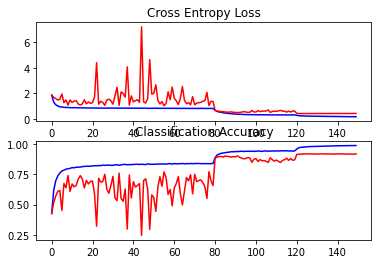

In [ ]:
summarize_diagnostics(history)

### We reach ~ 92% of accuracy which actually matches the results on the original paper when using the same architecture


## What happens when we use Kafs instead?

In [ ]:
resnet_20_kafs = resnet20(is_kaf=True)

In [ ]:
resnet_20_kafs.summary()

Model: "resnet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 32, 16)   448         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 32, 16)   64          conv2d[0][0]                     
__________________________________________________________________________________________________
kaf (Kaf)                       (None, 32, 32, 16)   408         batch_normalization[0][0]        
_____________________________________________________________________________________________

In [ ]:
resnet_20_kafs.compile(
              optimizer = tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.9),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
              metrics=['accuracy']
              )

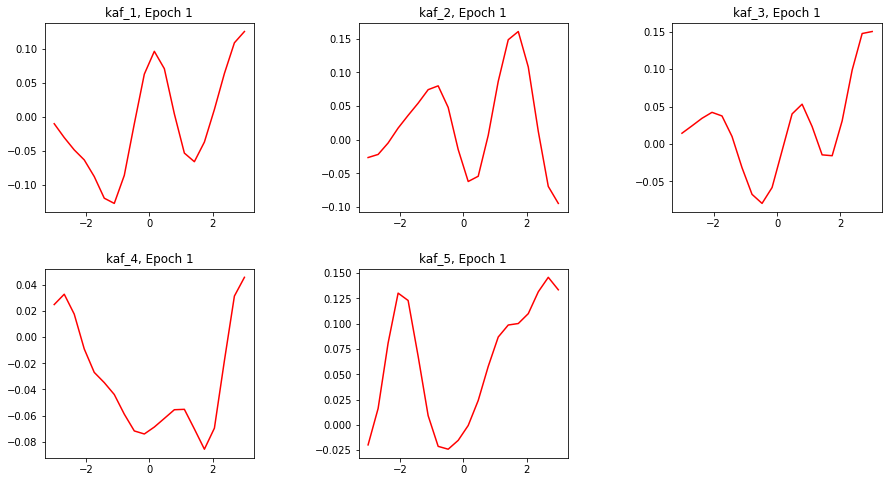

Epoch 1/150
391/391 [==============================] - 78s 199ms/step - loss: 3.6622 - accuracy: 0.1646 - val_loss: 3.2094 - val_accuracy: 0.2075


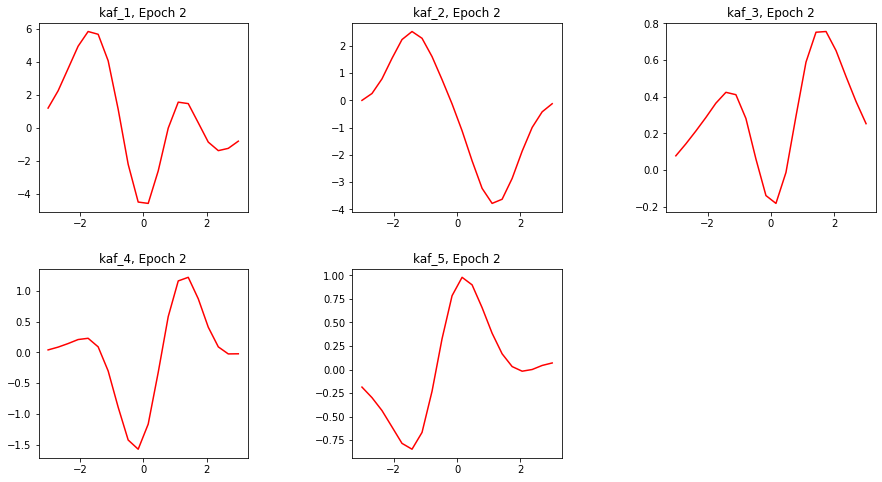

Epoch 2/150
391/391 [==============================] - 78s 199ms/step - loss: 2.5670 - accuracy: 0.3317 - val_loss: 3.3884 - val_accuracy: 0.1684


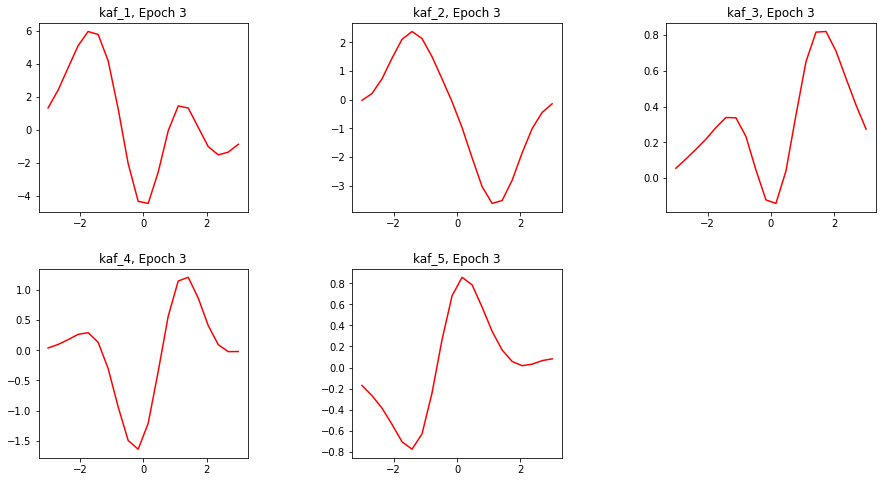

Epoch 3/150
391/391 [==============================] - 78s 199ms/step - loss: 1.9772 - accuracy: 0.4406 - val_loss: 2.7202 - val_accuracy: 0.2314


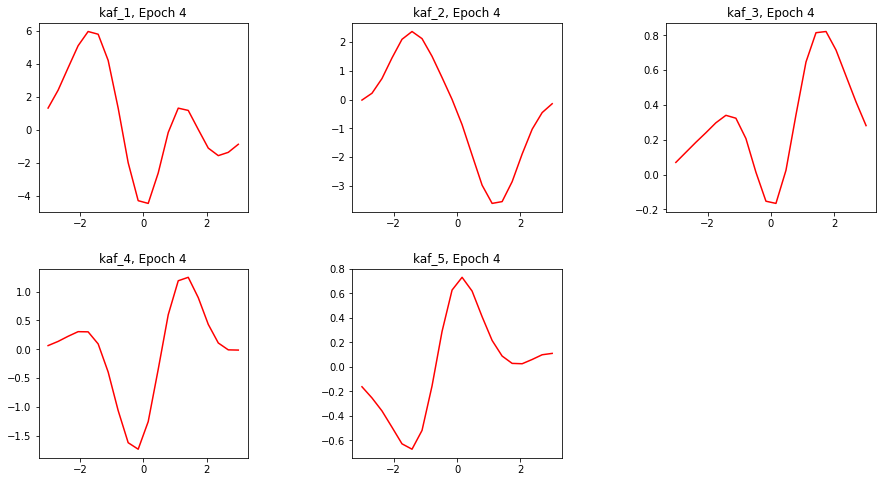

Epoch 4/150
391/391 [==============================] - 78s 200ms/step - loss: 1.6219 - accuracy: 0.5419 - val_loss: 1.9939 - val_accuracy: 0.4248


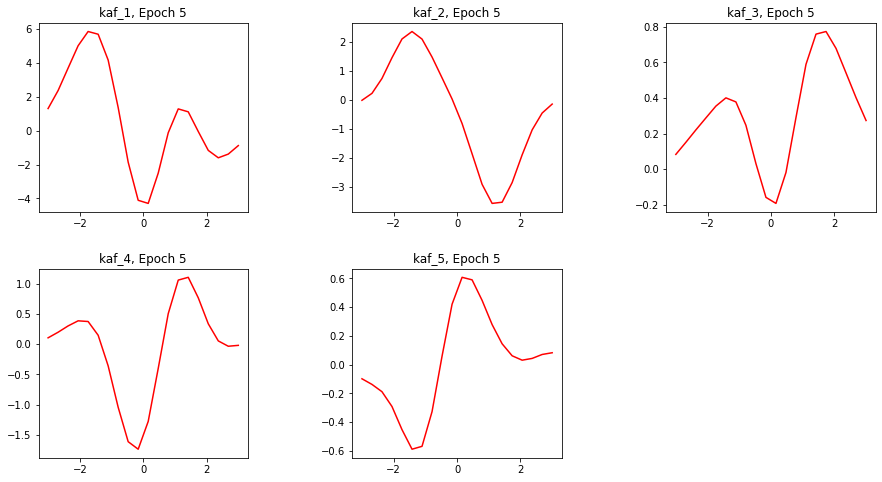

Epoch 5/150
391/391 [==============================] - 78s 200ms/step - loss: 1.4018 - accuracy: 0.6160 - val_loss: 2.6959 - val_accuracy: 0.2733


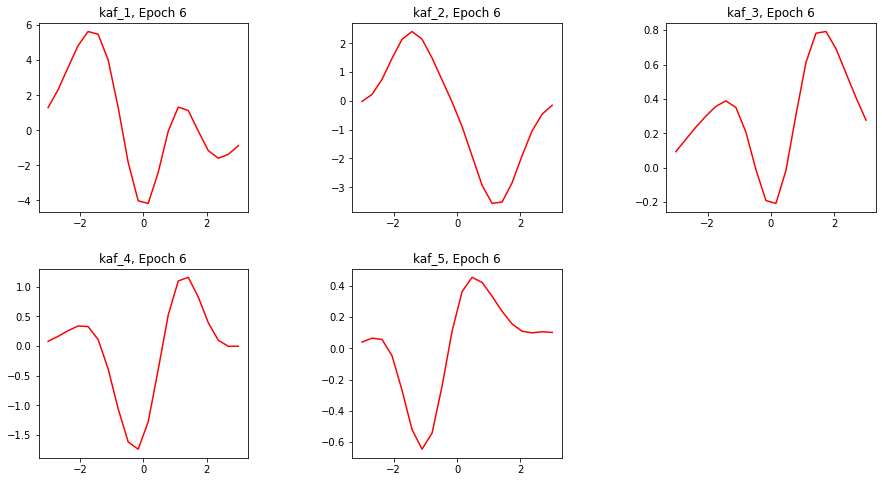

Epoch 6/150
391/391 [==============================] - 78s 199ms/step - loss: 1.2642 - accuracy: 0.6653 - val_loss: 1.9191 - val_accuracy: 0.4881


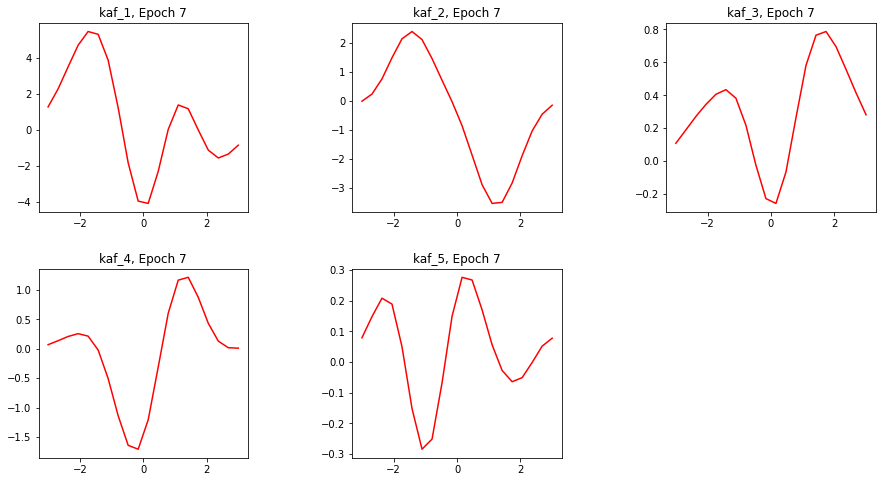

Epoch 7/150
391/391 [==============================] - 78s 200ms/step - loss: 1.1703 - accuracy: 0.6998 - val_loss: 1.6296 - val_accuracy: 0.5606


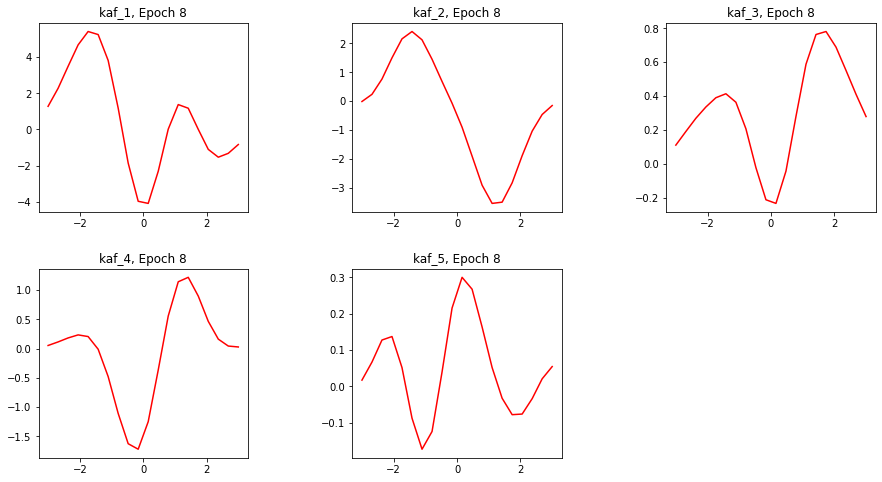

Epoch 8/150
391/391 [==============================] - 78s 200ms/step - loss: 1.1302 - accuracy: 0.7187 - val_loss: 2.3256 - val_accuracy: 0.4124


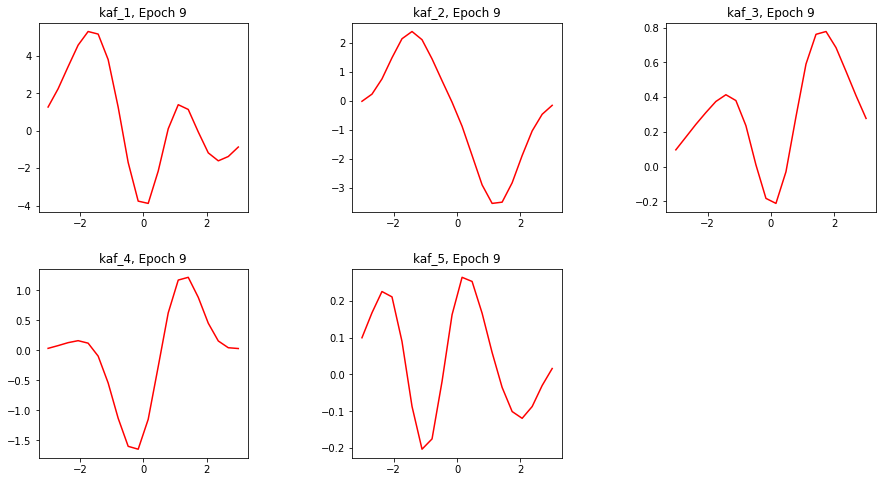

Epoch 9/150
391/391 [==============================] - 78s 200ms/step - loss: 1.0911 - accuracy: 0.7361 - val_loss: 1.5634 - val_accuracy: 0.5878


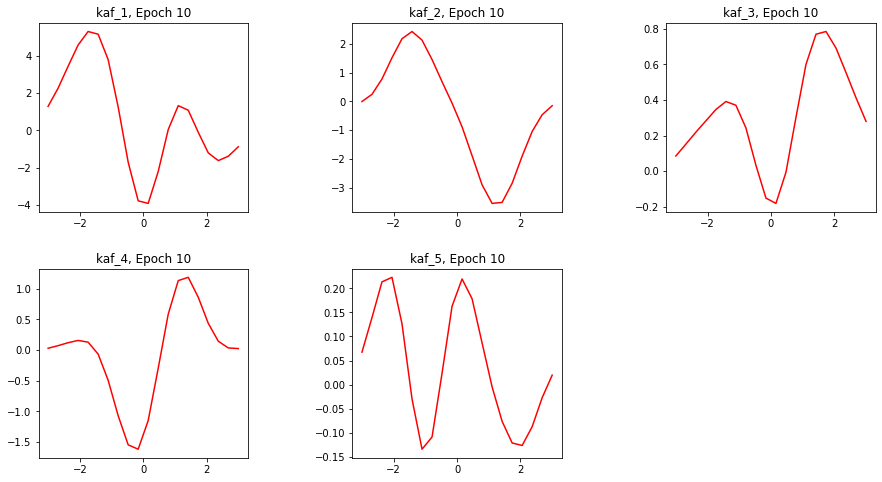

Epoch 10/150
391/391 [==============================] - 78s 200ms/step - loss: 1.0717 - accuracy: 0.7448 - val_loss: 1.4125 - val_accuracy: 0.6494


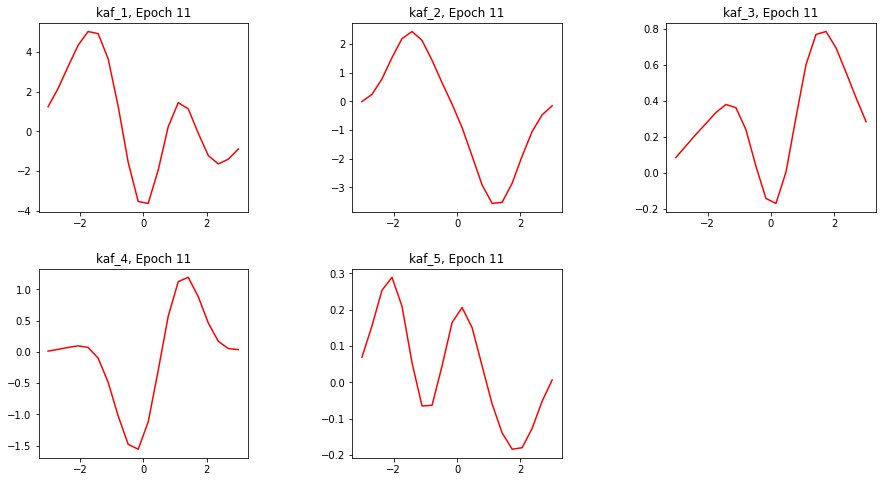

Epoch 11/150
391/391 [==============================] - 78s 200ms/step - loss: 1.0582 - accuracy: 0.7506 - val_loss: 1.4497 - val_accuracy: 0.6253


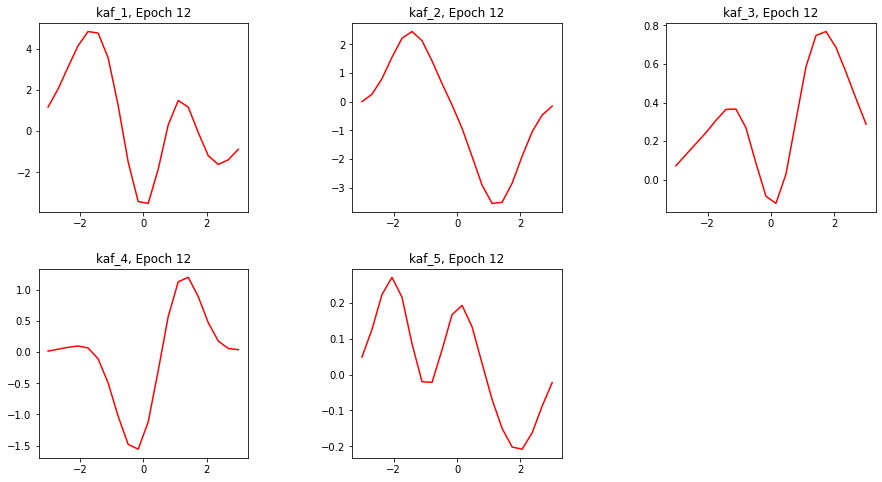

Epoch 12/150
391/391 [==============================] - 78s 200ms/step - loss: 1.0319 - accuracy: 0.7611 - val_loss: 1.5871 - val_accuracy: 0.6163


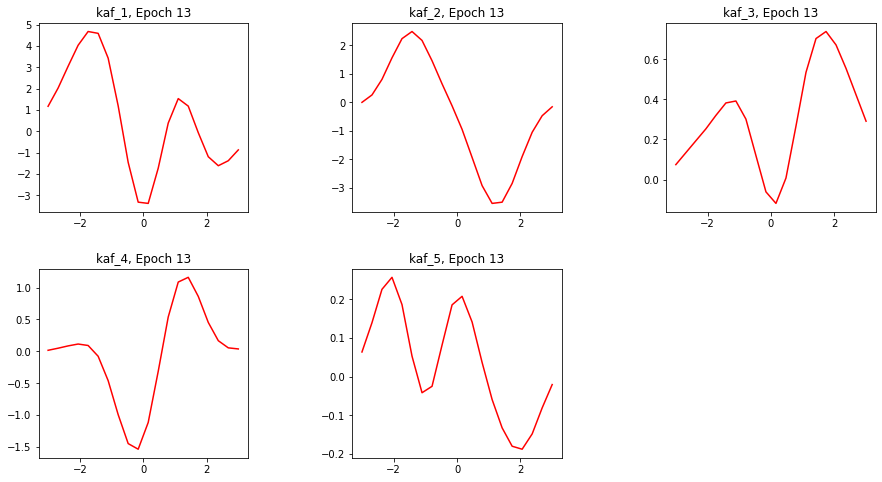

Epoch 13/150
391/391 [==============================] - 78s 200ms/step - loss: 1.0210 - accuracy: 0.7660 - val_loss: 2.7675 - val_accuracy: 0.4017


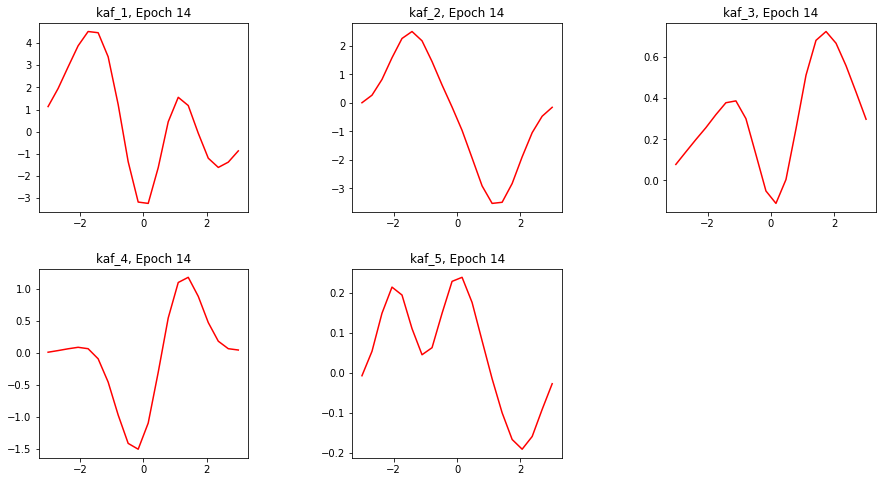

Epoch 14/150
391/391 [==============================] - 78s 200ms/step - loss: 1.0027 - accuracy: 0.7723 - val_loss: 1.6353 - val_accuracy: 0.6230


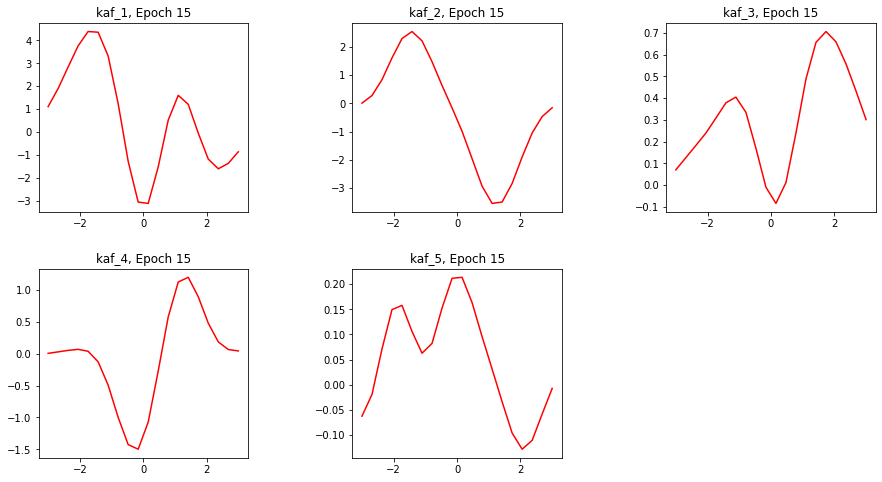

Epoch 15/150
391/391 [==============================] - 78s 200ms/step - loss: 1.0031 - accuracy: 0.7725 - val_loss: 1.4870 - val_accuracy: 0.6418


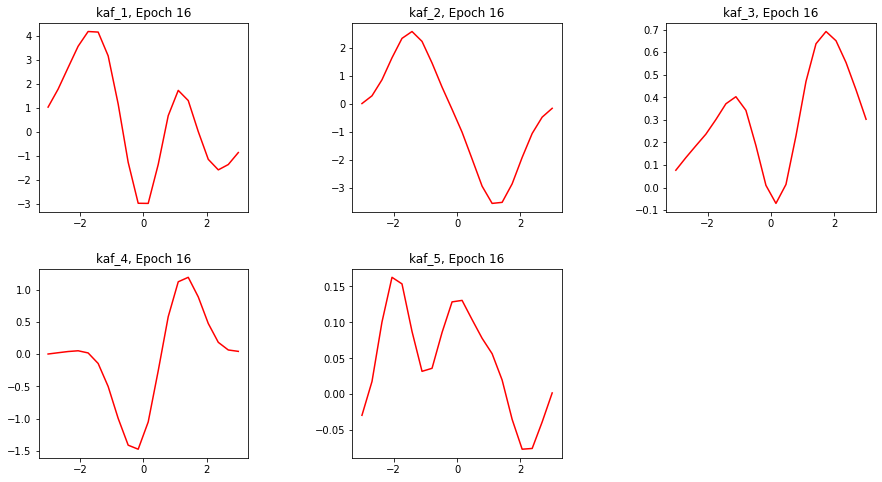

Epoch 16/150
391/391 [==============================] - 78s 200ms/step - loss: 1.0026 - accuracy: 0.7752 - val_loss: 1.5606 - val_accuracy: 0.6211


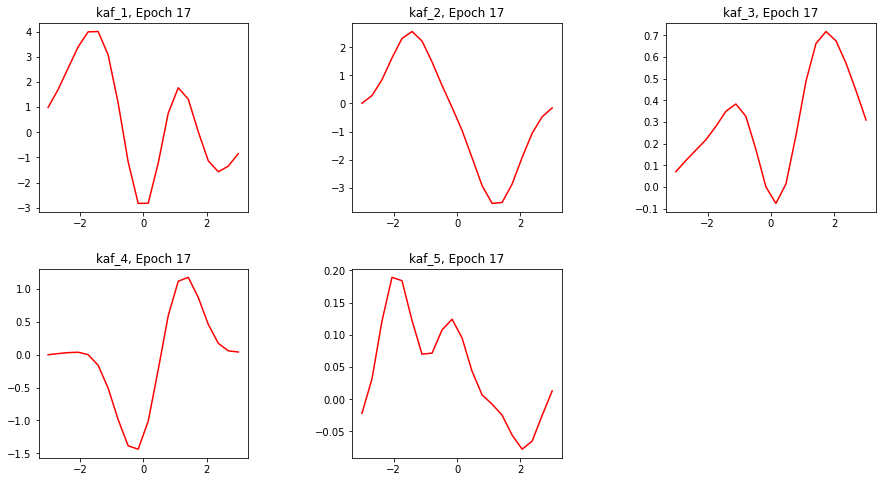

Epoch 17/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9935 - accuracy: 0.7781 - val_loss: 1.7748 - val_accuracy: 0.5630


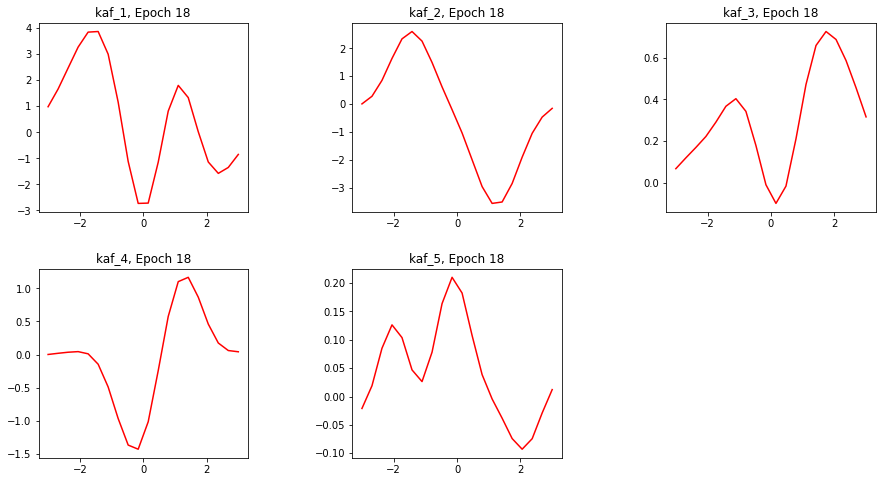

Epoch 18/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9911 - accuracy: 0.7800 - val_loss: 1.8889 - val_accuracy: 0.5087


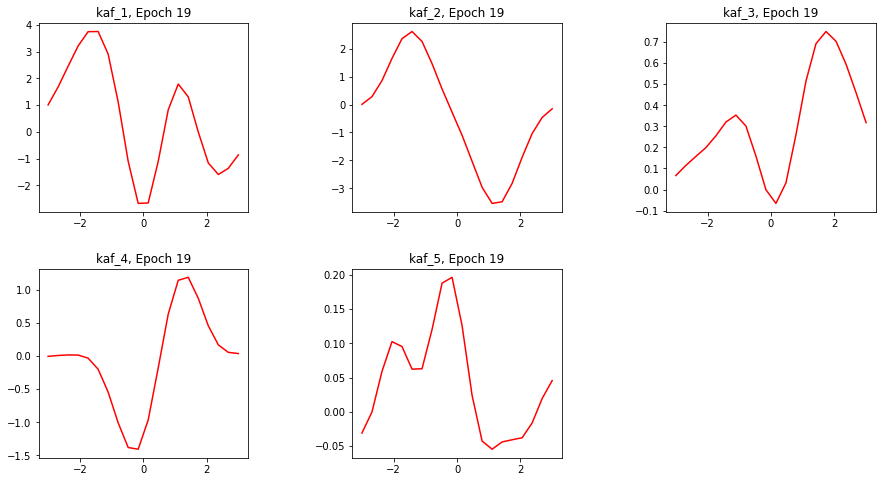

Epoch 19/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9841 - accuracy: 0.7851 - val_loss: 1.5646 - val_accuracy: 0.6164


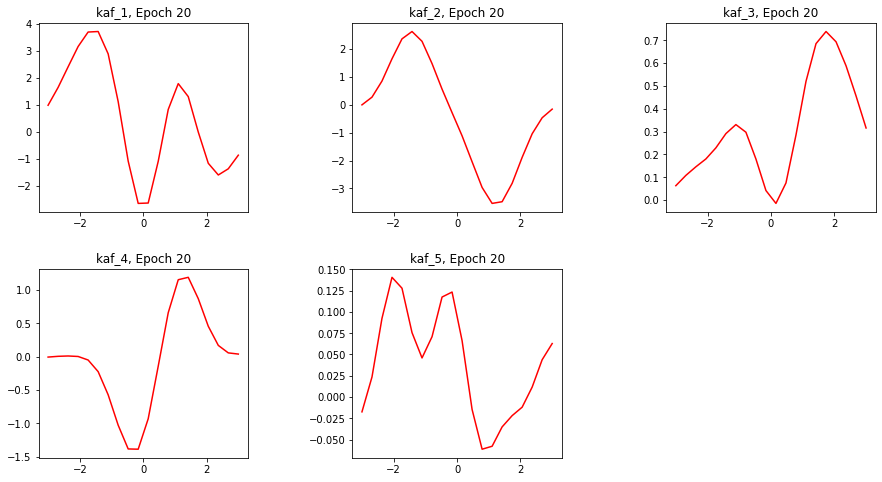

Epoch 20/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9779 - accuracy: 0.7870 - val_loss: 1.3847 - val_accuracy: 0.6557


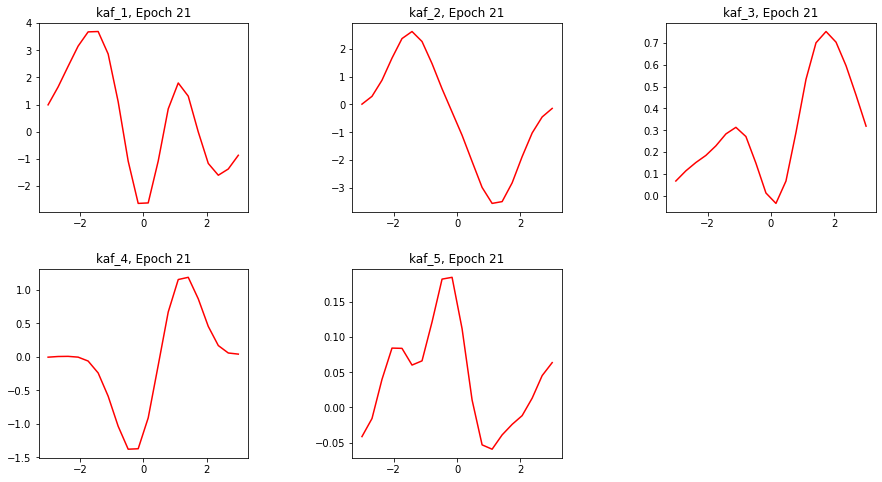

Epoch 21/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9771 - accuracy: 0.7916 - val_loss: 1.5368 - val_accuracy: 0.6341


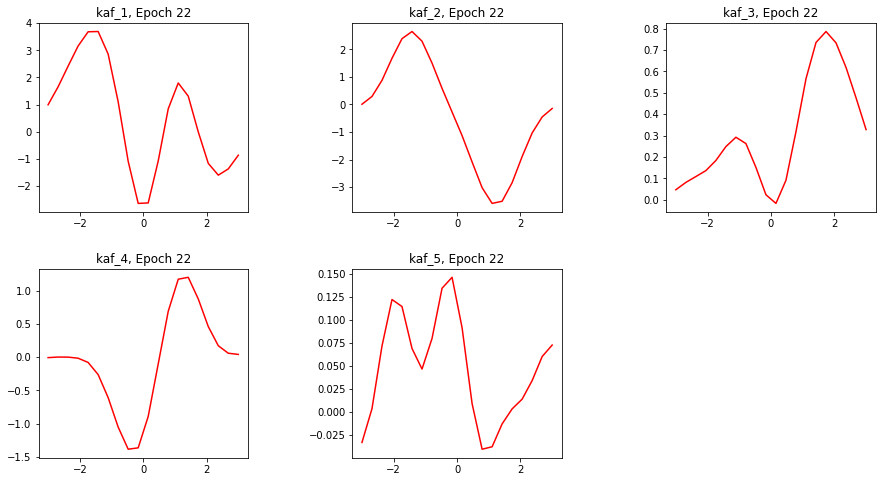

Epoch 22/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9716 - accuracy: 0.7907 - val_loss: 1.4099 - val_accuracy: 0.6503


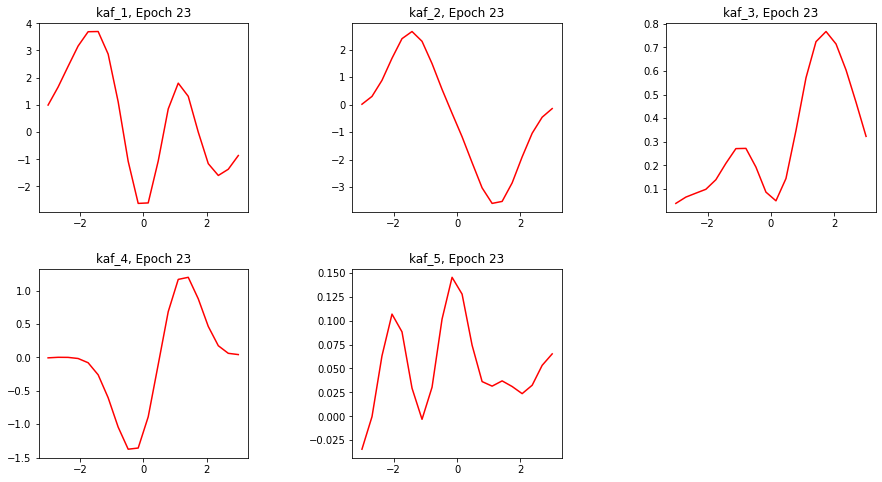

Epoch 23/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9741 - accuracy: 0.7926 - val_loss: 1.5581 - val_accuracy: 0.6303


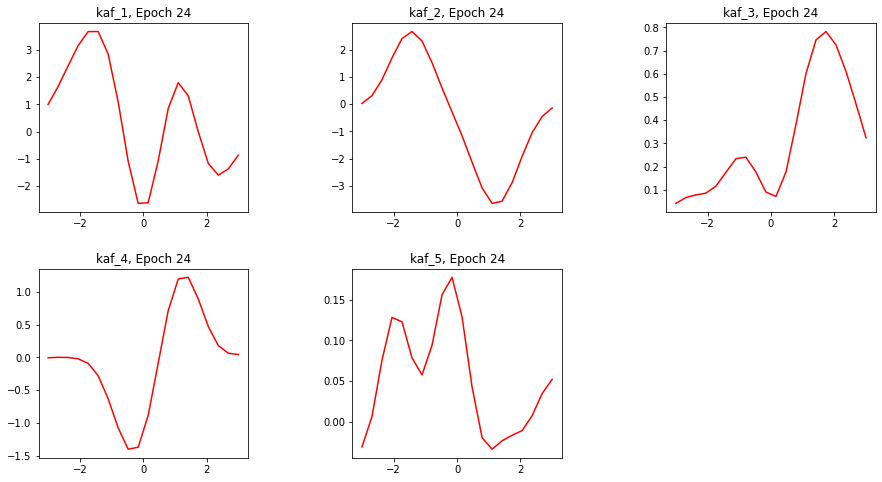

Epoch 24/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9728 - accuracy: 0.7934 - val_loss: 1.7013 - val_accuracy: 0.5750


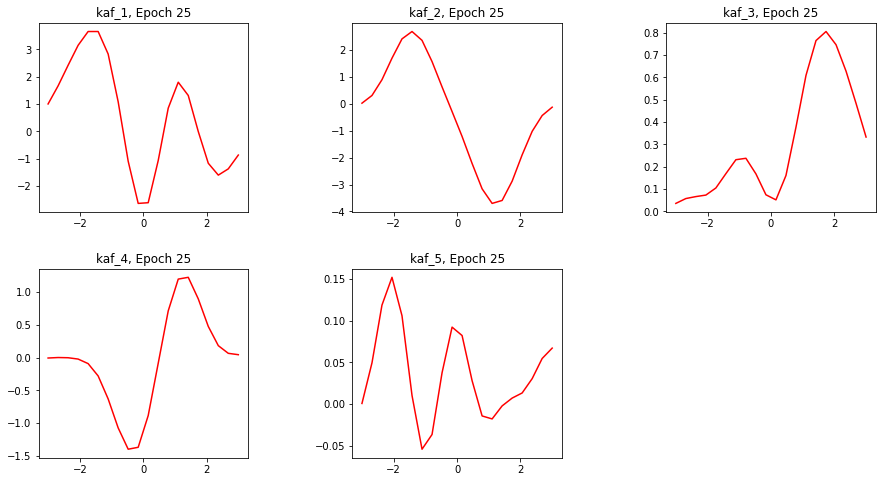

Epoch 25/150
391/391 [==============================] - 78s 201ms/step - loss: 0.9596 - accuracy: 0.7996 - val_loss: 1.4802 - val_accuracy: 0.6504


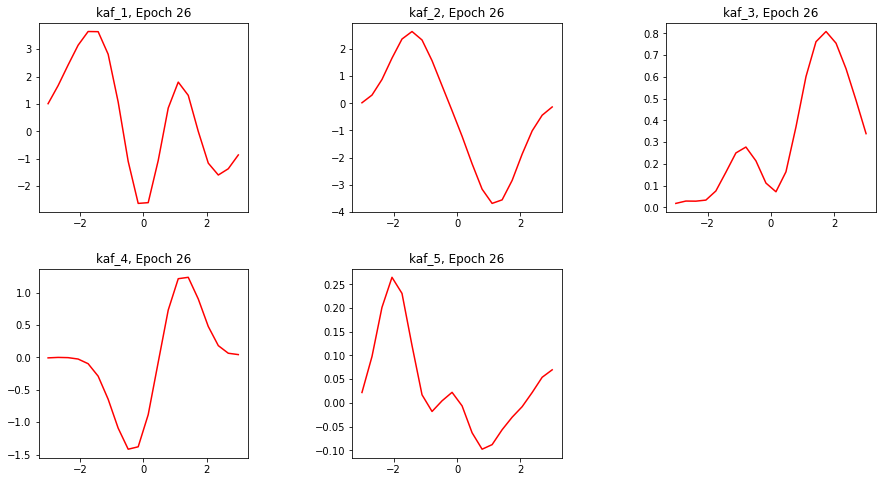

Epoch 26/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9564 - accuracy: 0.7977 - val_loss: 1.2727 - val_accuracy: 0.7030


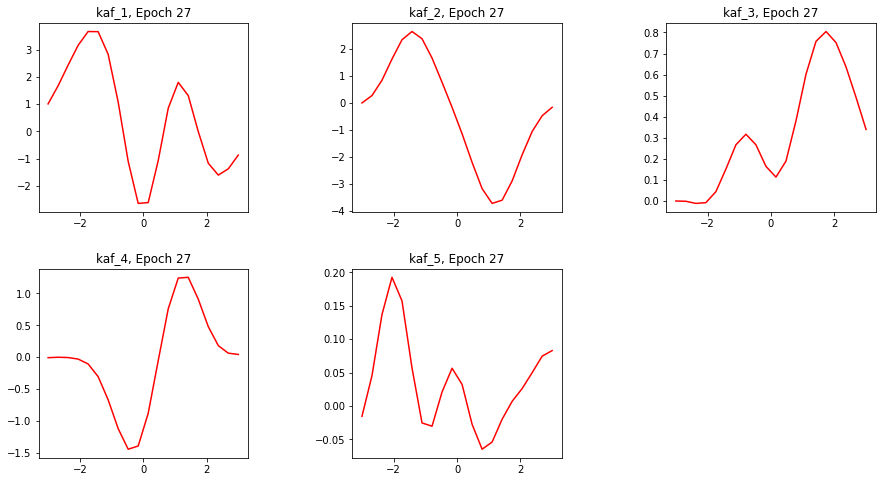

Epoch 27/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9512 - accuracy: 0.7980 - val_loss: 1.4266 - val_accuracy: 0.6542


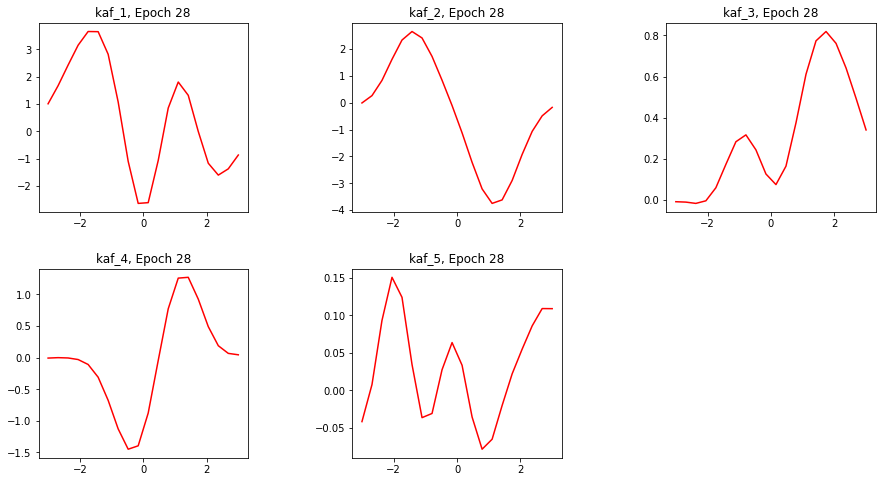

Epoch 28/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9422 - accuracy: 0.8022 - val_loss: 1.5890 - val_accuracy: 0.6261


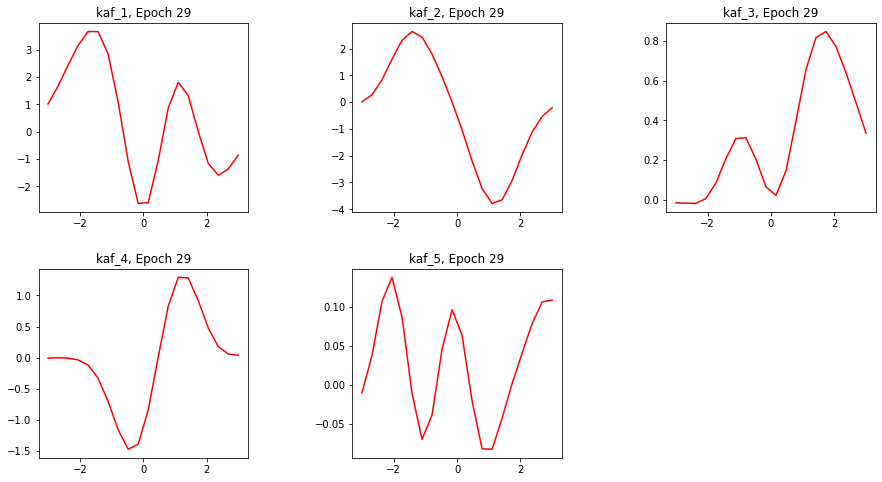

Epoch 29/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9421 - accuracy: 0.8004 - val_loss: 1.8302 - val_accuracy: 0.5649


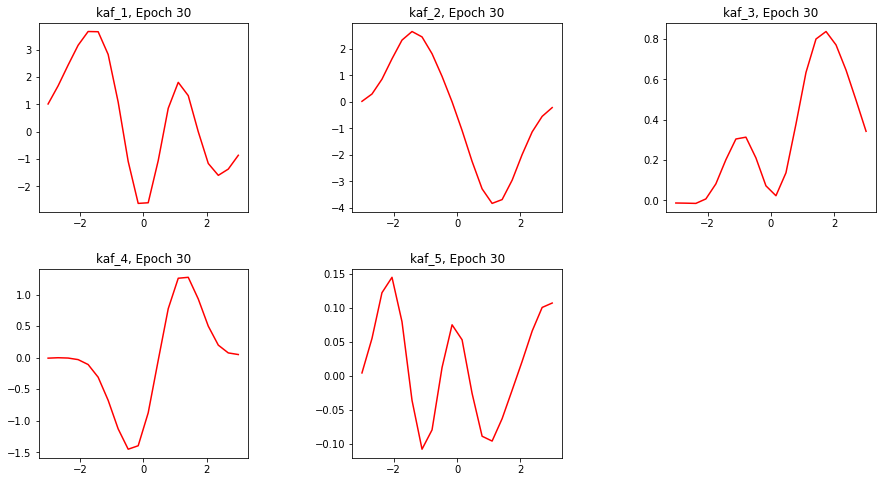

Epoch 30/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9344 - accuracy: 0.8040 - val_loss: 1.8209 - val_accuracy: 0.5596


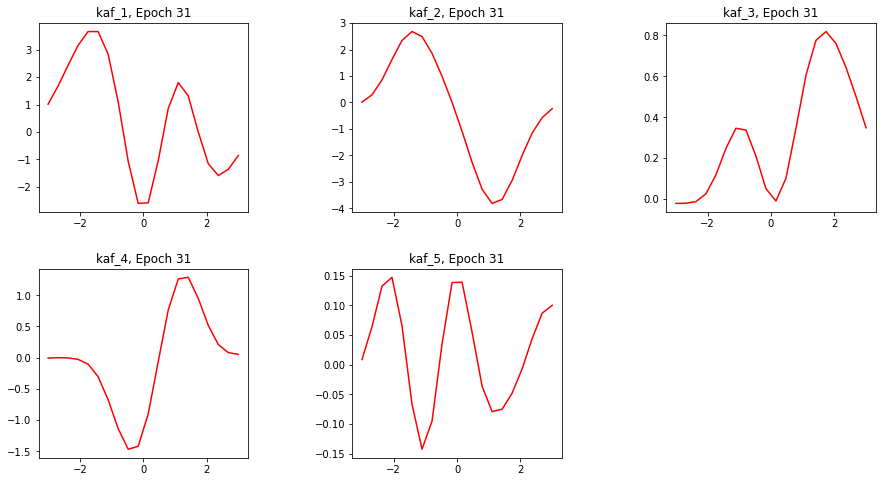

Epoch 31/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9410 - accuracy: 0.8044 - val_loss: 1.3771 - val_accuracy: 0.6739


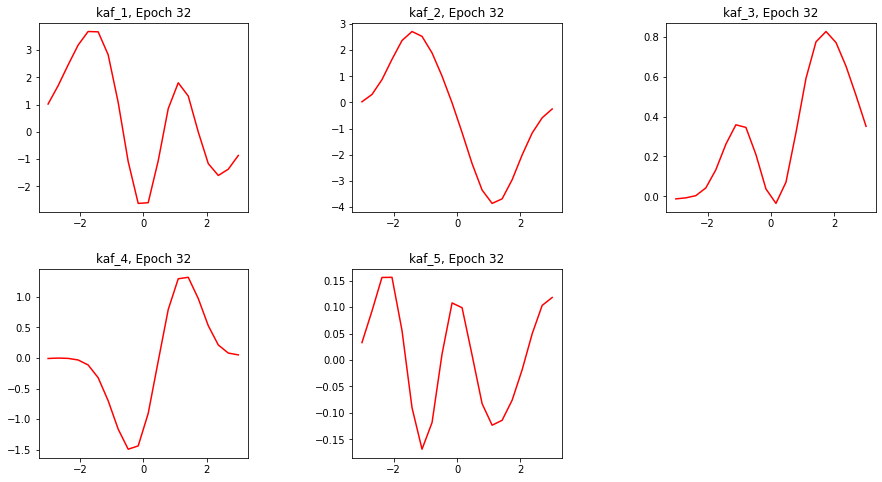

Epoch 32/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9442 - accuracy: 0.8038 - val_loss: 1.6257 - val_accuracy: 0.6173


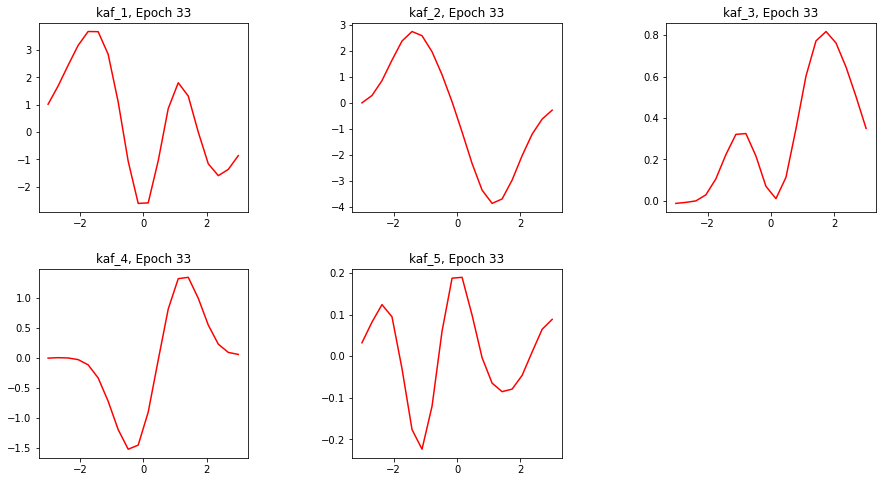

Epoch 33/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9271 - accuracy: 0.8083 - val_loss: 1.7321 - val_accuracy: 0.6033


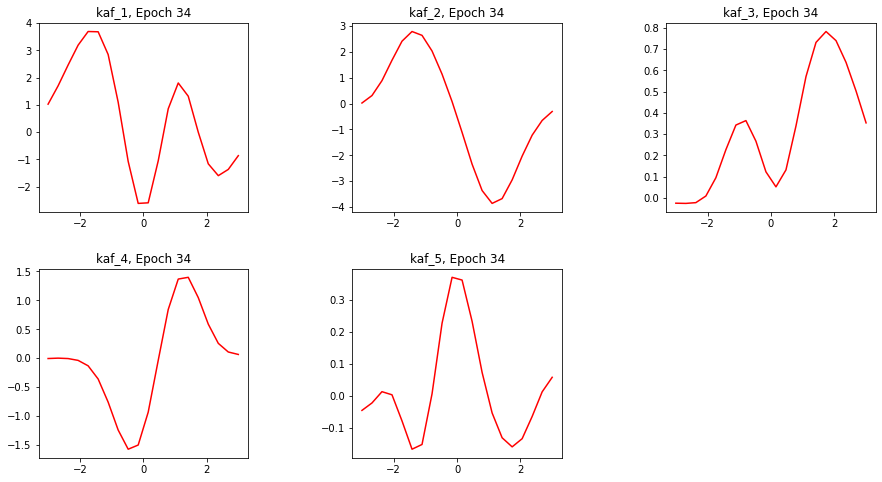

Epoch 34/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9236 - accuracy: 0.8107 - val_loss: 1.9962 - val_accuracy: 0.5400


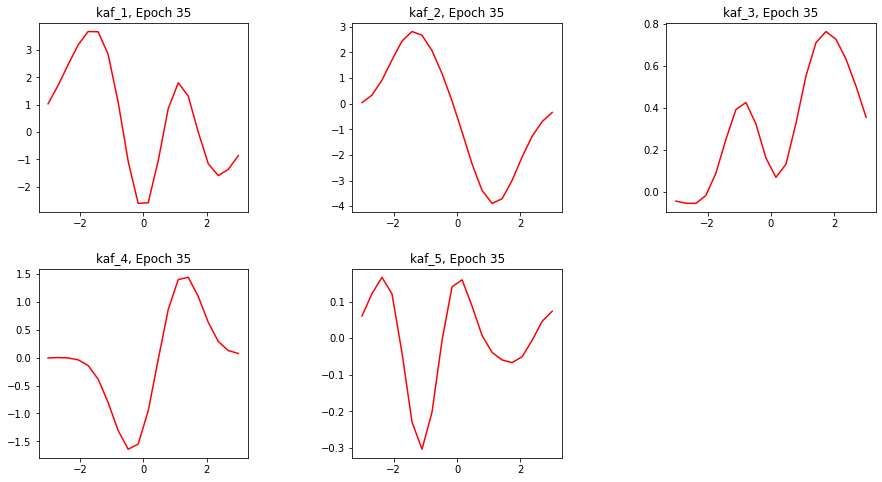

Epoch 35/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9280 - accuracy: 0.8087 - val_loss: 1.5787 - val_accuracy: 0.6228


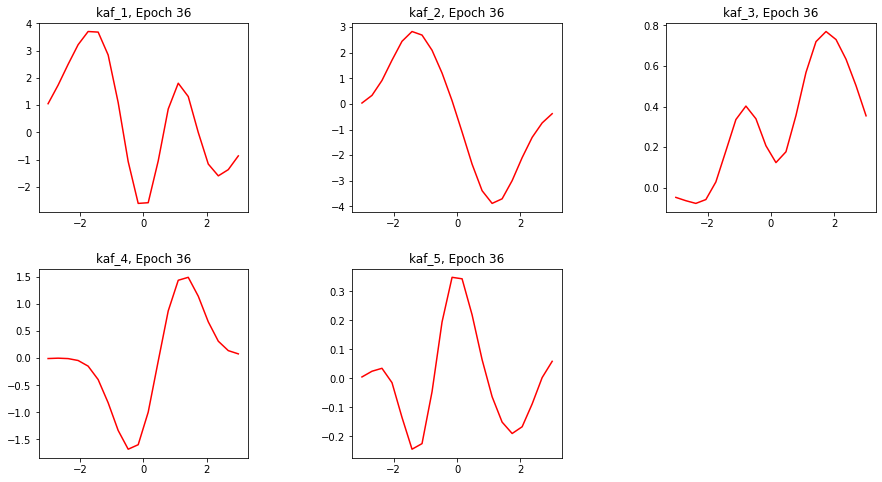

Epoch 36/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9241 - accuracy: 0.8109 - val_loss: 1.9552 - val_accuracy: 0.5561


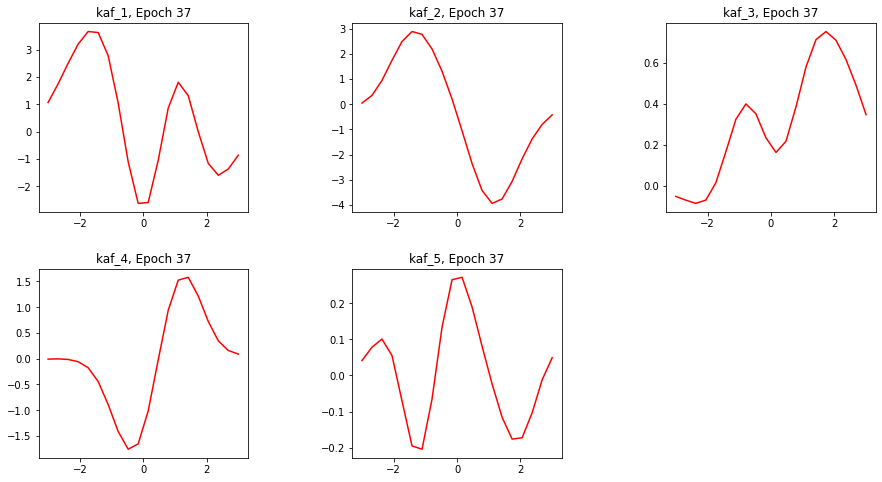

Epoch 37/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9224 - accuracy: 0.8102 - val_loss: 1.5567 - val_accuracy: 0.6051


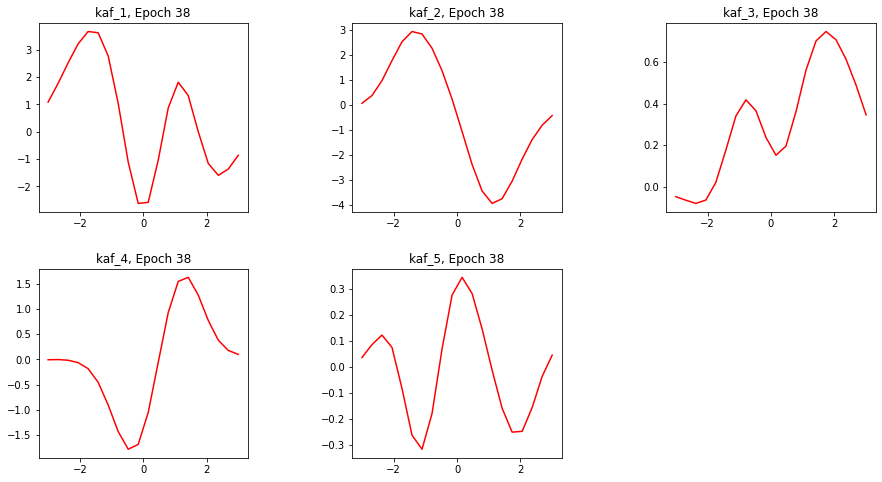

Epoch 38/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9229 - accuracy: 0.8095 - val_loss: 1.7970 - val_accuracy: 0.5772


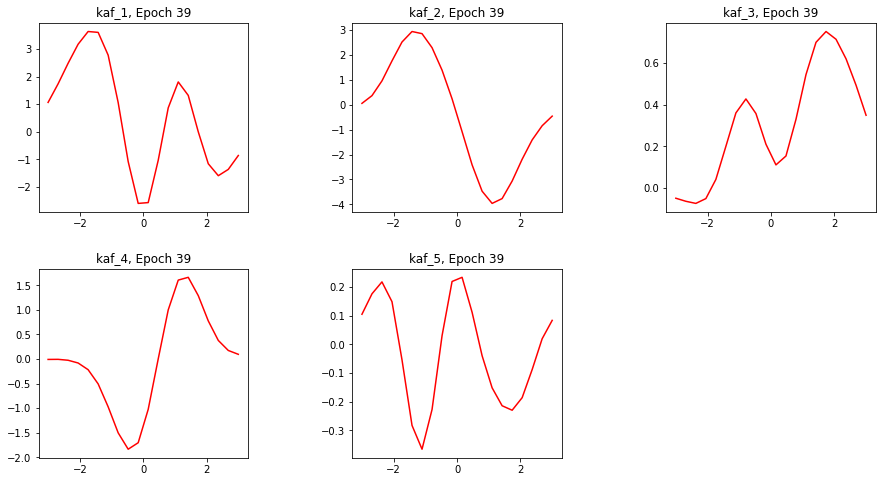

Epoch 39/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9174 - accuracy: 0.8136 - val_loss: 1.5324 - val_accuracy: 0.6262


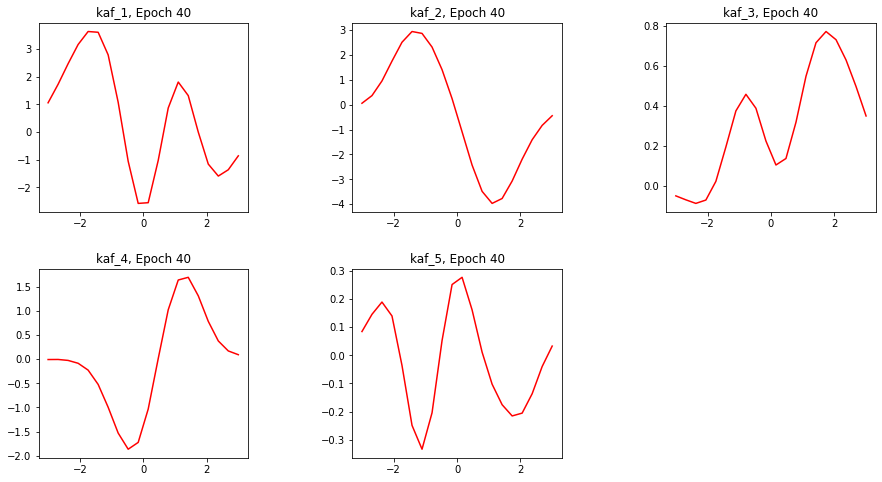

Epoch 40/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9331 - accuracy: 0.8121 - val_loss: 1.3414 - val_accuracy: 0.6756


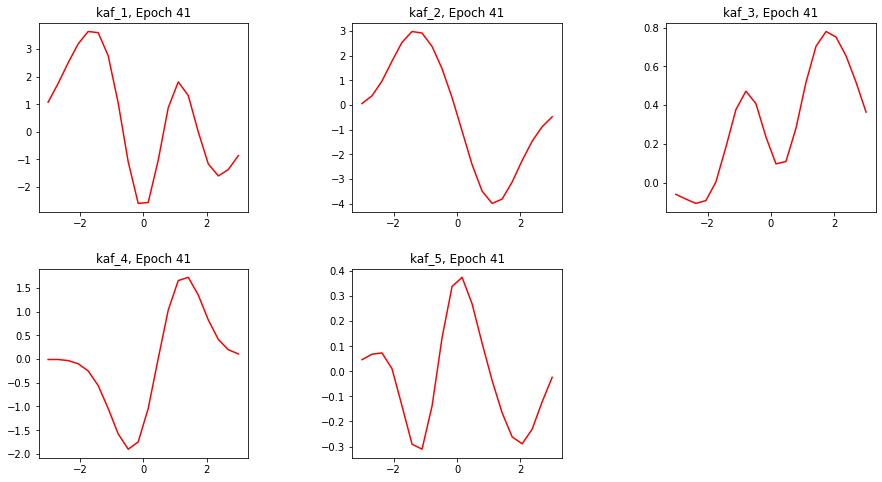

Epoch 41/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9216 - accuracy: 0.8147 - val_loss: 2.1680 - val_accuracy: 0.4968


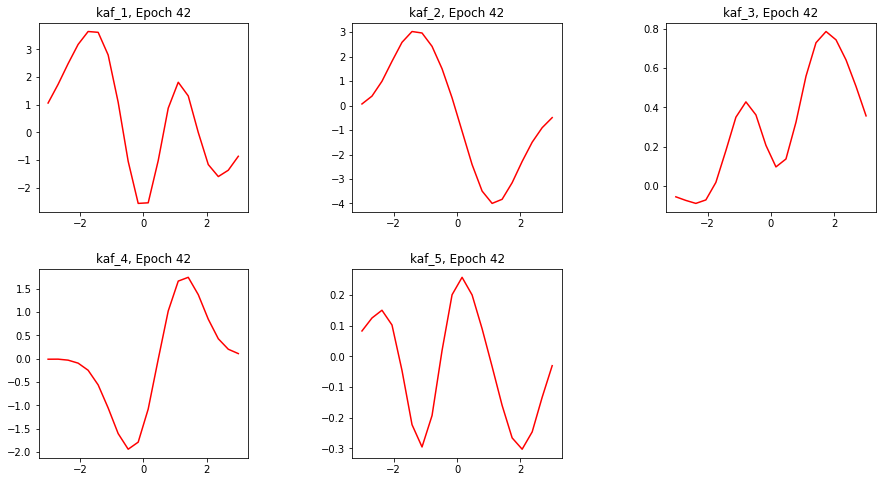

Epoch 42/150
391/391 [==============================] - 78s 201ms/step - loss: 0.9232 - accuracy: 0.8120 - val_loss: 1.7188 - val_accuracy: 0.5944


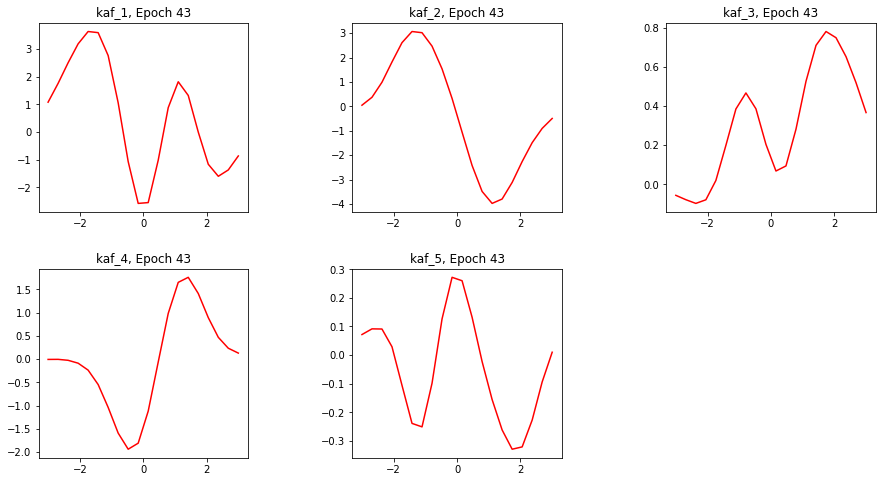

Epoch 43/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9282 - accuracy: 0.8121 - val_loss: 1.2944 - val_accuracy: 0.6984


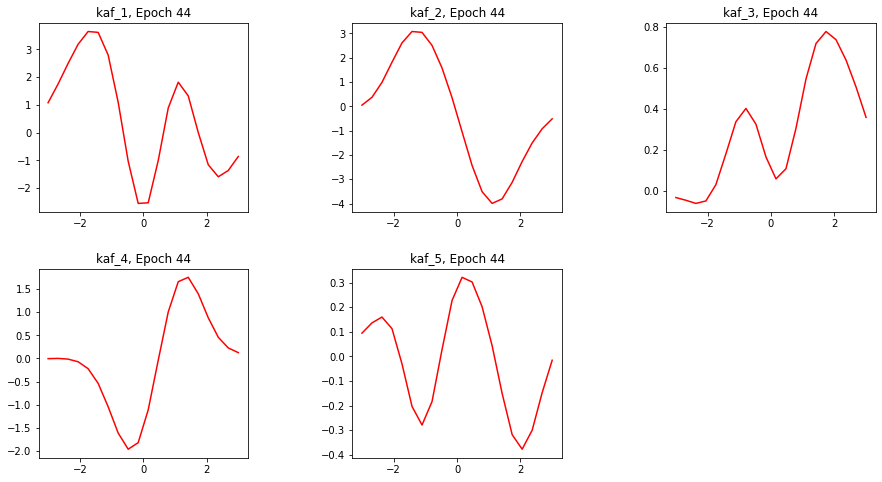

Epoch 44/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9148 - accuracy: 0.8159 - val_loss: 1.5064 - val_accuracy: 0.6579


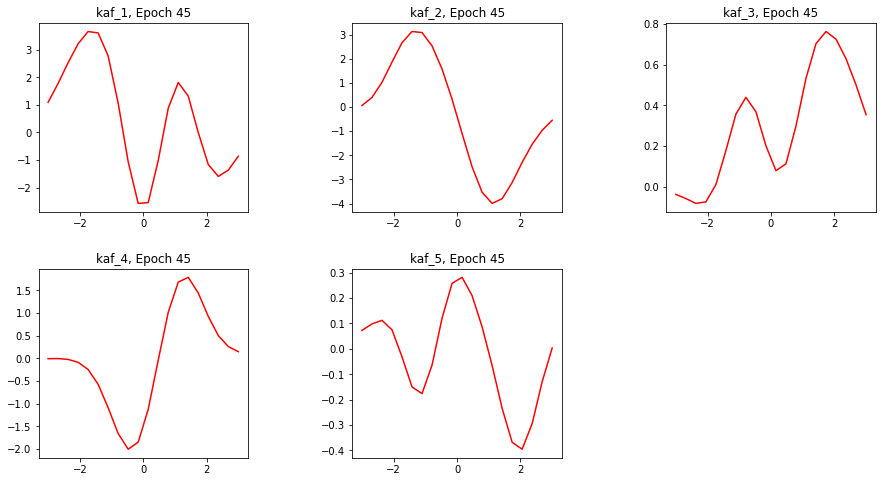

Epoch 45/150
391/391 [==============================] - 78s 201ms/step - loss: 0.9045 - accuracy: 0.8164 - val_loss: 1.3961 - val_accuracy: 0.6636


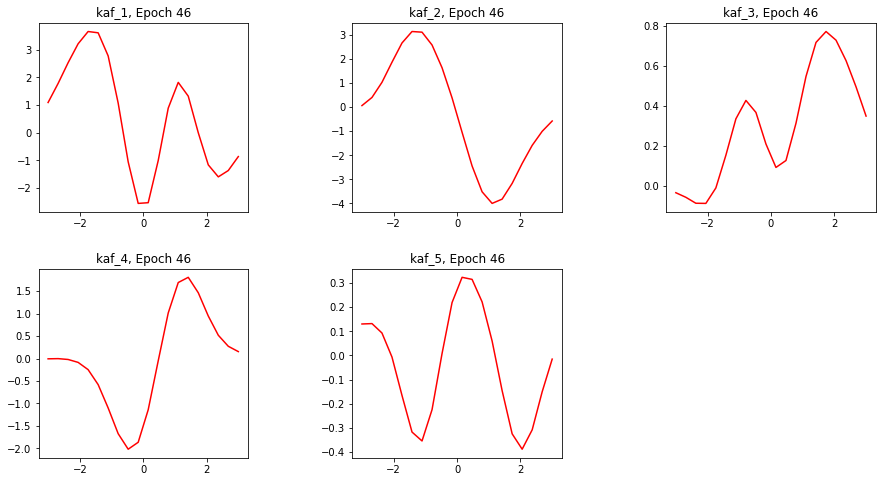

Epoch 46/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9042 - accuracy: 0.8177 - val_loss: 1.6579 - val_accuracy: 0.6080


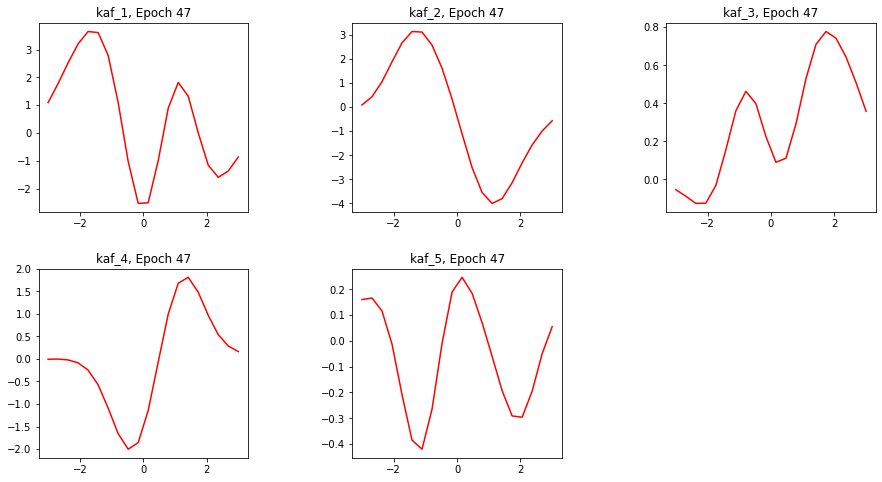

Epoch 47/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9131 - accuracy: 0.8139 - val_loss: 1.2850 - val_accuracy: 0.6972


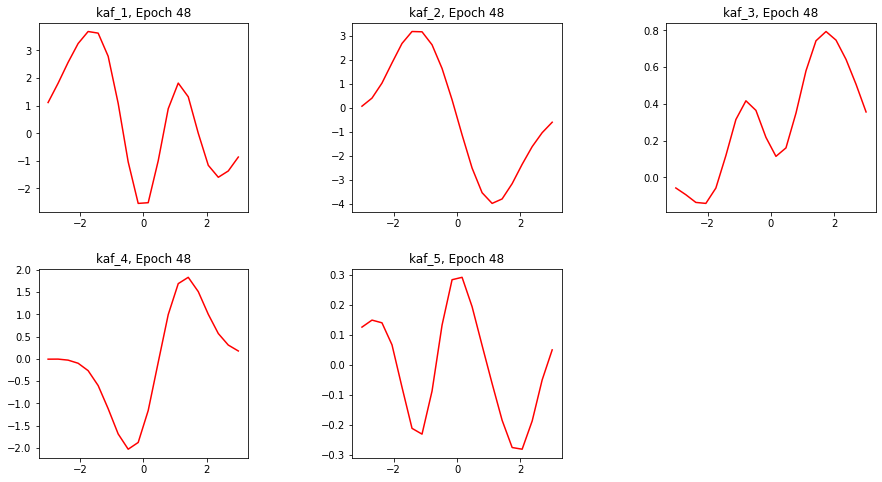

Epoch 48/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8990 - accuracy: 0.8194 - val_loss: 1.5354 - val_accuracy: 0.6237


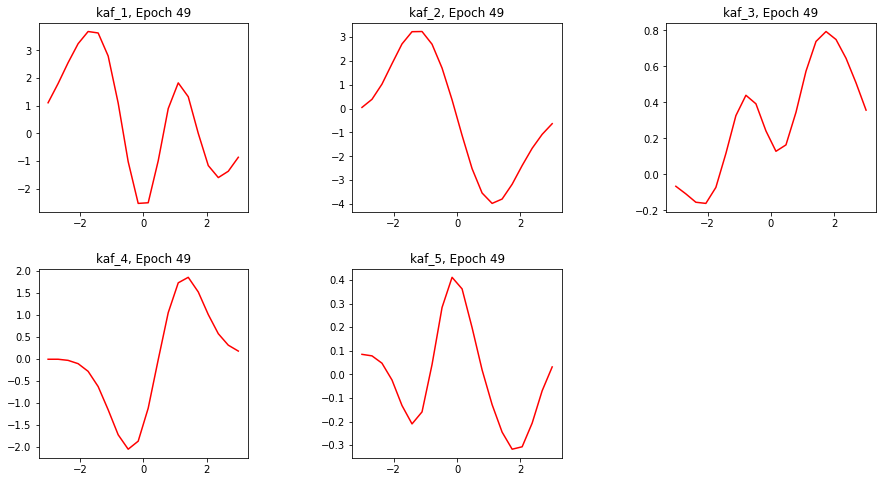

Epoch 49/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9108 - accuracy: 0.8157 - val_loss: 2.0898 - val_accuracy: 0.4898


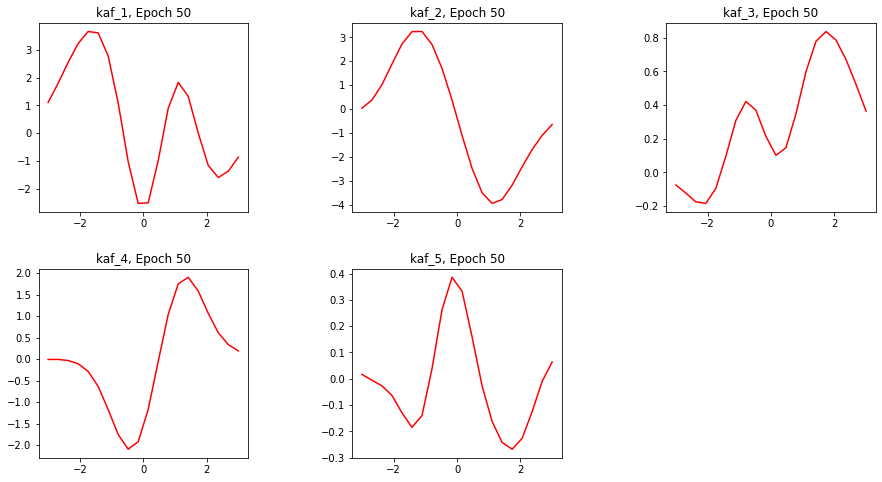

Epoch 50/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9032 - accuracy: 0.8179 - val_loss: 3.4010 - val_accuracy: 0.3223


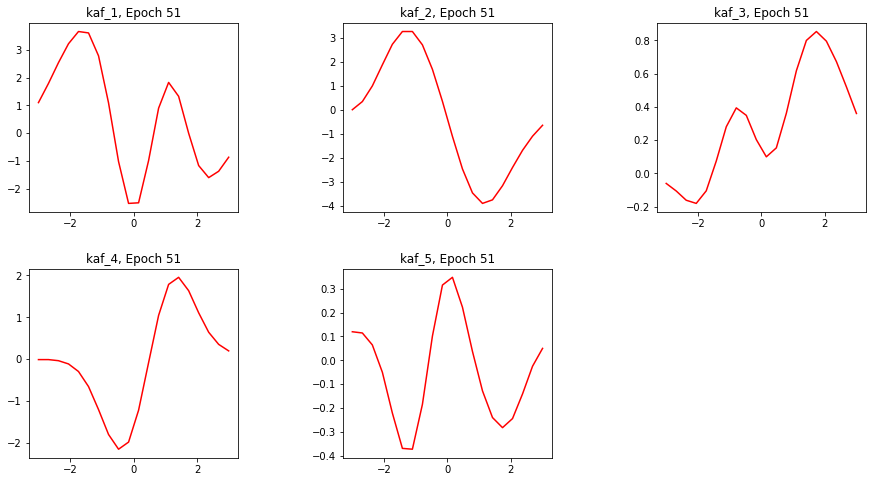

Epoch 51/150
391/391 [==============================] - 78s 201ms/step - loss: 0.9064 - accuracy: 0.8177 - val_loss: 1.7300 - val_accuracy: 0.5669


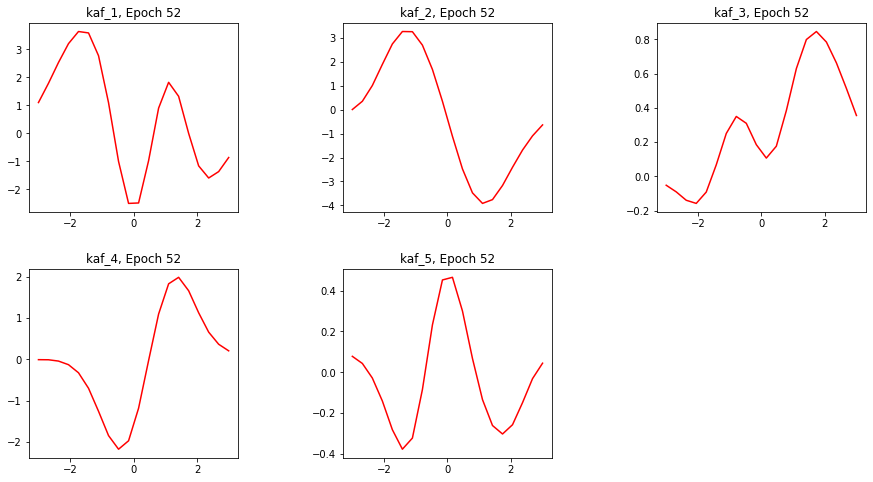

Epoch 52/150
391/391 [==============================] - 78s 201ms/step - loss: 0.9035 - accuracy: 0.8189 - val_loss: 1.6130 - val_accuracy: 0.6165


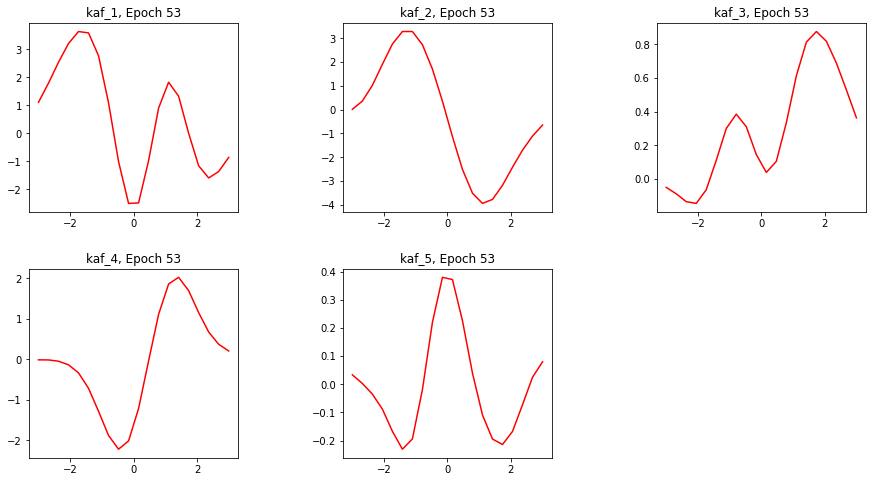

Epoch 53/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9020 - accuracy: 0.8199 - val_loss: 1.4851 - val_accuracy: 0.6487


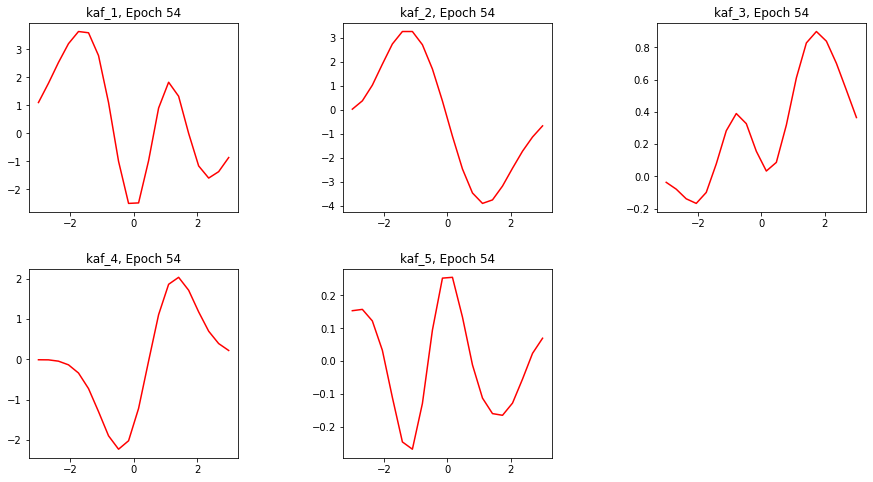

Epoch 54/150
391/391 [==============================] - 79s 201ms/step - loss: 0.9014 - accuracy: 0.8181 - val_loss: 1.4808 - val_accuracy: 0.6713


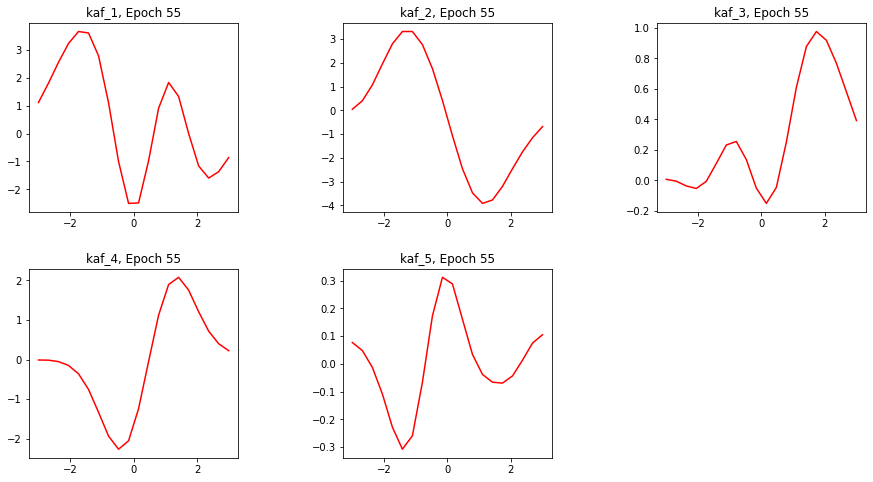

Epoch 55/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8947 - accuracy: 0.8226 - val_loss: 1.7034 - val_accuracy: 0.6230


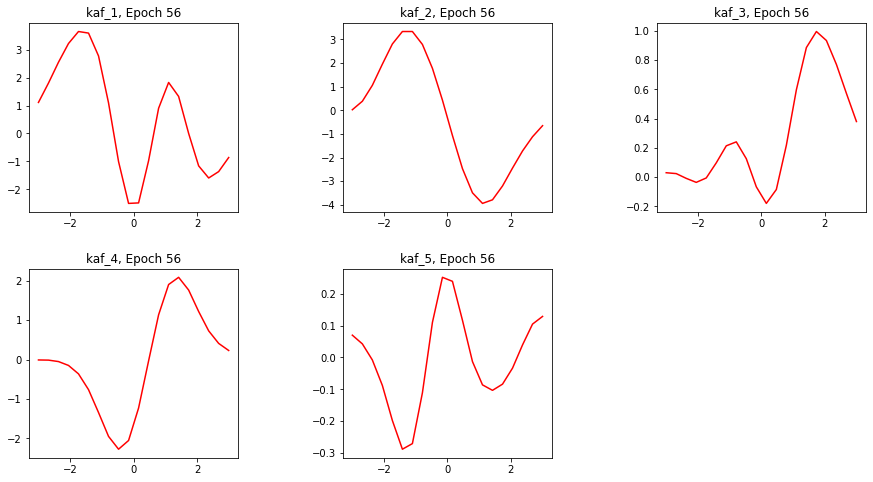

Epoch 56/150
391/391 [==============================] - 78s 200ms/step - loss: 0.9003 - accuracy: 0.8198 - val_loss: 1.5202 - val_accuracy: 0.6601


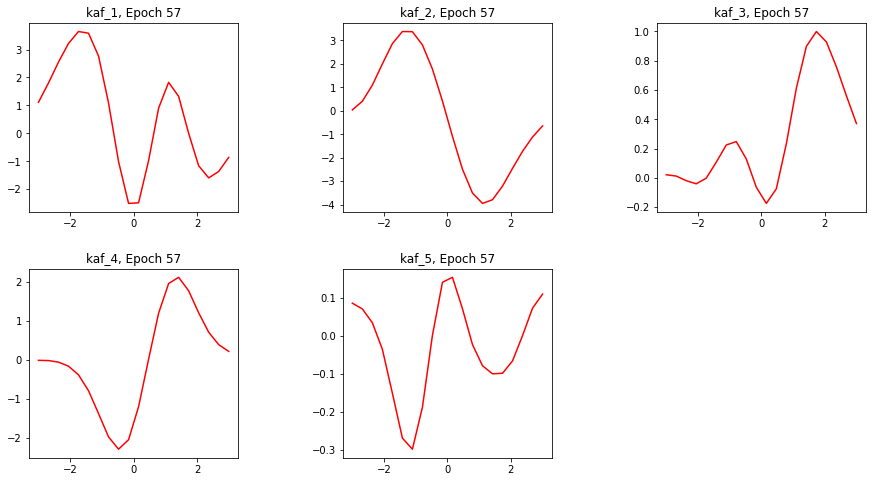

Epoch 57/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8921 - accuracy: 0.8221 - val_loss: 1.5857 - val_accuracy: 0.6568


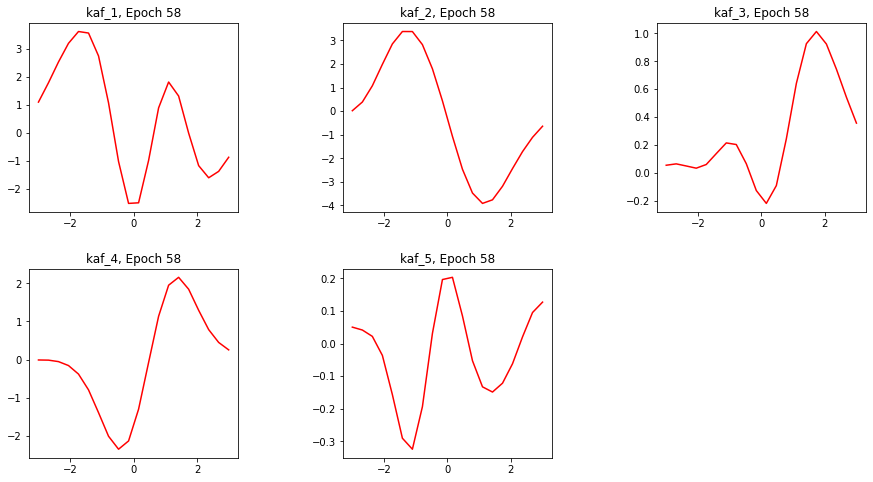

Epoch 58/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8817 - accuracy: 0.8256 - val_loss: 1.6351 - val_accuracy: 0.6138


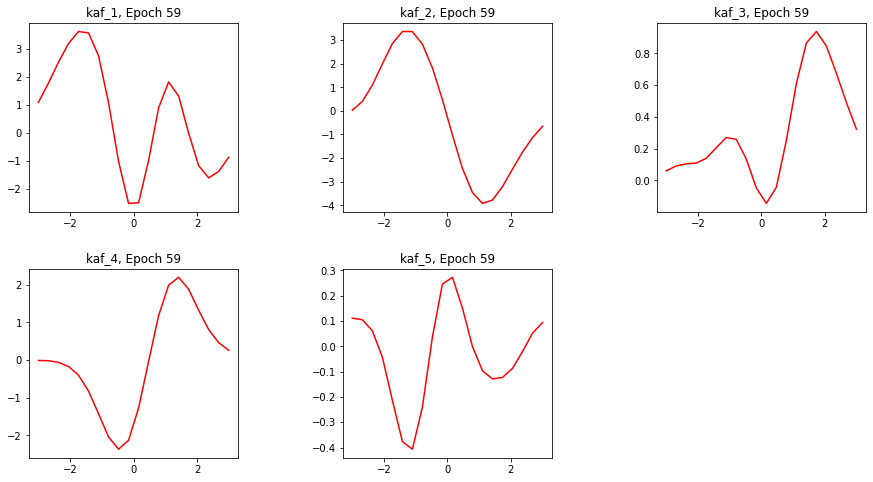

Epoch 59/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8849 - accuracy: 0.8220 - val_loss: 1.5482 - val_accuracy: 0.6530


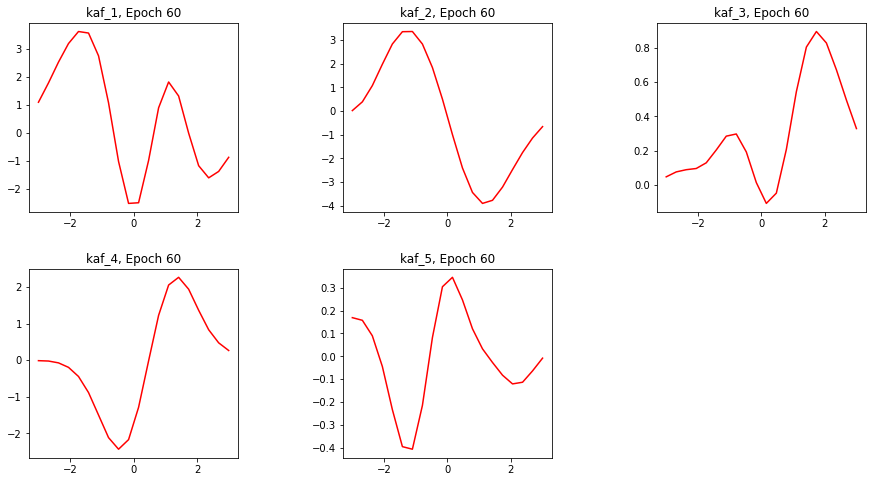

Epoch 60/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8931 - accuracy: 0.8207 - val_loss: 1.8635 - val_accuracy: 0.5636


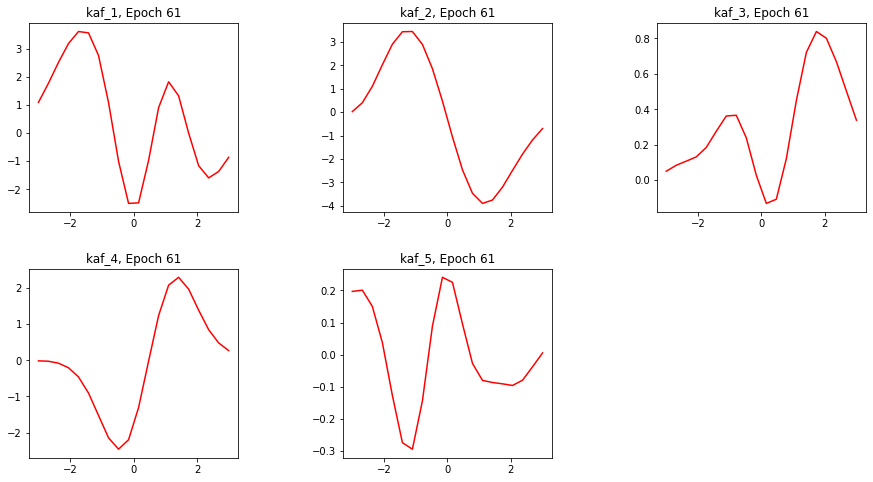

Epoch 61/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8941 - accuracy: 0.8205 - val_loss: 1.2479 - val_accuracy: 0.7050


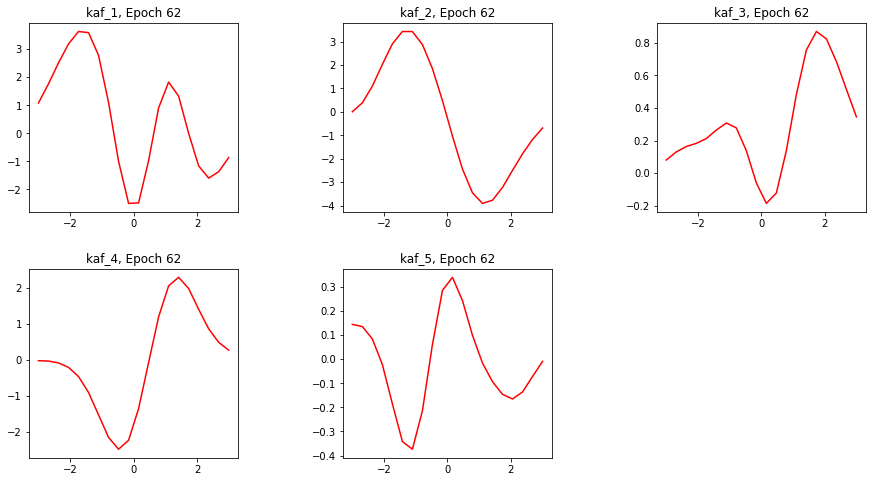

Epoch 62/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8966 - accuracy: 0.8200 - val_loss: 1.4900 - val_accuracy: 0.6358


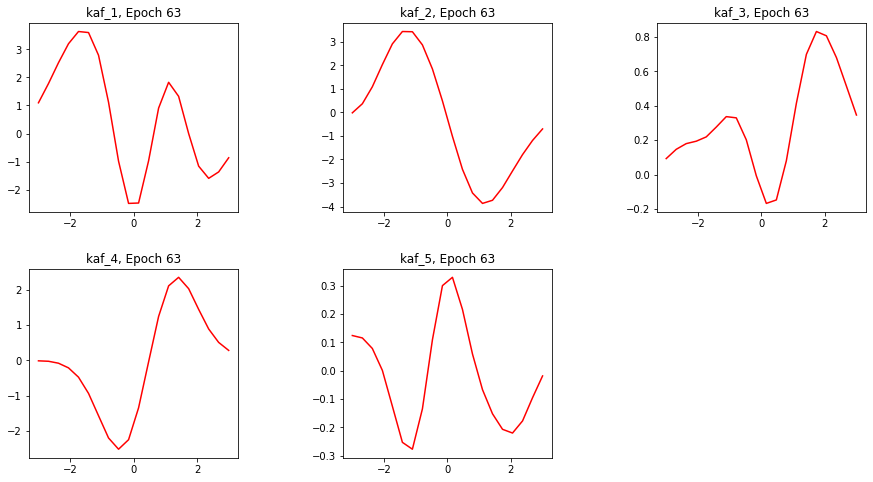

Epoch 63/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8875 - accuracy: 0.8240 - val_loss: 2.0723 - val_accuracy: 0.5019


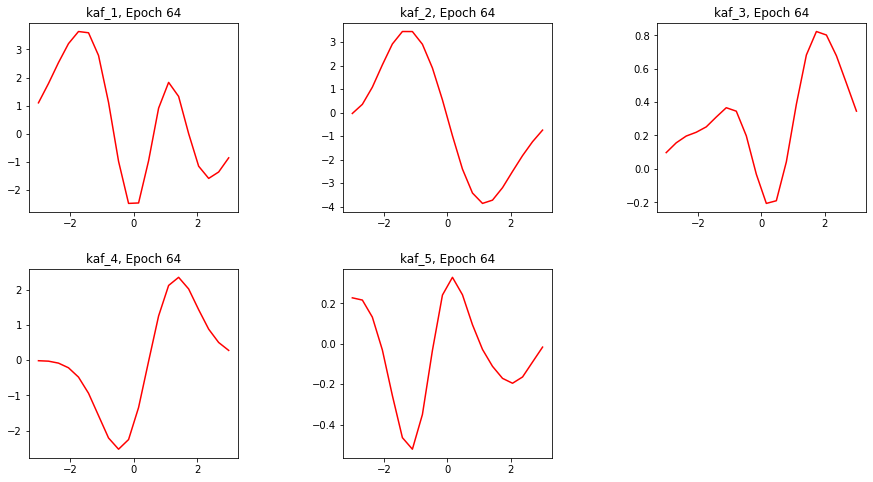

Epoch 64/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8843 - accuracy: 0.8227 - val_loss: 1.4381 - val_accuracy: 0.6636


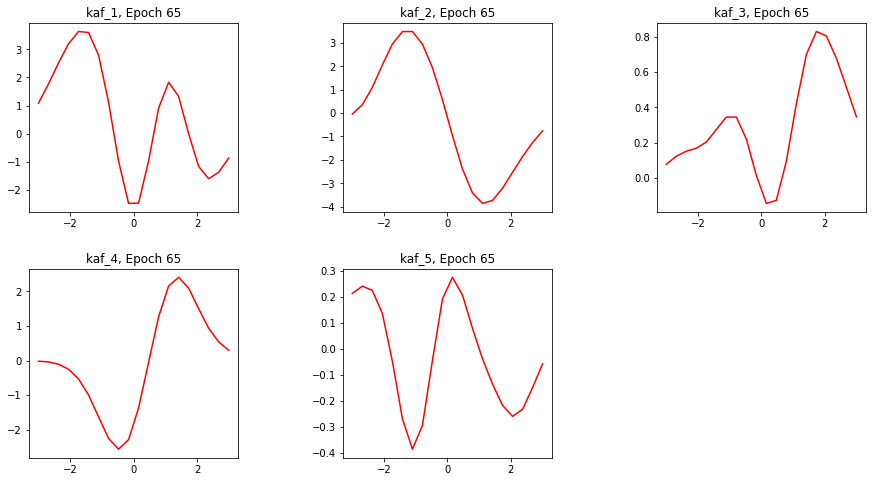

Epoch 65/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8856 - accuracy: 0.8229 - val_loss: 1.6456 - val_accuracy: 0.6243


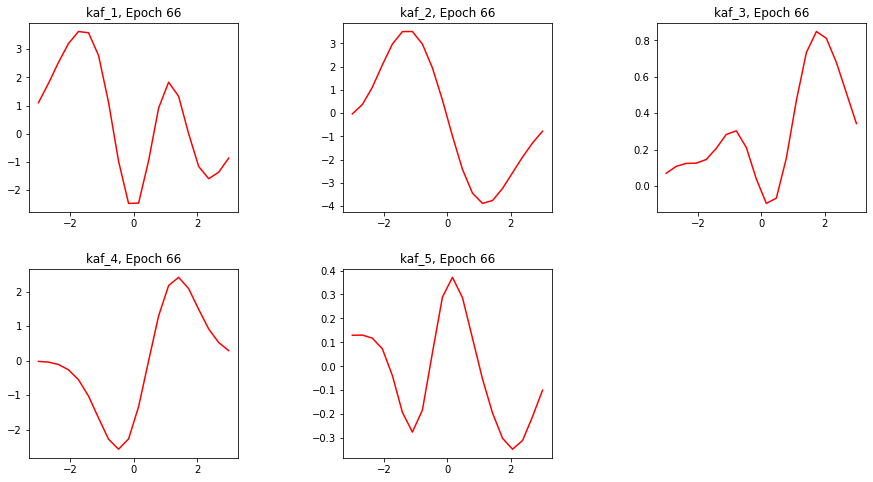

Epoch 66/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8845 - accuracy: 0.8255 - val_loss: 1.4320 - val_accuracy: 0.6484


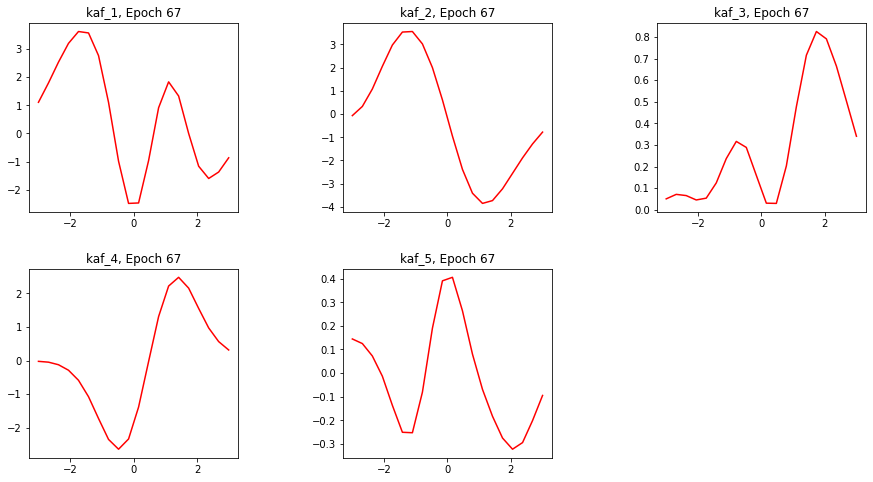

Epoch 67/150
391/391 [==============================] - 78s 201ms/step - loss: 0.8828 - accuracy: 0.8262 - val_loss: 1.2278 - val_accuracy: 0.7214


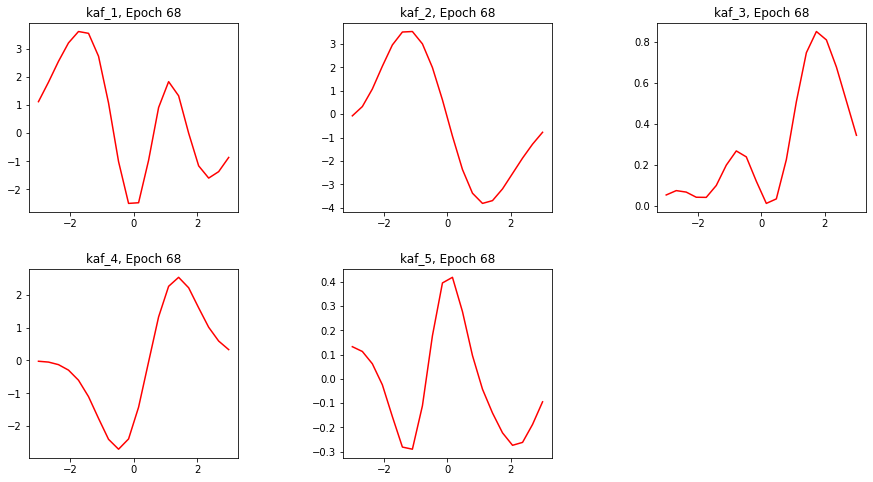

Epoch 68/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8779 - accuracy: 0.8258 - val_loss: 1.3156 - val_accuracy: 0.6912


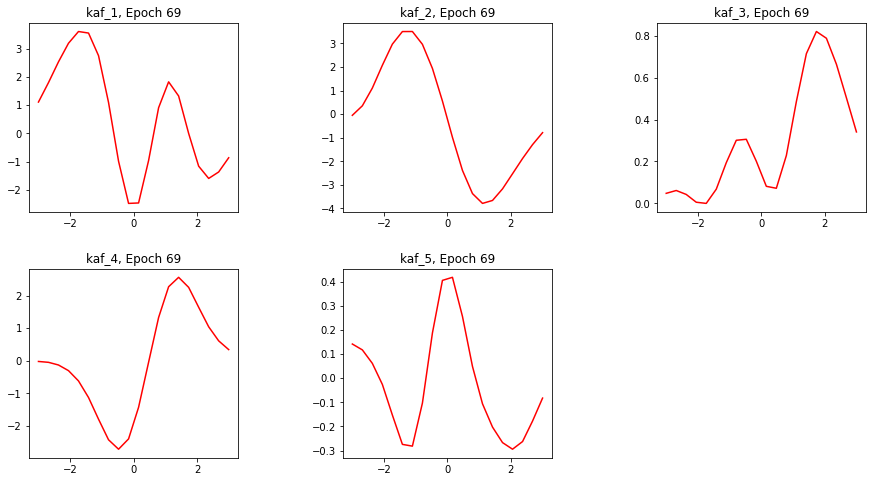

Epoch 69/150
391/391 [==============================] - 78s 201ms/step - loss: 0.8818 - accuracy: 0.8259 - val_loss: 1.0630 - val_accuracy: 0.7682


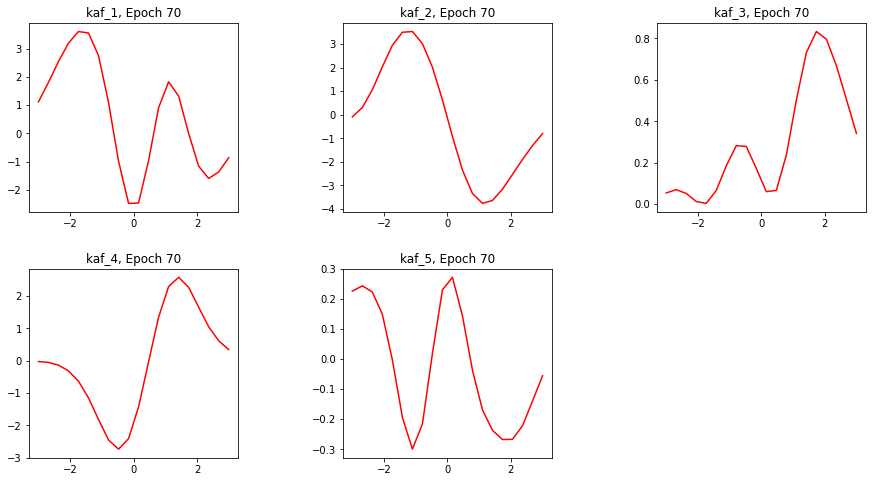

Epoch 70/150
391/391 [==============================] - 78s 201ms/step - loss: 0.8778 - accuracy: 0.8266 - val_loss: 1.2654 - val_accuracy: 0.7177


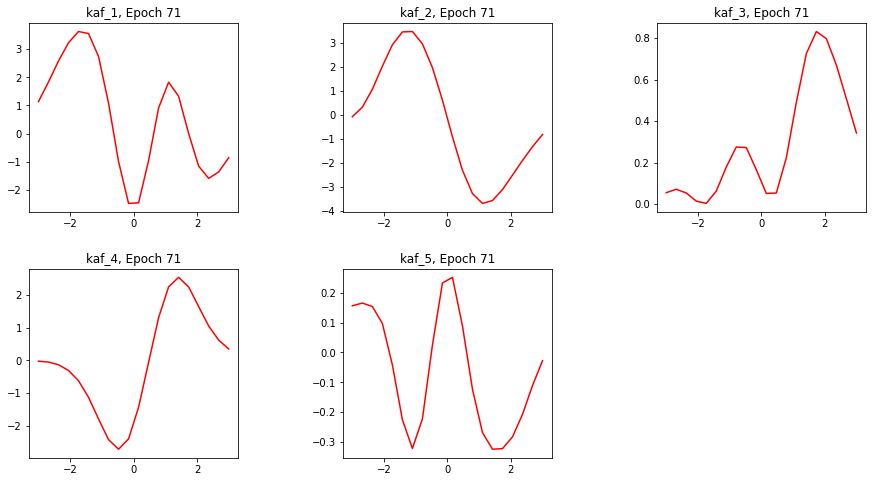

Epoch 71/150
391/391 [==============================] - 78s 201ms/step - loss: 0.8813 - accuracy: 0.8251 - val_loss: 1.5815 - val_accuracy: 0.6417


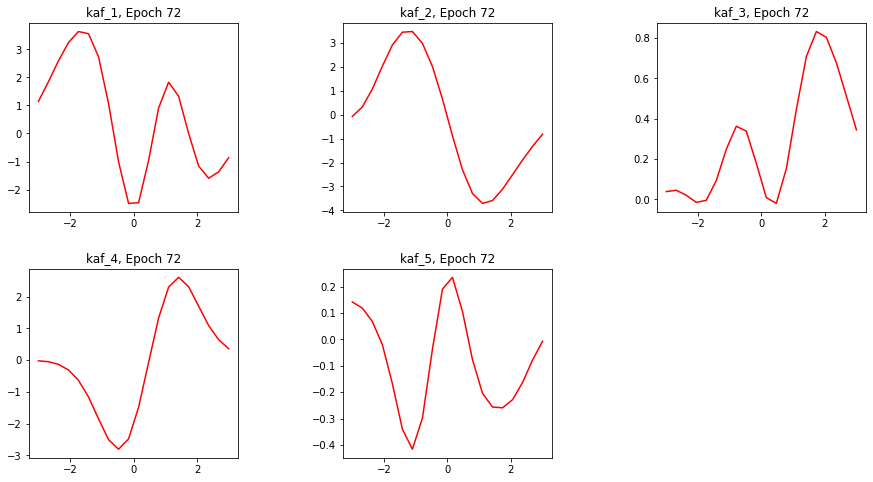

Epoch 72/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8736 - accuracy: 0.8291 - val_loss: 1.5078 - val_accuracy: 0.6448


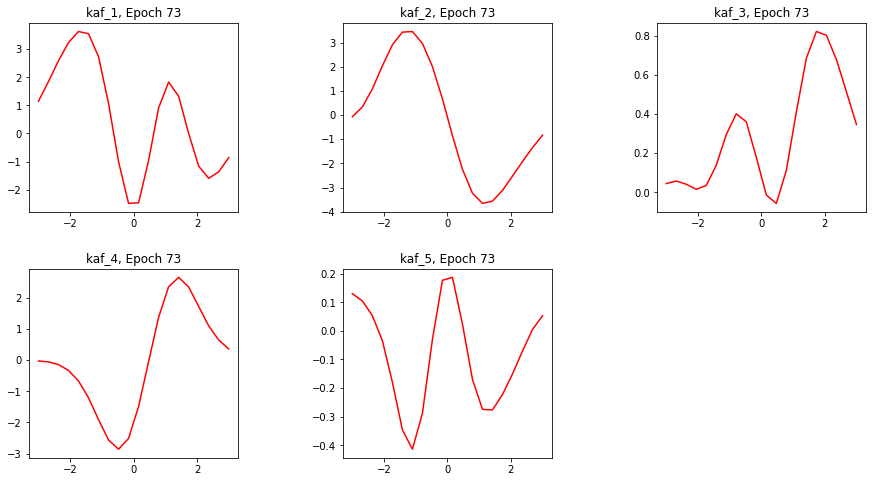

Epoch 73/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8799 - accuracy: 0.8259 - val_loss: 1.2872 - val_accuracy: 0.7142


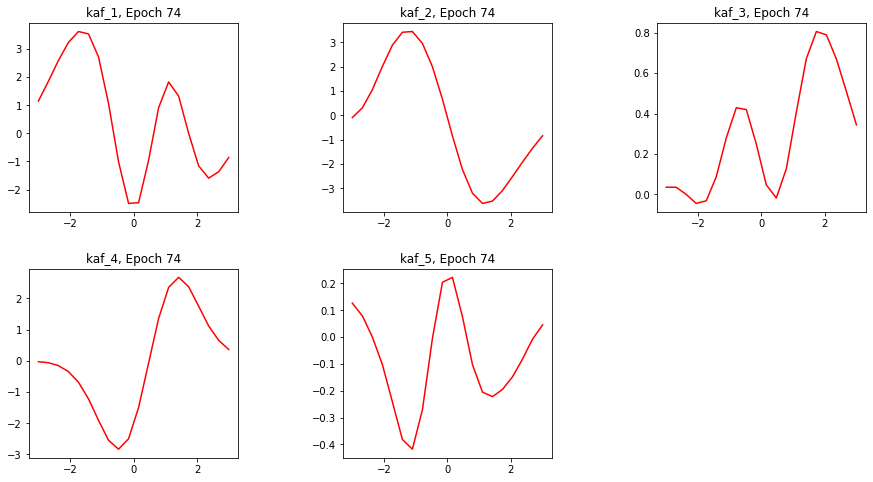

Epoch 74/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8865 - accuracy: 0.8241 - val_loss: 1.6229 - val_accuracy: 0.6347


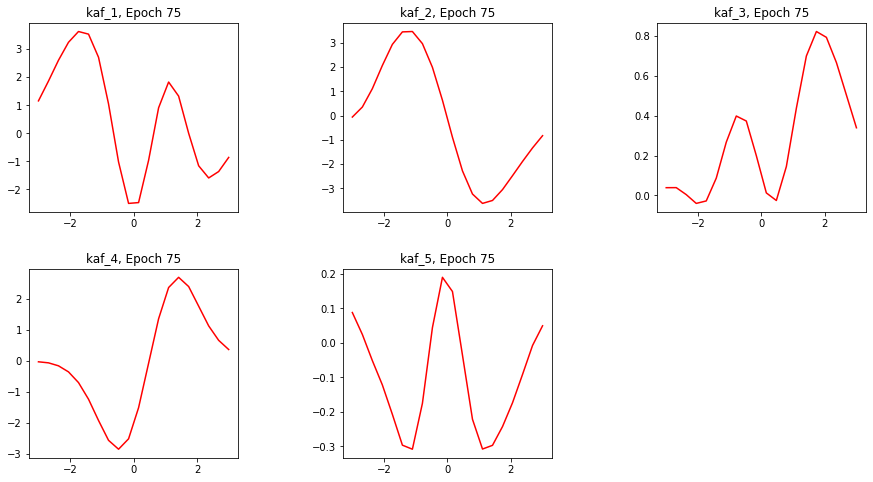

Epoch 75/150
391/391 [==============================] - 78s 201ms/step - loss: 0.8761 - accuracy: 0.8276 - val_loss: 1.2947 - val_accuracy: 0.6977


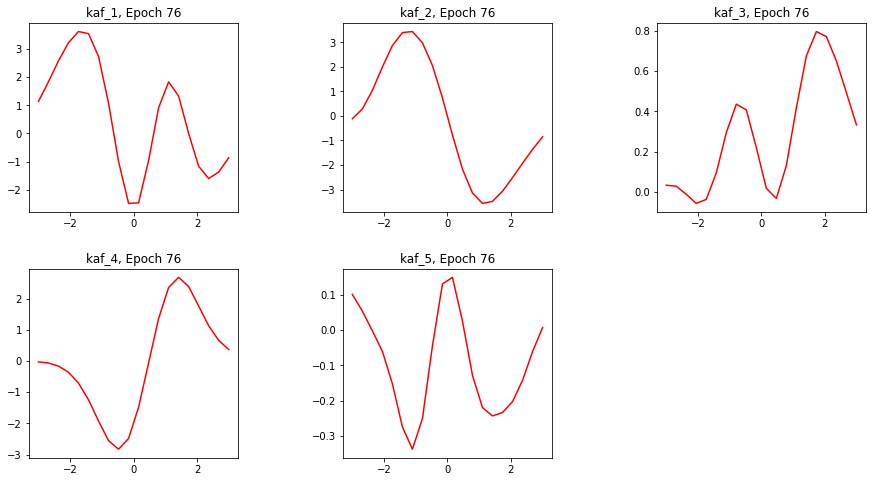

Epoch 76/150
391/391 [==============================] - 78s 201ms/step - loss: 0.8769 - accuracy: 0.8284 - val_loss: 1.2951 - val_accuracy: 0.7187


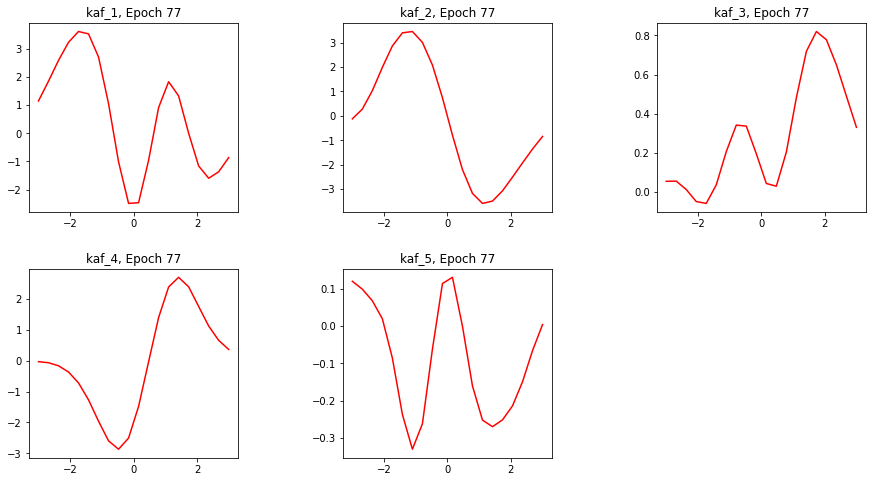

Epoch 77/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8786 - accuracy: 0.8267 - val_loss: 1.7139 - val_accuracy: 0.6036


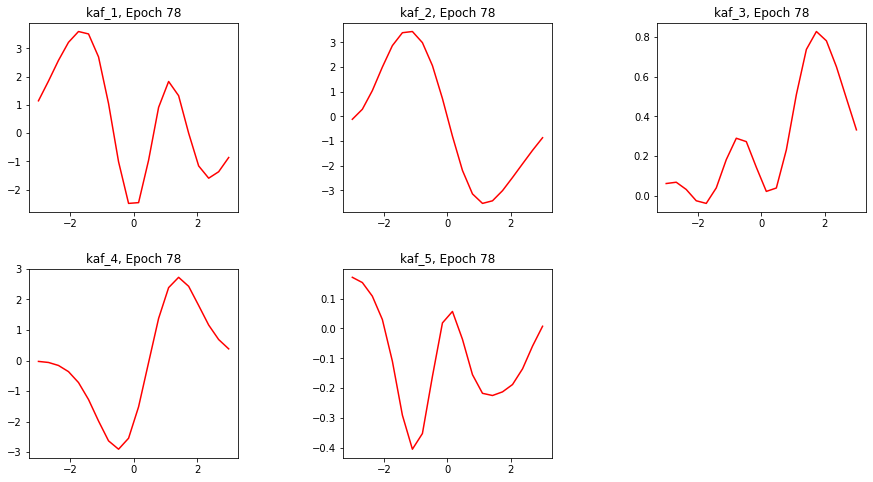

Epoch 78/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8752 - accuracy: 0.8264 - val_loss: 1.3070 - val_accuracy: 0.7007


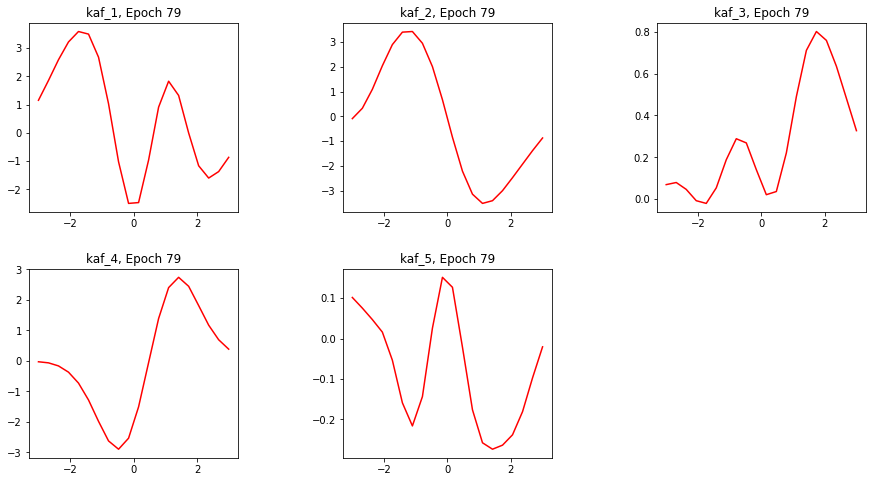

Epoch 79/150
391/391 [==============================] - 78s 201ms/step - loss: 0.8731 - accuracy: 0.8308 - val_loss: 1.3724 - val_accuracy: 0.6943


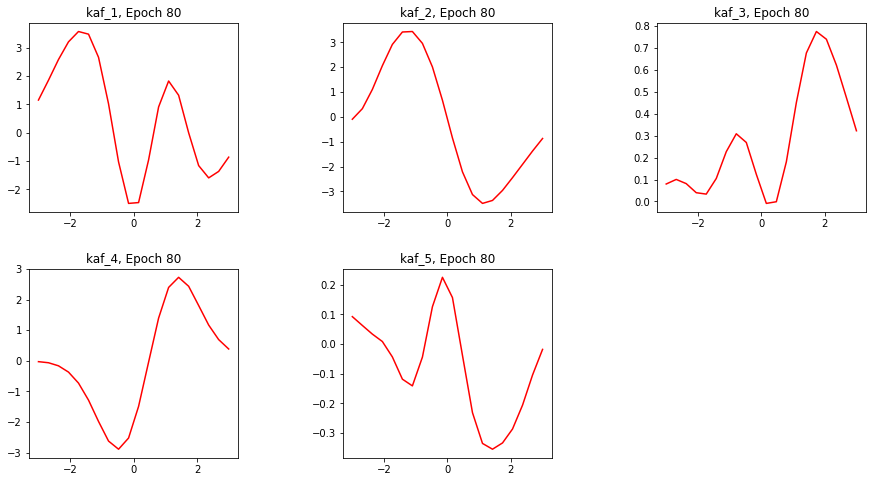

Epoch 80/150
391/391 [==============================] - 78s 200ms/step - loss: 0.8785 - accuracy: 0.8255 - val_loss: 1.5019 - val_accuracy: 0.6375


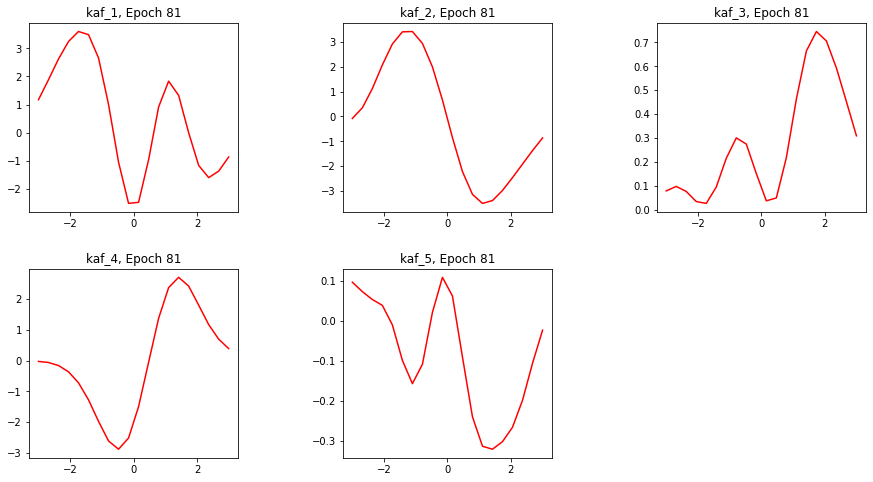

Epoch 81/150
391/391 [==============================] - 78s 201ms/step - loss: 0.7449 - accuracy: 0.8701 - val_loss: 0.7437 - val_accuracy: 0.8657


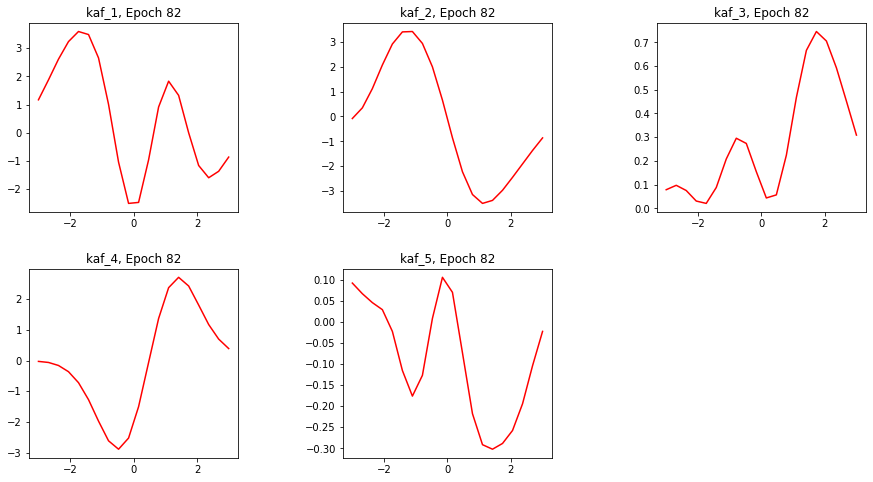

Epoch 82/150
391/391 [==============================] - 78s 200ms/step - loss: 0.6383 - accuracy: 0.8993 - val_loss: 0.7078 - val_accuracy: 0.8733


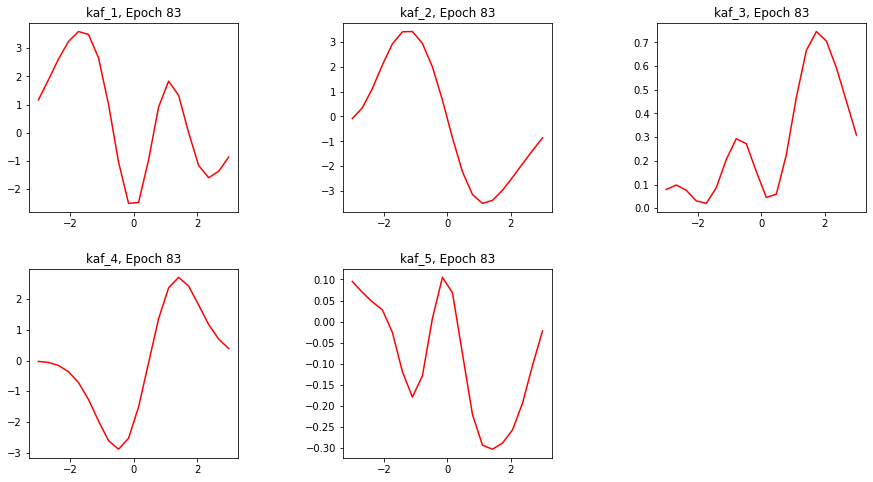

Epoch 83/150
391/391 [==============================] - 78s 200ms/step - loss: 0.5870 - accuracy: 0.9090 - val_loss: 0.6968 - val_accuracy: 0.8677


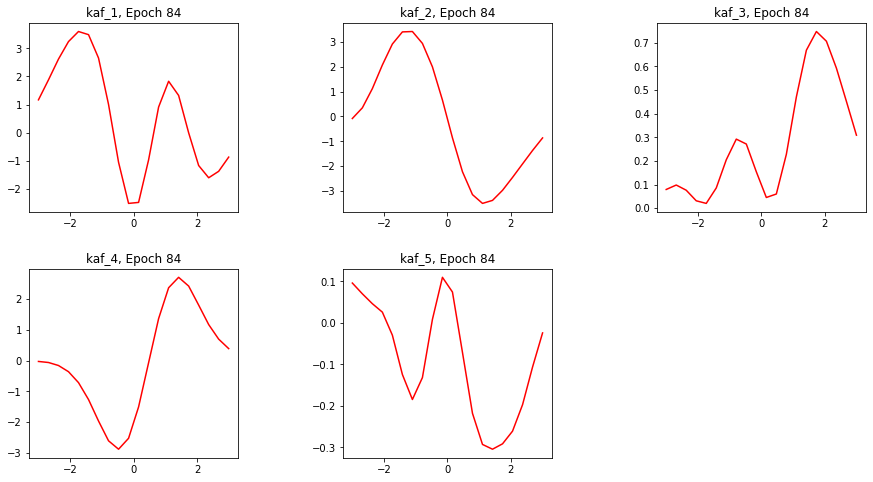

Epoch 84/150
391/391 [==============================] - 78s 200ms/step - loss: 0.5504 - accuracy: 0.9147 - val_loss: 0.6487 - val_accuracy: 0.8827


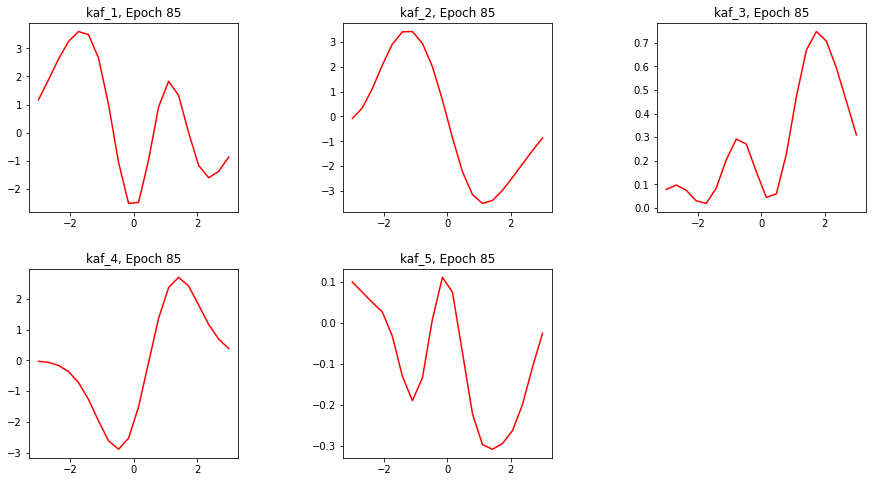

Epoch 85/150
391/391 [==============================] - 78s 200ms/step - loss: 0.5150 - accuracy: 0.9217 - val_loss: 0.6613 - val_accuracy: 0.8747


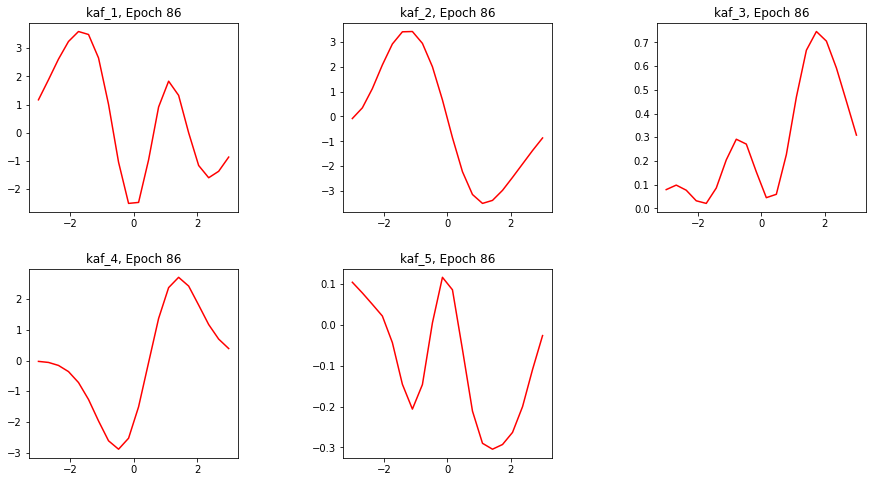

Epoch 86/150
391/391 [==============================] - 78s 200ms/step - loss: 0.4877 - accuracy: 0.9239 - val_loss: 0.6260 - val_accuracy: 0.8810


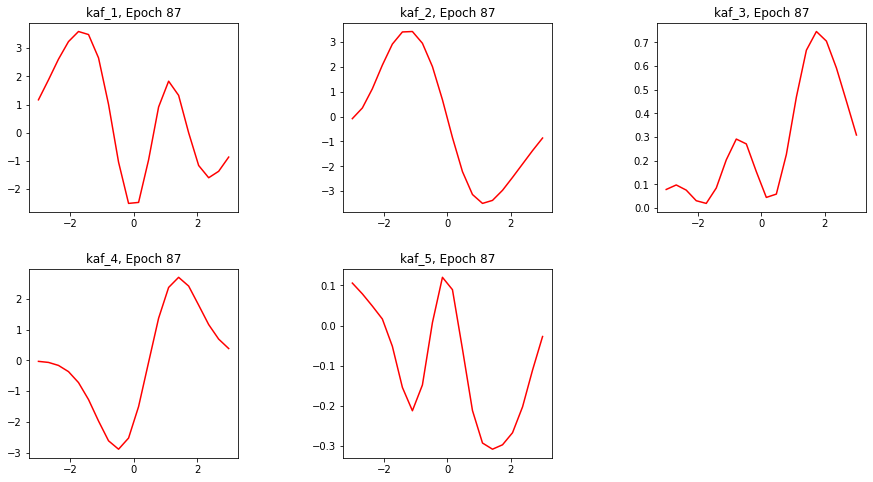

Epoch 87/150
391/391 [==============================] - 78s 200ms/step - loss: 0.4626 - accuracy: 0.9269 - val_loss: 0.6277 - val_accuracy: 0.8750


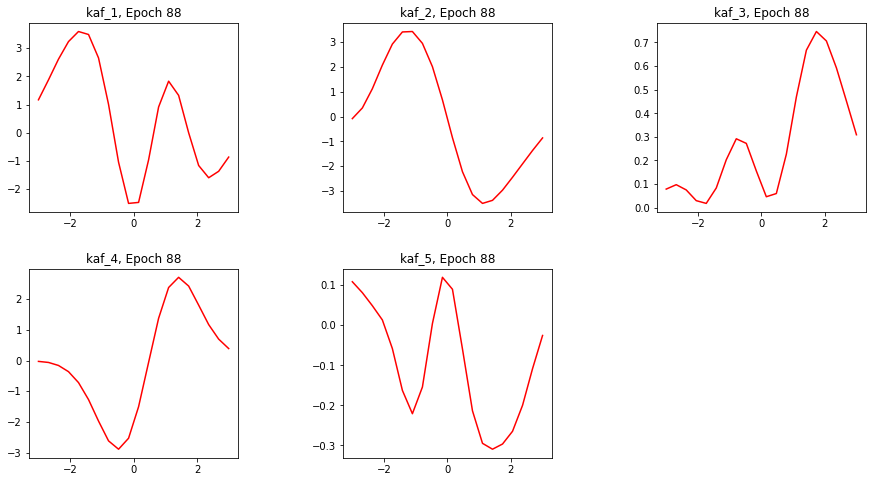

Epoch 88/150
391/391 [==============================] - 78s 200ms/step - loss: 0.4426 - accuracy: 0.9300 - val_loss: 0.5948 - val_accuracy: 0.8816


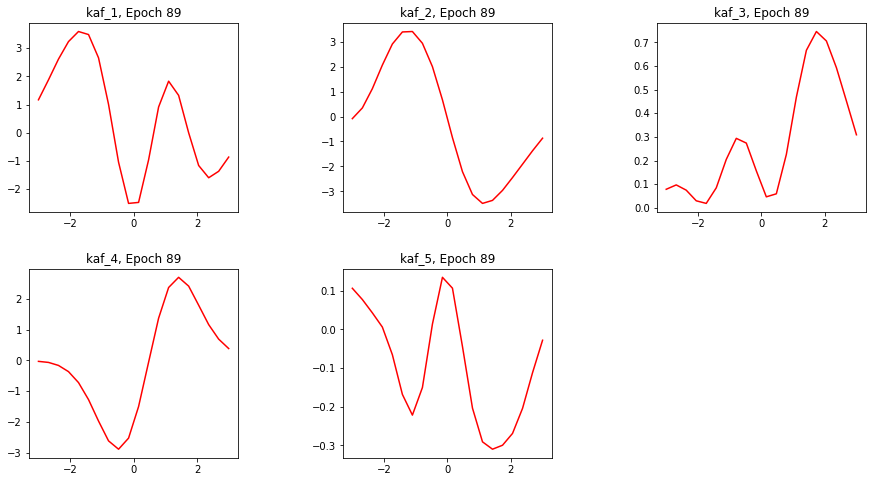

Epoch 89/150
391/391 [==============================] - 78s 200ms/step - loss: 0.4232 - accuracy: 0.9329 - val_loss: 0.5925 - val_accuracy: 0.8789


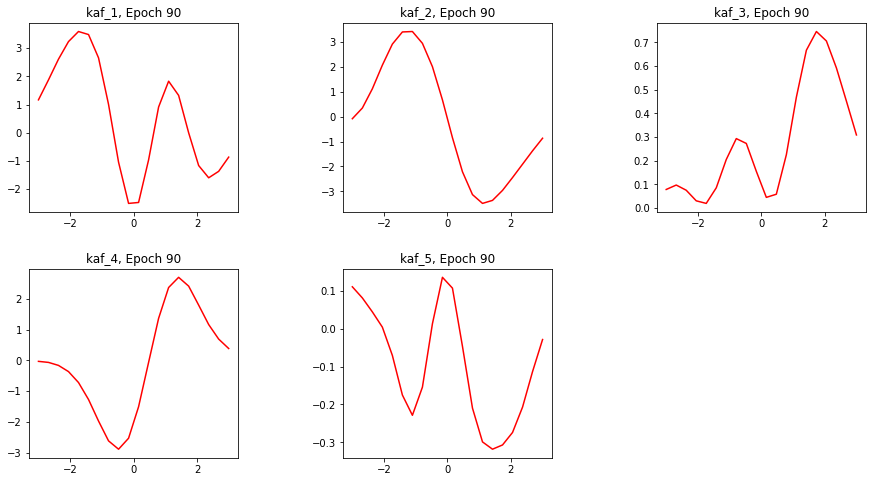

Epoch 90/150
391/391 [==============================] - 78s 200ms/step - loss: 0.4074 - accuracy: 0.9349 - val_loss: 0.5946 - val_accuracy: 0.8782


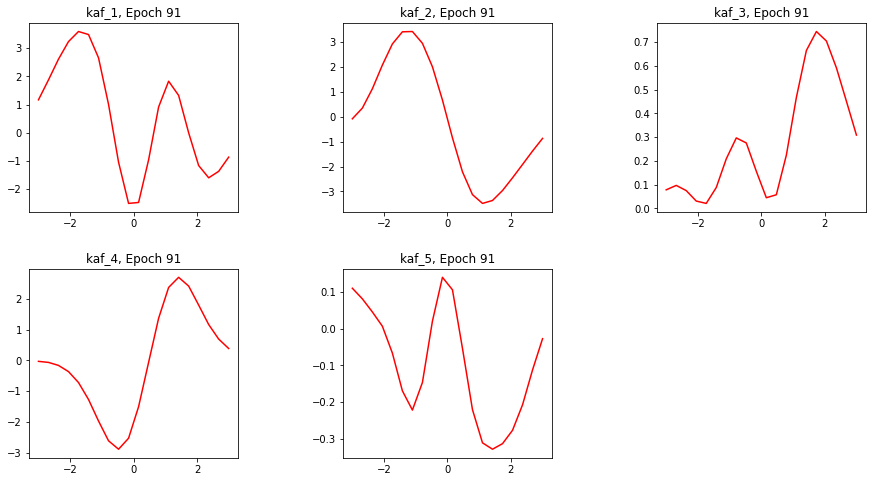

Epoch 91/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3939 - accuracy: 0.9357 - val_loss: 0.6390 - val_accuracy: 0.8621


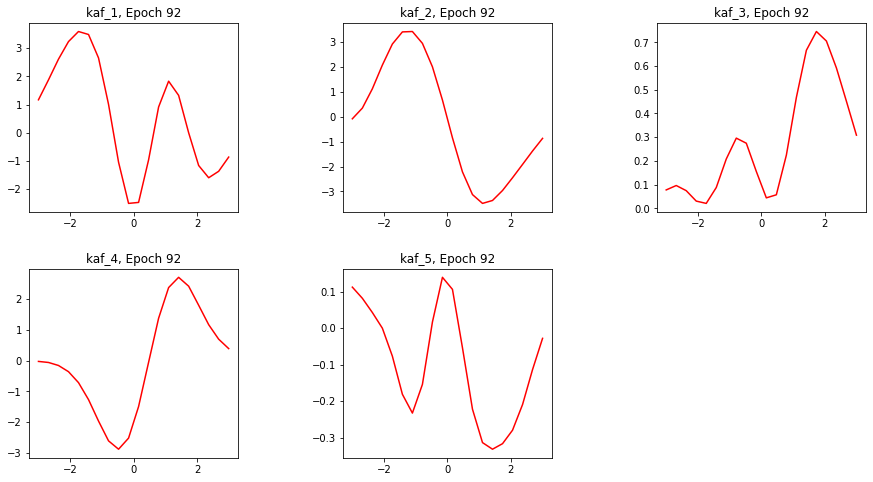

Epoch 92/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3819 - accuracy: 0.9375 - val_loss: 0.5991 - val_accuracy: 0.8784


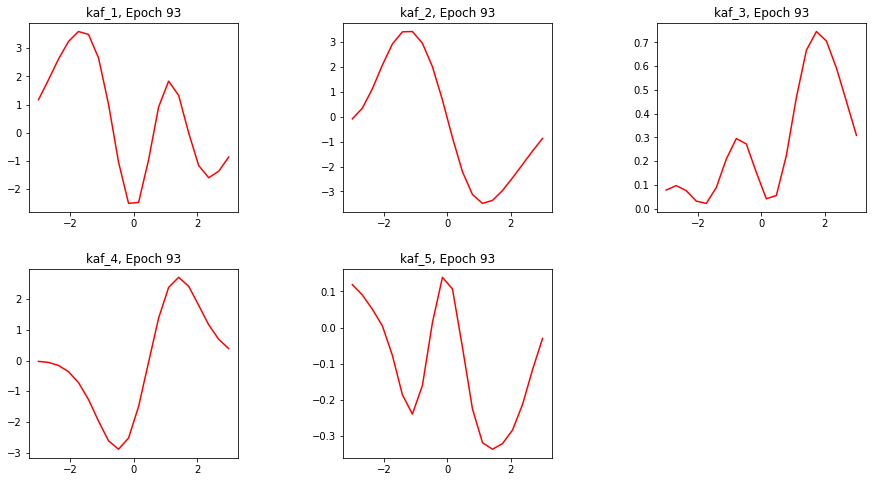

Epoch 93/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3730 - accuracy: 0.9376 - val_loss: 0.5908 - val_accuracy: 0.8761


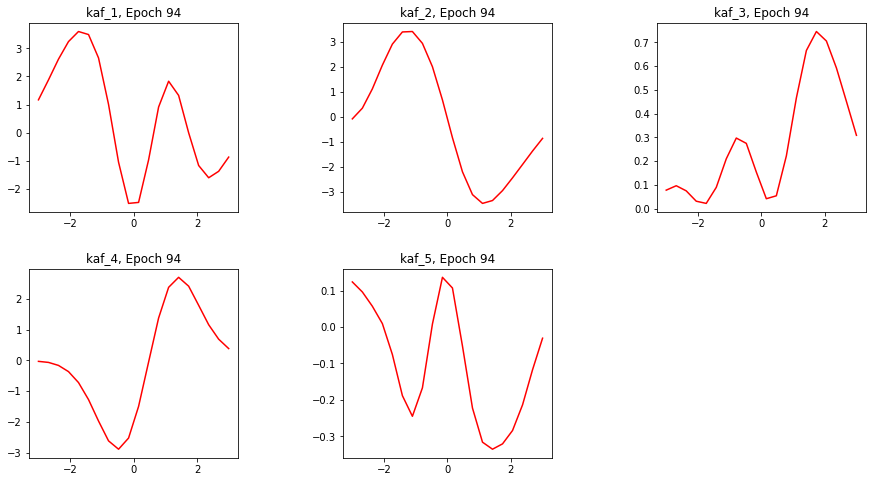

Epoch 94/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3629 - accuracy: 0.9388 - val_loss: 0.6585 - val_accuracy: 0.8564


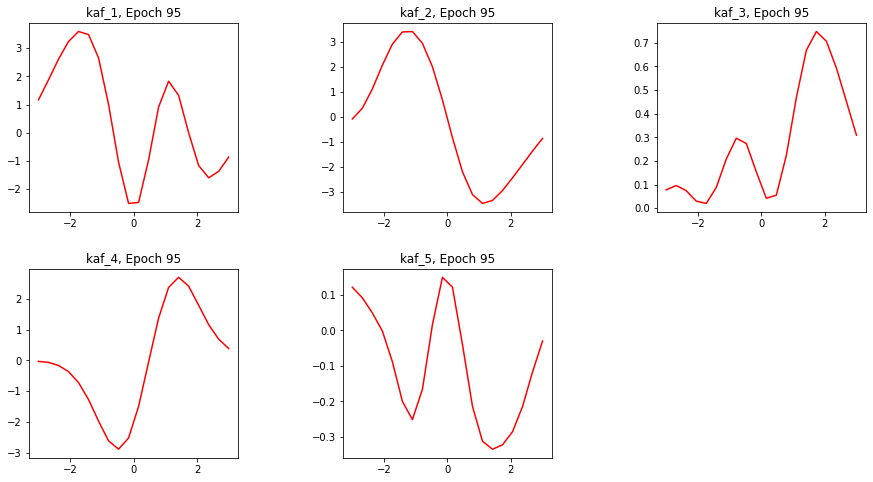

Epoch 95/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3557 - accuracy: 0.9407 - val_loss: 0.6132 - val_accuracy: 0.8673


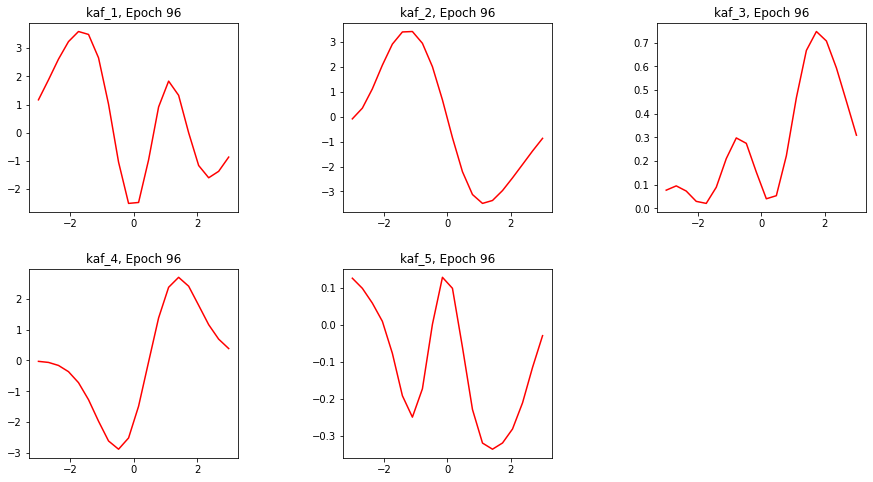

Epoch 96/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3514 - accuracy: 0.9396 - val_loss: 0.6135 - val_accuracy: 0.8635


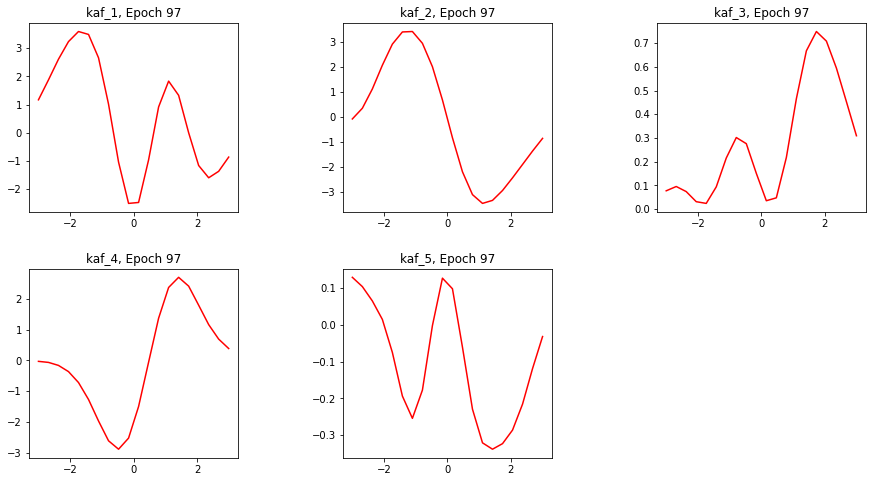

Epoch 97/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3453 - accuracy: 0.9403 - val_loss: 0.5937 - val_accuracy: 0.8749


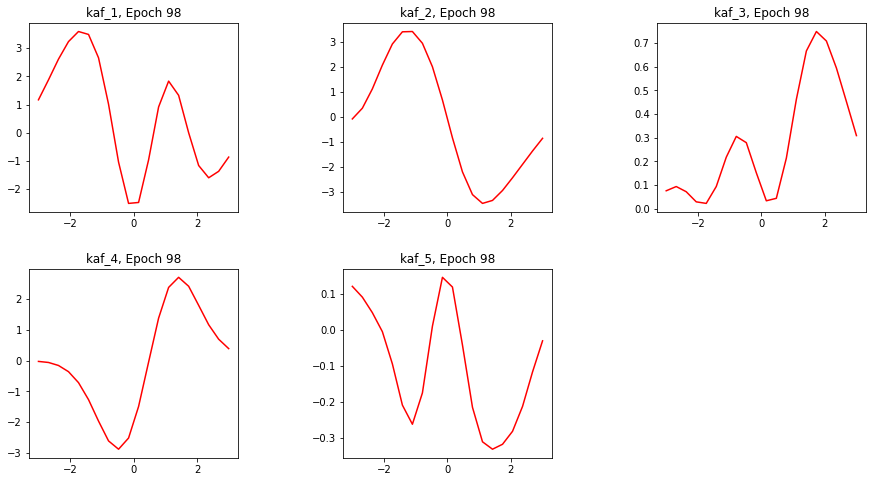

Epoch 98/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3427 - accuracy: 0.9410 - val_loss: 0.6080 - val_accuracy: 0.8650


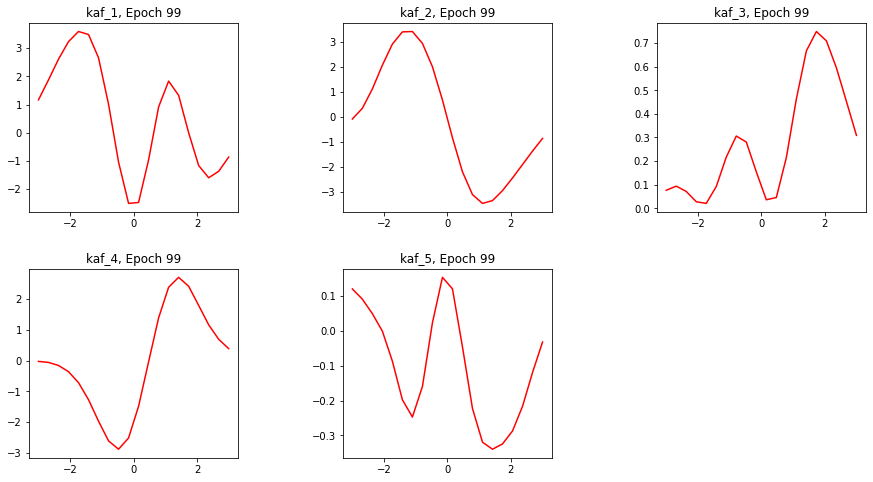

Epoch 99/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3398 - accuracy: 0.9404 - val_loss: 0.6540 - val_accuracy: 0.8574


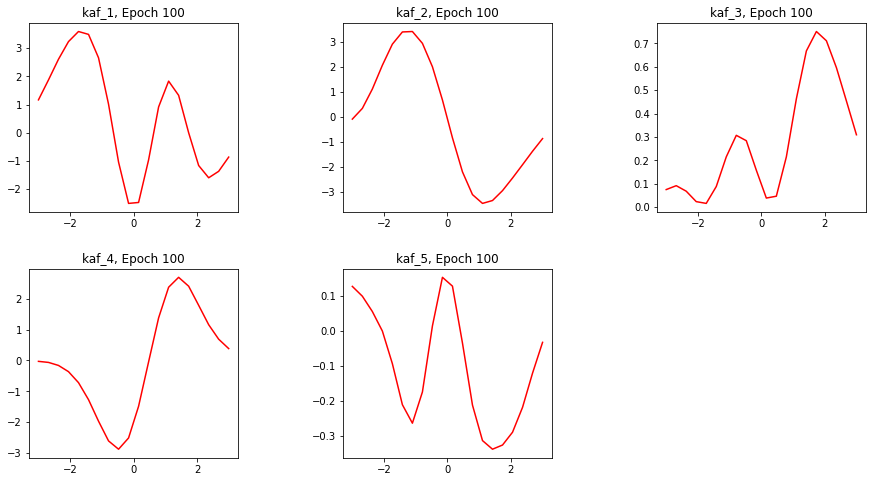

Epoch 100/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3348 - accuracy: 0.9422 - val_loss: 0.6899 - val_accuracy: 0.8488


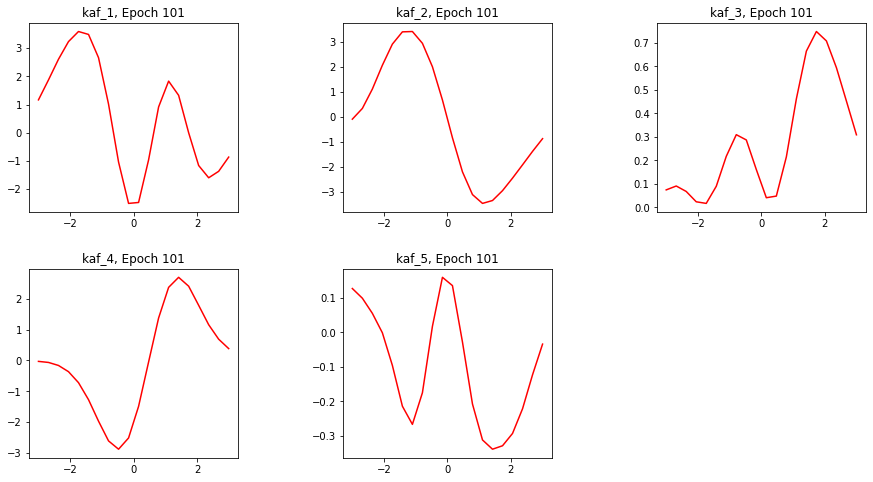

Epoch 101/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3304 - accuracy: 0.9426 - val_loss: 0.5807 - val_accuracy: 0.8752


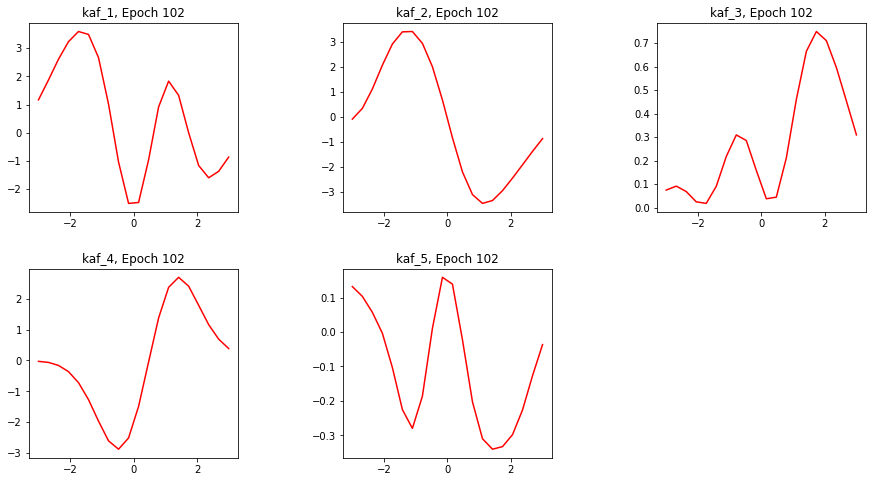

Epoch 102/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3277 - accuracy: 0.9428 - val_loss: 0.6222 - val_accuracy: 0.8618


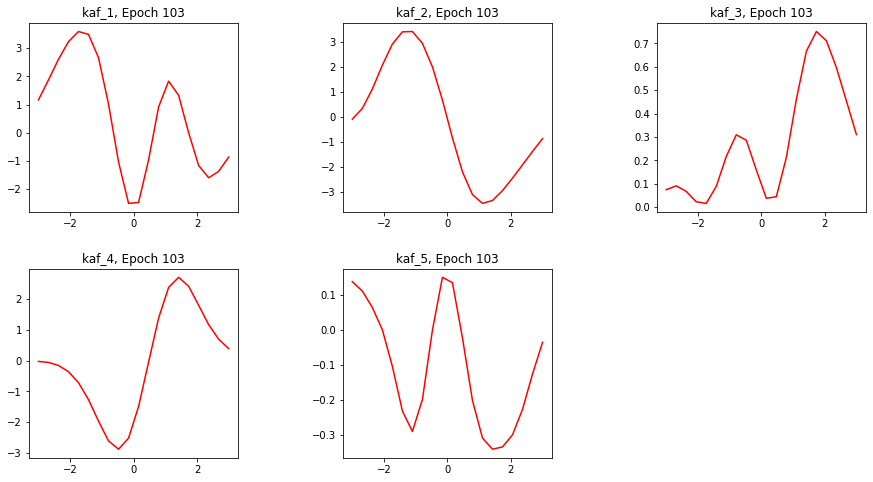

Epoch 103/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3272 - accuracy: 0.9426 - val_loss: 0.6222 - val_accuracy: 0.8629


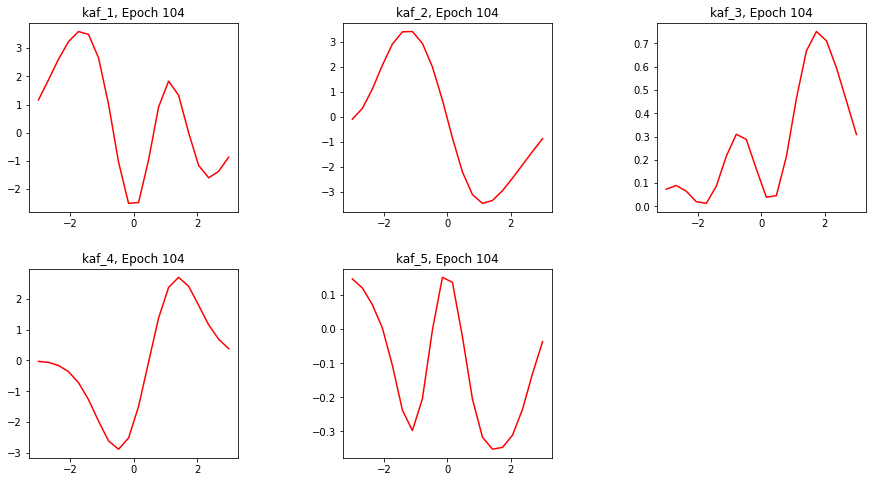

Epoch 104/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3232 - accuracy: 0.9441 - val_loss: 0.6128 - val_accuracy: 0.8688


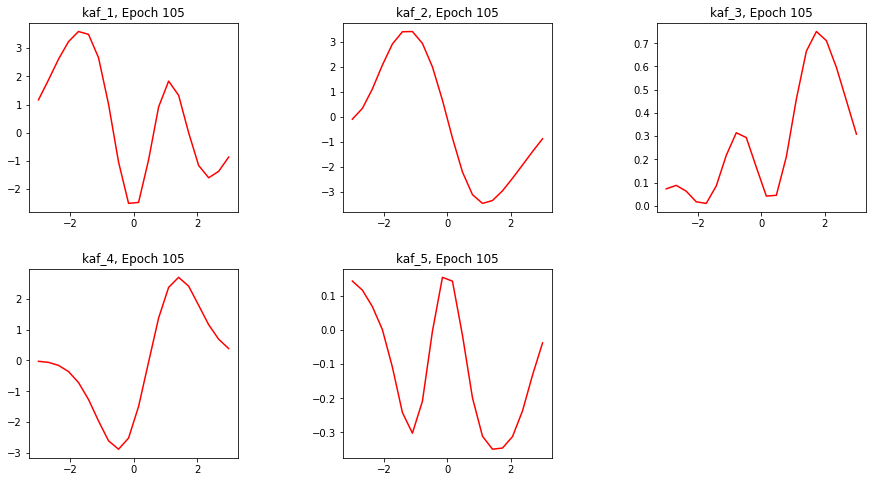

Epoch 105/150
391/391 [==============================] - 78s 199ms/step - loss: 0.3232 - accuracy: 0.9436 - val_loss: 0.6085 - val_accuracy: 0.8677


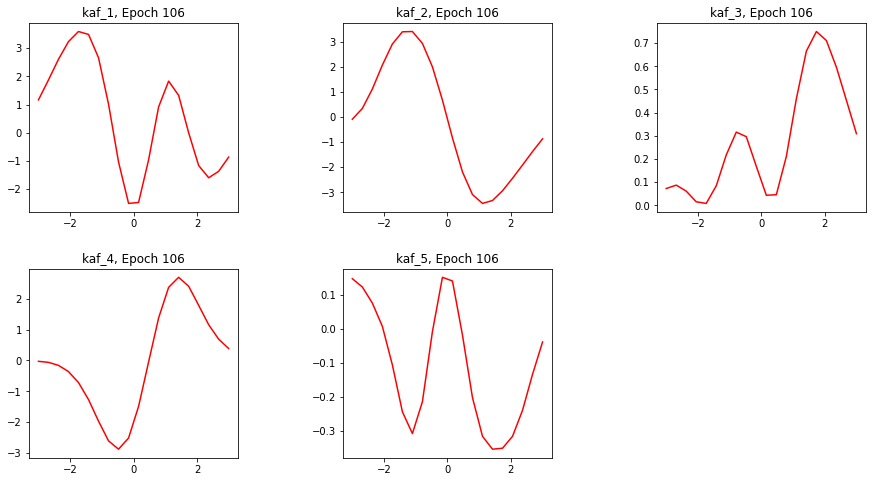

Epoch 106/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3222 - accuracy: 0.9426 - val_loss: 0.6252 - val_accuracy: 0.8600


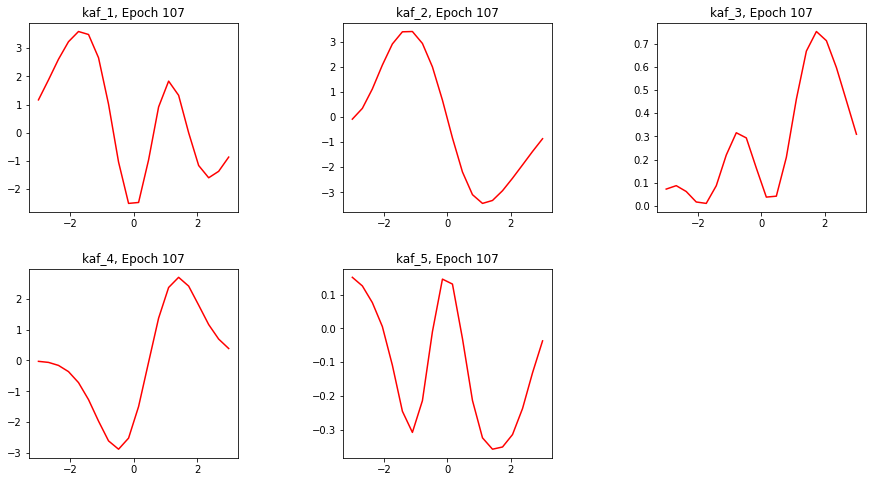

Epoch 107/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3219 - accuracy: 0.9435 - val_loss: 0.8175 - val_accuracy: 0.8277


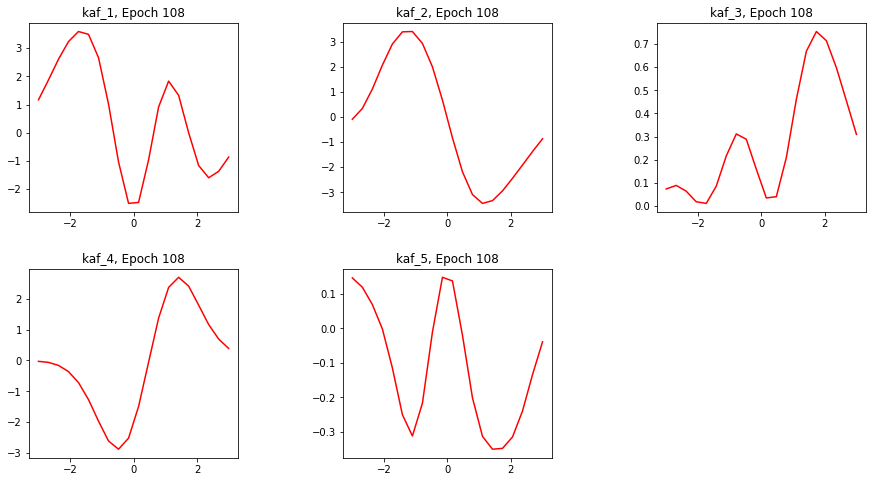

Epoch 108/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3189 - accuracy: 0.9445 - val_loss: 0.6178 - val_accuracy: 0.8609


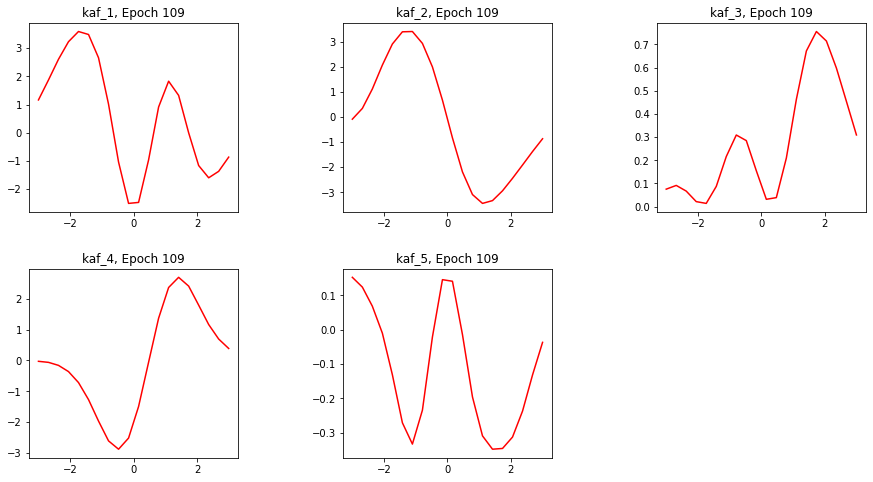

Epoch 109/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3171 - accuracy: 0.9452 - val_loss: 0.5980 - val_accuracy: 0.8665


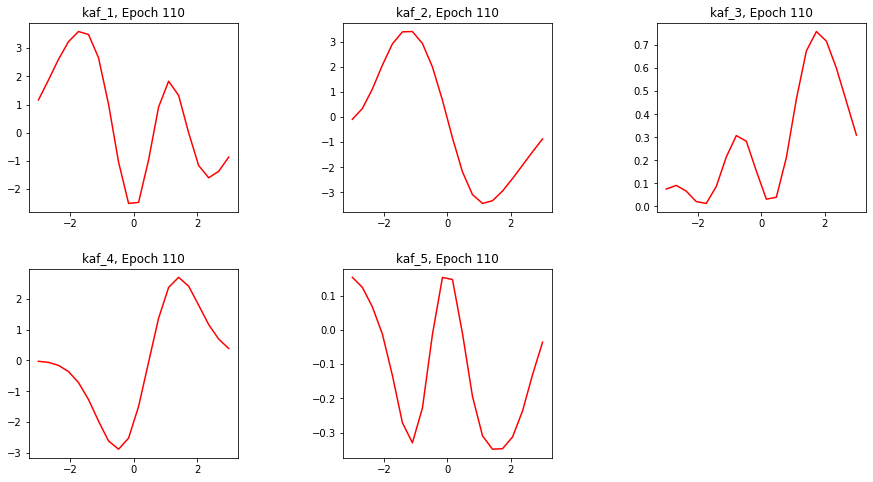

Epoch 110/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3186 - accuracy: 0.9435 - val_loss: 0.5998 - val_accuracy: 0.8688


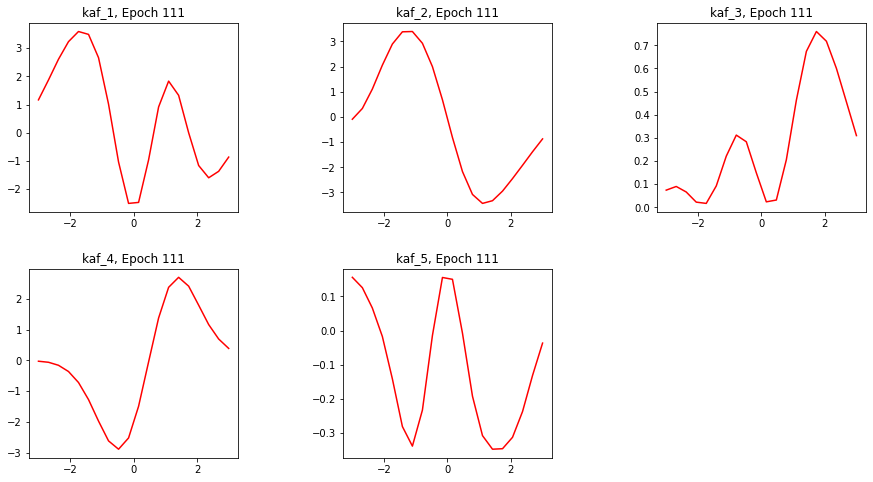

Epoch 111/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3185 - accuracy: 0.9435 - val_loss: 0.6226 - val_accuracy: 0.8680


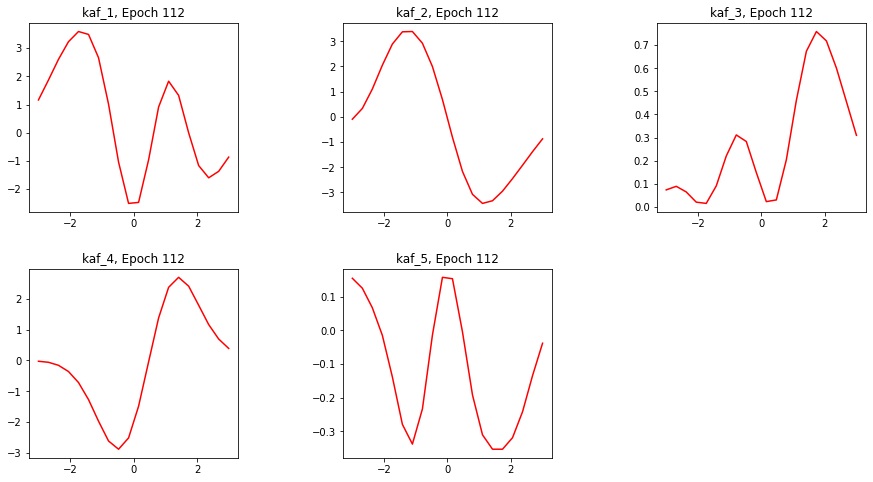

Epoch 112/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3149 - accuracy: 0.9453 - val_loss: 0.6669 - val_accuracy: 0.8544


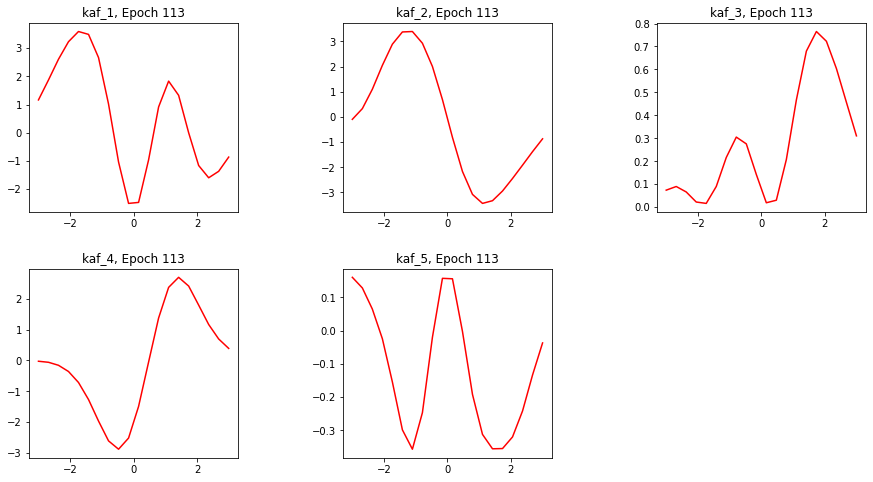

Epoch 113/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3160 - accuracy: 0.9451 - val_loss: 0.7082 - val_accuracy: 0.8422


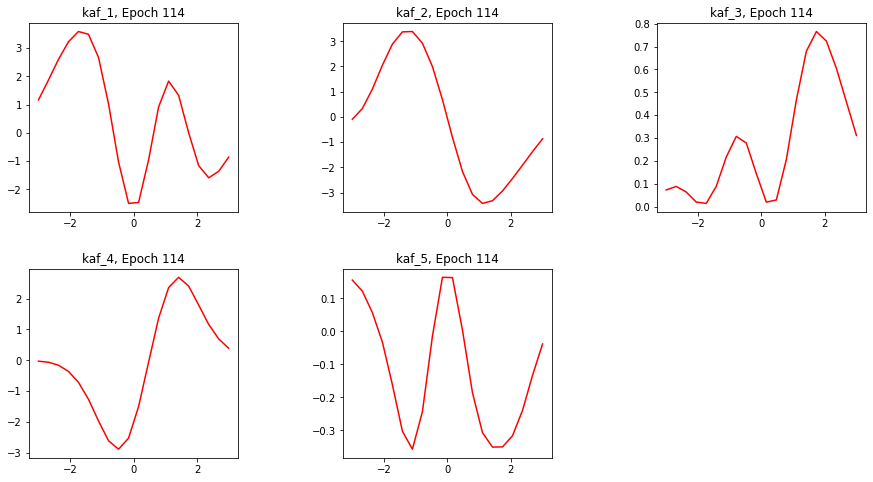

Epoch 114/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3149 - accuracy: 0.9459 - val_loss: 0.5756 - val_accuracy: 0.8778


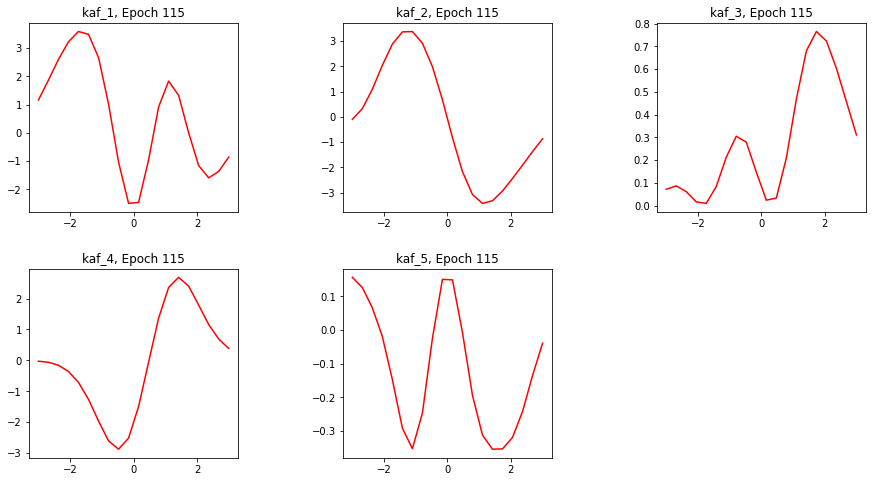

Epoch 115/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3154 - accuracy: 0.9454 - val_loss: 0.6423 - val_accuracy: 0.8568


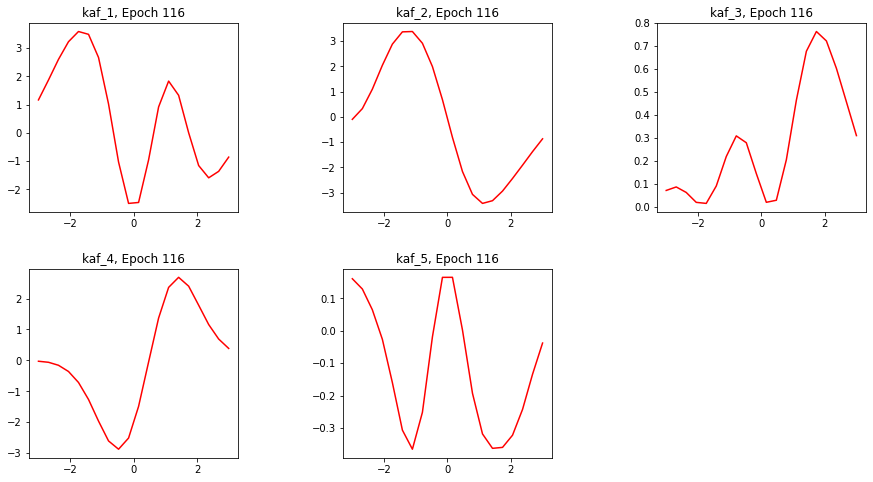

Epoch 116/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3118 - accuracy: 0.9459 - val_loss: 0.5979 - val_accuracy: 0.8706


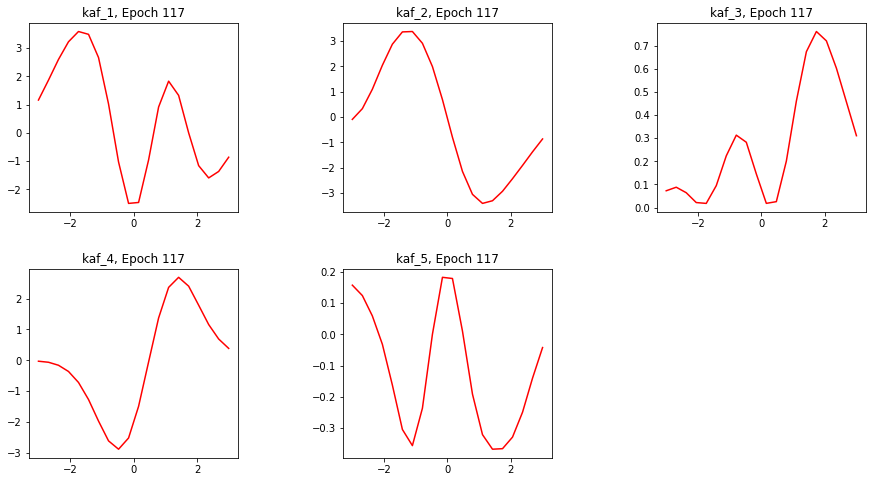

Epoch 117/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3092 - accuracy: 0.9475 - val_loss: 0.6324 - val_accuracy: 0.8607


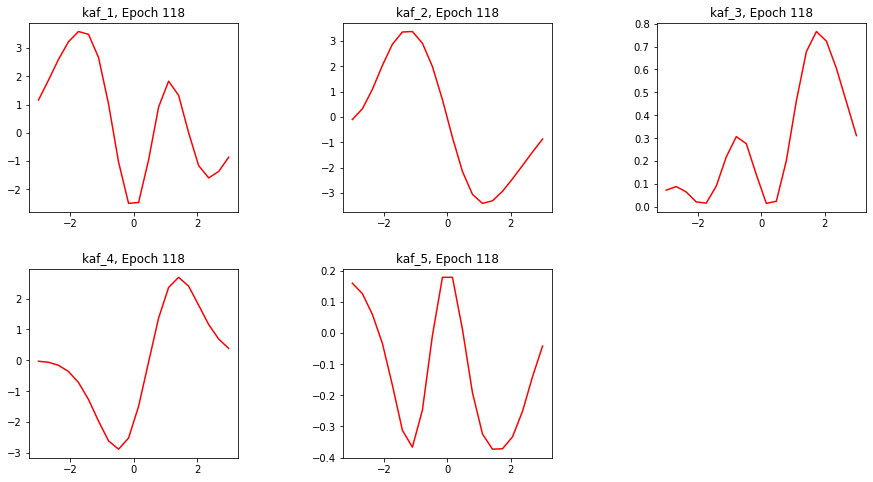

Epoch 118/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3127 - accuracy: 0.9465 - val_loss: 0.6477 - val_accuracy: 0.8568


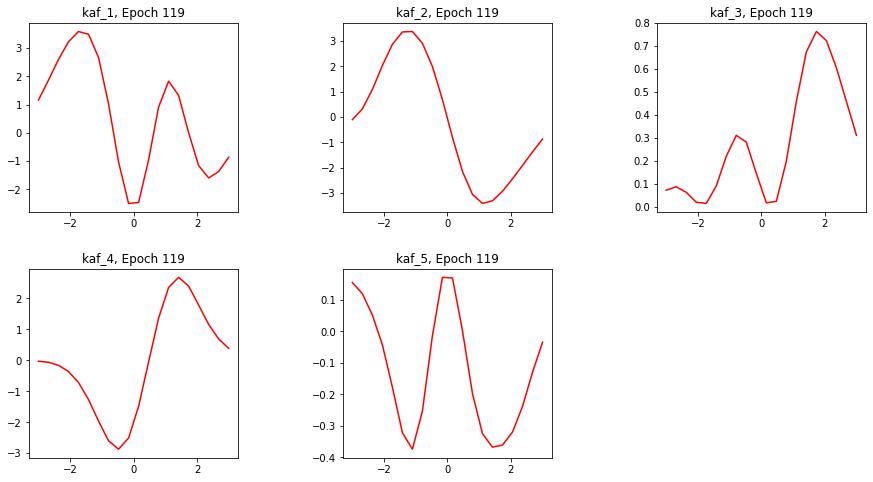

Epoch 119/150
391/391 [==============================] - 78s 200ms/step - loss: 0.3141 - accuracy: 0.9467 - val_loss: 0.5907 - val_accuracy: 0.8749


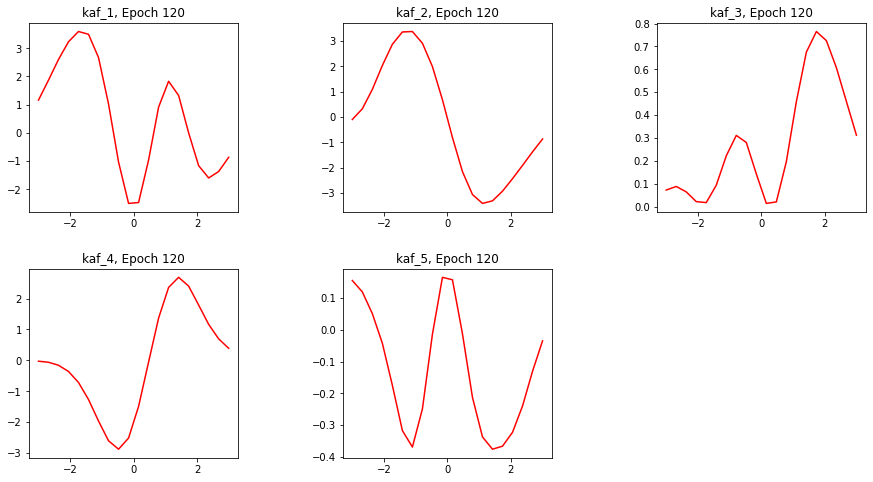

Epoch 120/150
391/391 [==============================] - 78s 199ms/step - loss: 0.3055 - accuracy: 0.9492 - val_loss: 0.6497 - val_accuracy: 0.8547


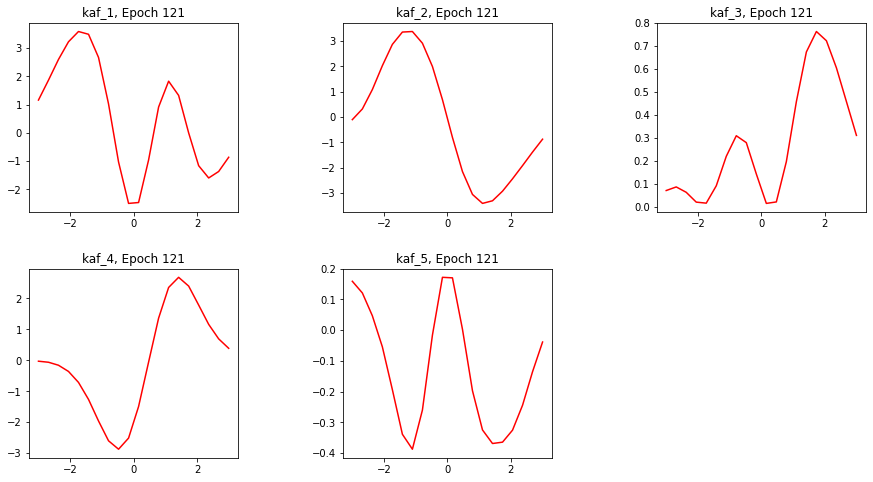

Epoch 121/150
391/391 [==============================] - 79s 201ms/step - loss: 0.2714 - accuracy: 0.9635 - val_loss: 0.5154 - val_accuracy: 0.8952


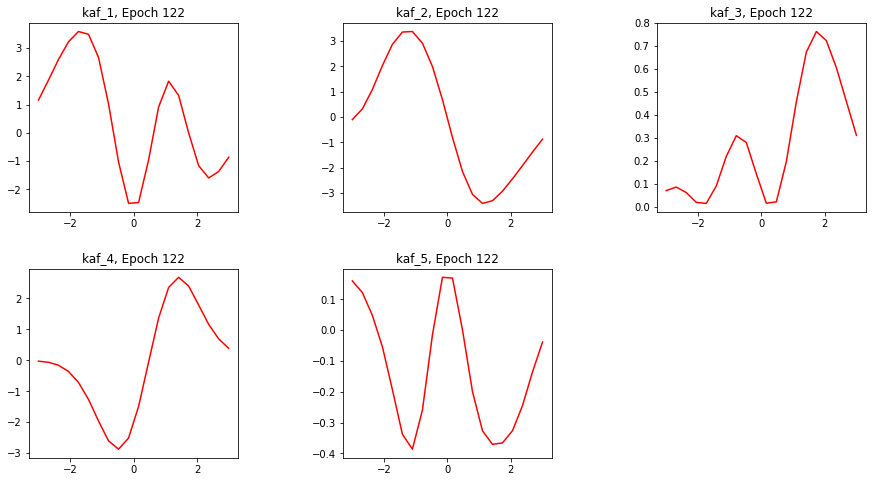

Epoch 122/150
391/391 [==============================] - 78s 200ms/step - loss: 0.2489 - accuracy: 0.9718 - val_loss: 0.5088 - val_accuracy: 0.8962


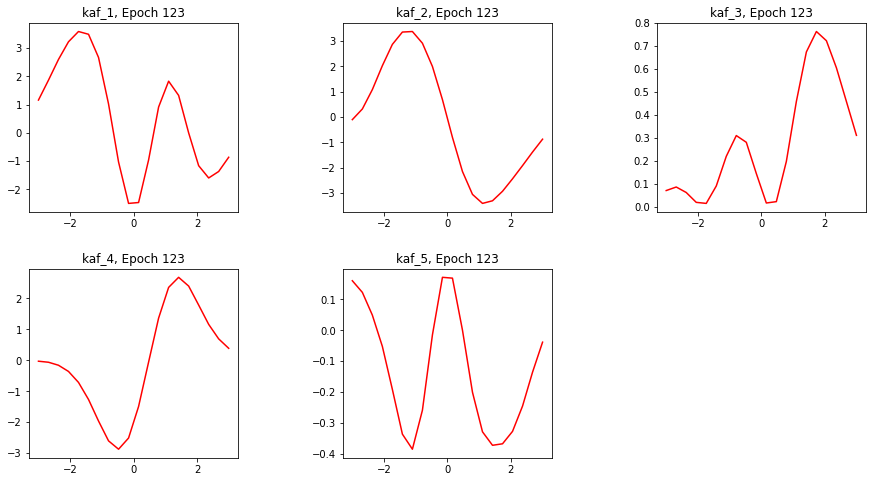

Epoch 123/150
391/391 [==============================] - 78s 201ms/step - loss: 0.2386 - accuracy: 0.9748 - val_loss: 0.5120 - val_accuracy: 0.8954


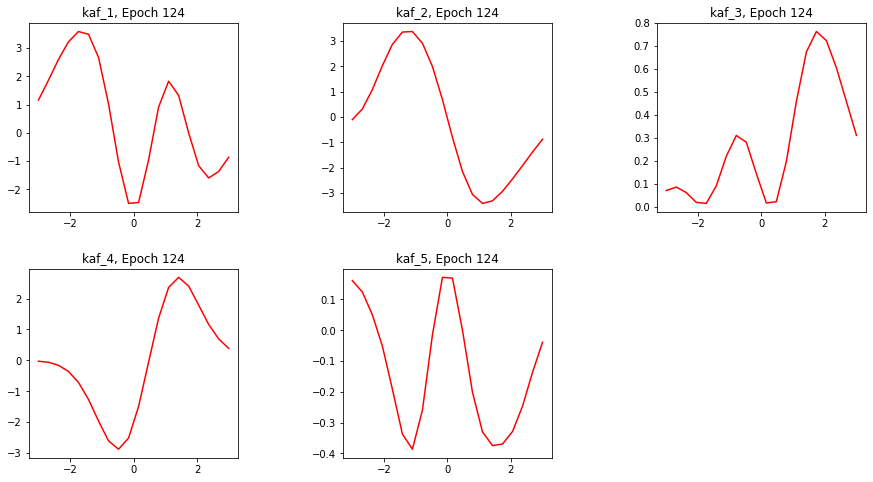

Epoch 124/150
391/391 [==============================] - 78s 201ms/step - loss: 0.2324 - accuracy: 0.9768 - val_loss: 0.5074 - val_accuracy: 0.8973


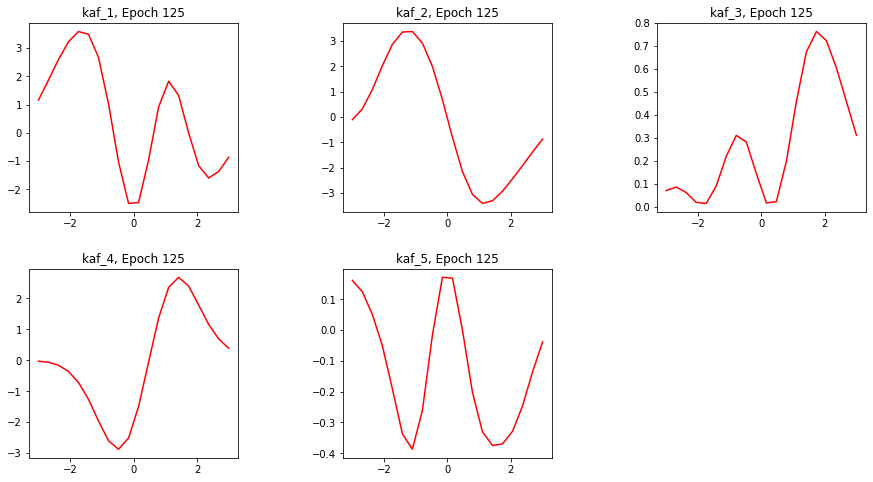

Epoch 125/150
391/391 [==============================] - 78s 200ms/step - loss: 0.2281 - accuracy: 0.9785 - val_loss: 0.5117 - val_accuracy: 0.8980


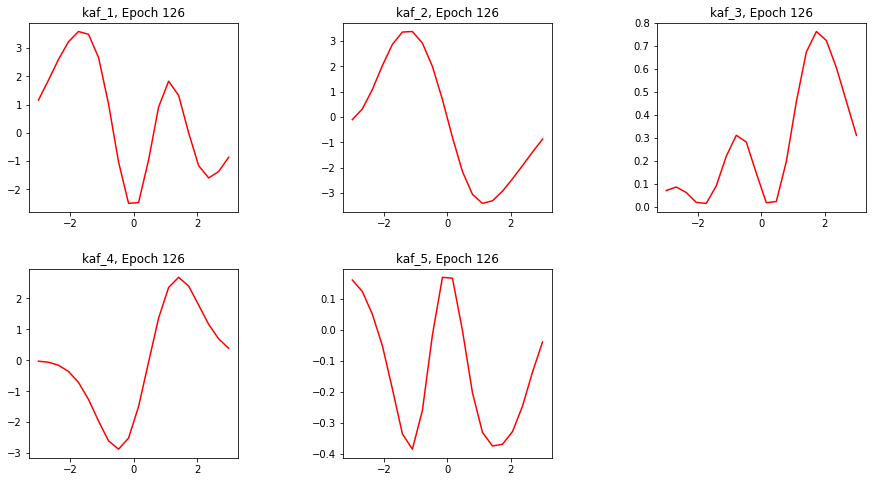

Epoch 126/150
391/391 [==============================] - 78s 200ms/step - loss: 0.2229 - accuracy: 0.9804 - val_loss: 0.5107 - val_accuracy: 0.8976


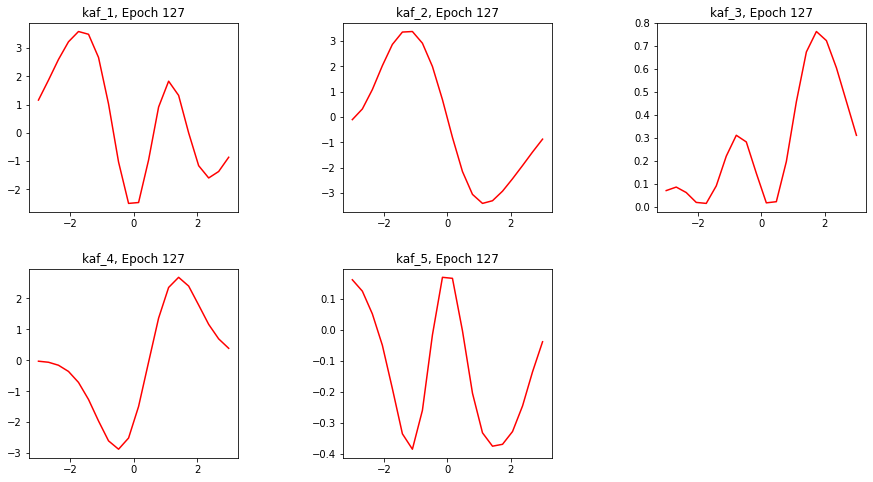

Epoch 127/150
391/391 [==============================] - 78s 200ms/step - loss: 0.2182 - accuracy: 0.9807 - val_loss: 0.5129 - val_accuracy: 0.8990


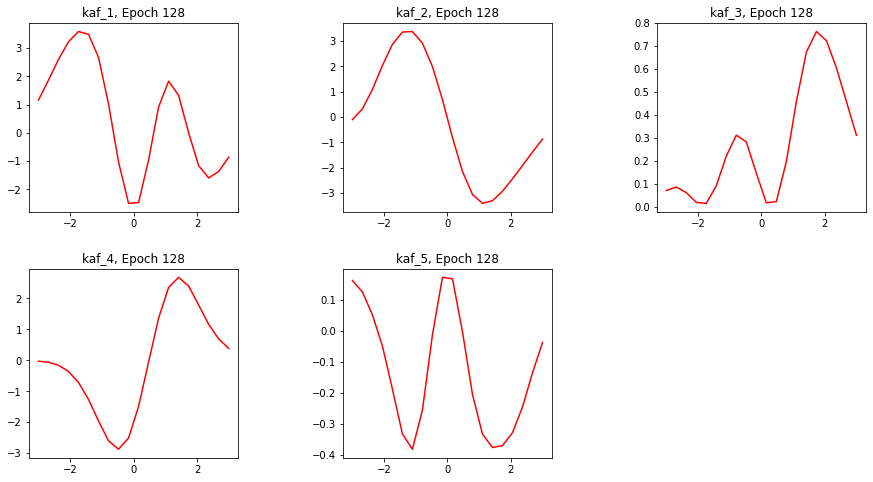

Epoch 128/150
391/391 [==============================] - 78s 200ms/step - loss: 0.2148 - accuracy: 0.9823 - val_loss: 0.5145 - val_accuracy: 0.8991


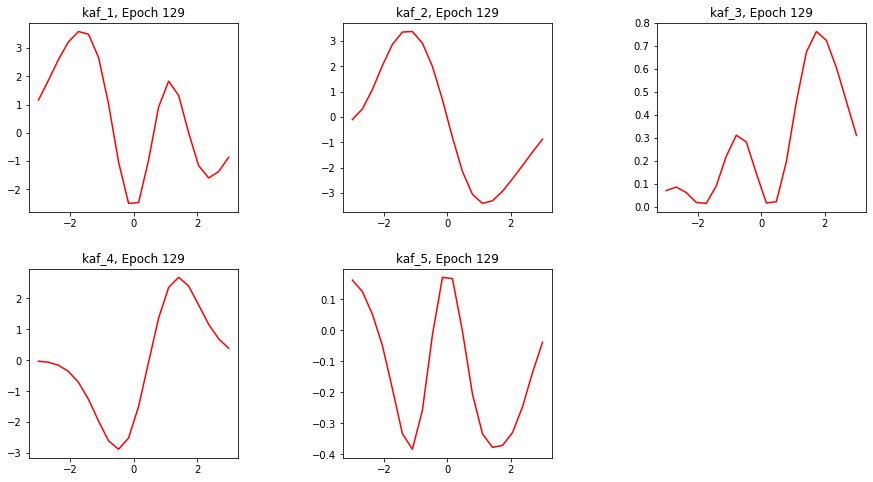

Epoch 129/150
391/391 [==============================] - 78s 200ms/step - loss: 0.2118 - accuracy: 0.9819 - val_loss: 0.5105 - val_accuracy: 0.8983


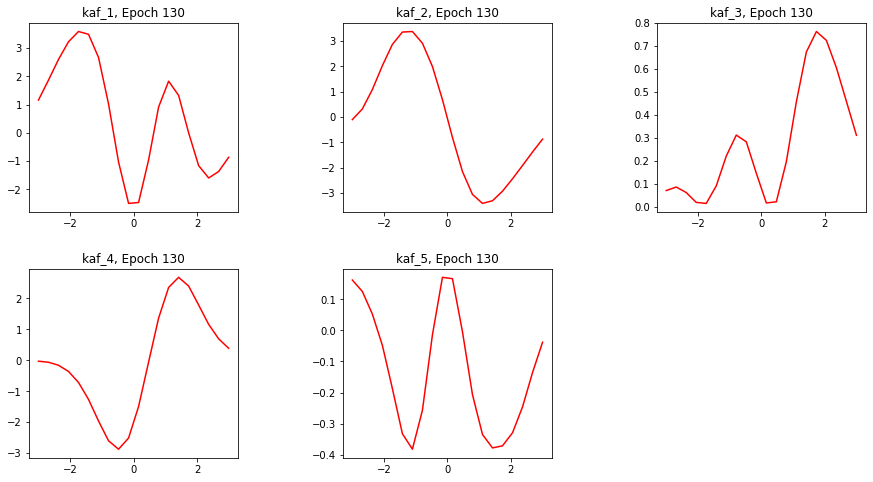

Epoch 130/150
359/391 [==========================>...] - ETA: 6s - loss: 0.2092 - accuracy: 0.9839Buffered data was truncated after reaching the output size limit.

In [ ]:
history = resnet_20_kafs.fit(x = train, epochs=150, validation_data=test, callbacks=[lr_callback, activationsf.plot_kafs_epoch_wise(5)])

In [ ]:
# Buffer limit reached for the output on the previous cell, thus evaluate
resnet_20_kafs.evaluate(x=test, batch_size=128)

79/79 [==============================] - 5s 59ms/step - loss: 0.5182 - accuracy: 0.9007


[0.5182223916053772, 0.9006999731063843]

### We reach ~ 90% of accuracy with kafs which is a reasonable result considering we did use the same setting (architecture, regularization, lr schedule that was tuned for relus)

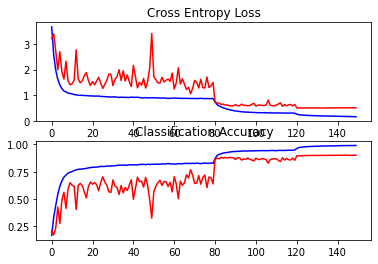

In [ ]:
summarize_diagnostics(history)

## What happens if we scale to deeper ResNets?
* In He et al. the best performing resnet for CIFAR10 has 56 layers
* We'd like to reproduce it and see if there are any gains by using kafs in deeper scenarios

In [ ]:
# n = 9
def resnet56(act = None, is_kaf = False):

  input = Input(shape=(32,32,3)) # padded cifar10 images size

  # Preparation Step
  x = Conv2D(16, kernel_size=(3, 3), padding='same', kernel_regularizer = regularizer)(input)
  x = BatchNormalization()(x)
  if is_kaf is not False:
    x = Kaf(24, True) (x)
  else:
    x = Activation(act)(x)

  # 1st stage: filter size 16, keep feature map size 
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)

  # 2nd stage: double filter size, half feature map size
  x = cifar_res_block(x, s=2, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)

  # 3rd stage: double filter size, half feature map size
  x = cifar_res_block(x, s=2, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)

  x = GlobalAveragePooling2D()(x)

  x = Dense(10, activation='softmax', kernel_initializer='he_normal', dtype=tf.float32, kernel_regularizer = regularizer)(x) 

  model = Model(inputs=input, outputs=x, name='dresnet')

  return model

In [ ]:
resnet_56_original = resnet56(act=tf.keras.activations.relu)

In [ ]:
resnet_56_original.summary()

Model: "dresnet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d_21 (Conv2D)              (None, 32, 32, 16)   448         input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_19 (BatchNo (None, 32, 32, 16)   64          conv2d_21[0][0]                  
__________________________________________________________________________________________________
activation (Activation)         (None, 32, 32, 16)   0           batch_normalization_19[0][0]     
____________________________________________________________________________________________

In [ ]:
resnet_56_original.compile(
    optimizer = tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.9),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)

In [ ]:
history = resnet_56_original.fit(x = train, epochs=150, validation_data=test, callbacks=[lr_callback])

Epoch 1/150
391/391 [==============================] - 32s 81ms/step - loss: 2.8004 - accuracy: 0.2776 - val_loss: 4.1539 - val_accuracy: 0.1153
Epoch 2/150
391/391 [==============================] - 31s 80ms/step - loss: 2.0491 - accuracy: 0.4251 - val_loss: 2.2388 - val_accuracy: 0.4139
Epoch 3/150
391/391 [==============================] - 31s 79ms/step - loss: 1.5576 - accuracy: 0.5650 - val_loss: 3.0143 - val_accuracy: 0.3501
Epoch 4/150
391/391 [==============================] - 31s 79ms/step - loss: 1.2654 - accuracy: 0.6696 - val_loss: 1.7196 - val_accuracy: 0.5644
Epoch 5/150
391/391 [==============================] - 31s 80ms/step - loss: 1.1211 - accuracy: 0.7273 - val_loss: 1.3064 - val_accuracy: 0.6594
Epoch 6/150
391/391 [==============================] - 31s 79ms/step - loss: 1.0452 - accuracy: 0.7551 - val_loss: 1.4493 - val_accuracy: 0.6251
Epoch 7/150
391/391 [==============================] - 31s 79ms/step - loss: 1.0022 - accuracy: 0.7726 - val_loss: 1.3632 - val_ac

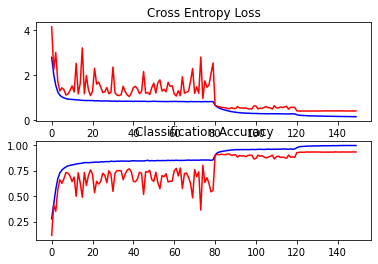

In [ ]:
summarize_diagnostics(history)

In [ ]:
# Buffer limit reached for the output on the previous cell, thus evaluate
resnet_56_original.evaluate(x=test, batch_size=128)

79/79 [==============================] - 1s 16ms/step - loss: 0.4246 - accuracy: 0.9322


[0.42459937930107117, 0.932200014591217]

93% accuracy, slightly under the 94% of the paper, again we used slightly different settings so we cosider it as a fair result

## Now we try again with Kafs to see what happens


In [ ]:
resnet_56_kafs = resnet56(is_kaf=True)

In [ ]:
resnet_56_kafs.summary()

Model: "dresnet"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 32, 16)   448         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 32, 16)   64          conv2d[0][0]                     
__________________________________________________________________________________________________
kaf (Kaf)                       (None, 32, 32, 16)   408         batch_normalization[0][0]        
____________________________________________________________________________________________

In [ ]:
resnet_56_kafs.compile(
    optimizer = tf.keras.optimizers.SGD(learning_rate=0.01, momentum=0.9),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)

In [ ]:
history = resnet_56_kafs.fit(x = train, epochs=150, validation_data=test, callbacks=[lr_callback])

Epoch 1/150
391/391 [==============================] - 466s 1s/step - loss: 3.3430 - accuracy: 0.1000 - val_loss: 3.3450 - val_accuracy: 0.1000
Epoch 2/150
391/391 [==============================] - 464s 1s/step - loss: 3.3431 - accuracy: 0.1000 - val_loss: 3.3432 - val_accuracy: 0.1000
Epoch 3/150
391/391 [==============================] - 464s 1s/step - loss: 3.3430 - accuracy: 0.1000 - val_loss: 3.3432 - val_accuracy: 0.1000
Epoch 4/150
391/391 [==============================] - 464s 1s/step - loss: 3.3431 - accuracy: 0.1000 - val_loss: 3.3431 - val_accuracy: 0.1000
Epoch 5/150
391/391 [==============================] - 464s 1s/step - loss: 3.3430 - accuracy: 0.1000 - val_loss: 3.3431 - val_accuracy: 0.1000
Epoch 6/150
391/391 [==============================] - 465s 1s/step - loss: 3.3431 - accuracy: 0.1000 - val_loss: 3.3430 - val_accuracy: 0.1000
Epoch 7/150
391/391 [==============================] - 464s 1s/step - loss: 3.3430 - accuracy: 0.1000 - val_loss: 3.3431 - val_accuracy:

KeyboardInterrupt: ignored

## What is going on here? Why is the network not learning?
* We even try different weight init., learning rates but still does not work
* We dig deeper by plotting the weights updates and gradients norm throughout the training
* Check what changes between the kaf case and the relu one
* For kafs, we also log distributions of the activations and their derivative wrt to the activation to check if this behaviour might be due to a vanishing/exploding gradients problem caused by the new activation functions
* Every log is processed in TensorBoard

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
# Create a log directory for the current experiment
import datetime

current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
train_log_dir = '/content/logs/gradient_tape/' + current_time + '/kaf'
train_summary_writer = tf.summary.create_file_writer(train_log_dir)

In [ ]:
from tensorflow.keras import Model

class TrainWithCustomLogsModel(Model):

    def __init__(self, **kwargs):
        super(TrainWithCustomLogsModel, self).__init__(**kwargs)
        self.step = tf.Variable(0, dtype=tf.int64,trainable=False)

    
    def get_hidden_layer_input(self, layer, x):
      ''' 
      Build a sub-model of model from buttom layer up to layer l_name.inputs, 
      and return activations to l_name given "inputs" as input 
      '''
      l_inp = layer.input
      hidden_model = Model(self.inputs, l_inp)
      activation = hidden_model(x)
      del hidden_model # Free space
      return activation


    def get_activation_eagerly(self, tf_bstring, x):
      '''
        Return activation to the kaf layer, its dictionary and kernel bandw
      '''
      layer_name_string = tf_bstring.numpy().decode('ASCII') # This can only be done here since train_step runs by default in graph-mode hence .numpy() is not allowed
      
      layer = self.get_layer(name = layer_name_string)
      
      x = tf.expand_dims(x, 0) # Add batch dimension
      d = layer.d.read_value()
      kb = layer.k_bandw
      activation = self.get_hidden_layer_input(layer, x)
      return (d, kb, activation)

    
    # @tf.function
    def kaf_derivative(self, x, a, d, k_bwidth ):
      """
      Compute the derivative of the kaf wrt x
      """
      x = tf.cast(tf.expand_dims(x, -1), dtype=tf.float16) # Add last dimension to compute the summation
      dictionary_dist = math.subtract(x, d)
      # Compute Kaf expansion matrix
      x = math.multiply(a, math.exp(math.multiply(-k_bwidth, math.square(dictionary_dist))))
      x = math.multiply(x, dictionary_dist)
      return tf.multiply(-2*k_bwidth, tf.reduce_sum(x, -1))


    def train_step(self, data):

        # Get batch images and labels
        x, y = data
        
        # Forward pass
        with tf.GradientTape() as tape:
            p = self(x , training = True) 
            loss = self.compiled_loss(y, p, regularization_losses=self.losses)
        
        # Backward pass
        trainable_vars = self.trainable_variables
        gradients = tape.gradient(loss, trainable_vars)

        self.step.assign_add(tf.constant(1, dtype=tf.int64)) # Increase step for the new iteration
        with train_summary_writer.as_default():
          
          for var, grad in zip(trainable_vars, gradients): # For each weights variable and its corresponding gradients
            
            name = var.name
            var, grad = tf.norm(tf.squeeze(var)), tf.norm(tf.squeeze(grad)) # Get the l2-norm for both of them

            # Log variables and gradients norm in Tensorboard
            tf.summary.scalar(name, var, step = self.step)
            tf.summary.scalar('Gradients_'+name, grad, step = self.step)

            if 'mix_coeffs' in name: # For each Kaf Layer
              # Log activations and kaf derivatives
              # Here we can appreciate the root cause of the exploding gradient
              
              # Get Kaf layer's name
              layer_name = tf.strings.split(name, '/', maxsplit=1)[0]
              # Get activation and it's attributes
              d, kb, activation = tf.py_function(func=self.get_activation_eagerly, inp=[layer_name, x[0]], Tout=(tf.float16, tf.float16,tf.float16)) # We need just one sample of the entire batch to get the idea
              tf.summary.histogram('Activation_to_'+name, activation, step=self.step)  
              
              derivative = self.kaf_derivative(activation, tf.cast(var, tf.float16), d, kb)
              tf.summary.histogram('Derivative_wrt_x_'+name, derivative, step=self.step)  
        
        # Update model's weights 
        self.optimizer.apply_gradients(zip(gradients, trainable_vars))
        del tape
        # Update metrics (includes the metric that tracks the loss)
        self.compiled_metrics.update_state(y, p)
        # Return a dict mapping metric names to current value
        return {m.name: m.result() for m in self.metrics}

## We log and compare different architectures in the following way
* Analyze only few (4) epochs
* First ResNet20, ResNet56 original
* Then KafResNet20, KafResNet56
* To better compare graphically such distributions on TensorBoard, restart the kernel after each training run 

In [ ]:
def resnet20_log(act = None, is_kaf = False):

  input = Input(shape=(32,32,3)) # padded cifar10 images size

  # Preparation Step
  x = Conv2D(16, kernel_size=(3, 3), padding='same', kernel_regularizer = regularizer)(input)
  x = BatchNormalization()(x)
  if is_kaf is not False:
    x = Kaf(20, True) (x)
  else:
    x = Activation(act)(x)

  # 1st stage: filter size 16, keep feature map size 
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)

  # 2nd stage: double filter size, half feature map size
  x = cifar_res_block(x, s=2, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)

  # 3rd stage: double filter size, half feature map size
  x = cifar_res_block(x, s=2, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)

  x = GlobalAveragePooling2D()(x)

  x = Dense(10, activation='softmax', kernel_initializer='he_normal', dtype=tf.float32, kernel_regularizer = regularizer)(x) 

  model = TrainWithCustomLogsModel(inputs=input, outputs=x, name='resnet') # Logger Model

  return model

In [ ]:
# n = 9
def resnet56_log(act = None, is_kaf = False):

  input = Input(shape=(32,32,3)) # padded cifar10 images size

  # Preparation Step
  x = Conv2D(16, kernel_size=(3, 3), padding='same', kernel_regularizer = regularizer)(input)
  x = BatchNormalization()(x)
  if is_kaf is not False:
    x = Kaf(20, True) (x)
  else:
    x = Activation(act)(x)

  # 1st stage: filter size 16, keep feature map size 
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=16, activation = act, kaf = is_kaf)

  # 2nd stage: double filter size, half feature map size
  x = cifar_res_block(x, s=2, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=32, activation = act, kaf = is_kaf)

  # 3rd stage: double filter size, half feature map size
  x = cifar_res_block(x, s=2, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)
  x = cifar_res_block(x, s=1, filters=64, activation = act, kaf = is_kaf)

  x = GlobalAveragePooling2D()(x)

  x = Dense(10, activation='softmax', kernel_initializer='he_normal', dtype=tf.float32, kernel_regularizer = regularizer)(x) 

  model = TrainWithCustomLogsModel(inputs=input, outputs=x, name='dresnet') # Logger Model

  return model

In [ ]:
resnet_20_original_log = resnet20_log(tf.keras.activations.relu)

resnet_20_original_log.compile(
    optimizer = tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.9),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)

history = resnet_20_original_log.fit(x = train, epochs=4)
# Restart Runtime

Epoch 1/4
391/391 [==============================] - 17s 45ms/step - loss: 1.9310 - accuracy: 0.3979
Epoch 2/4
391/391 [==============================] - 18s 46ms/step - loss: 1.3662 - accuracy: 0.6039
Epoch 3/4
391/391 [==============================] - 17s 44ms/step - loss: 1.1327 - accuracy: 0.6897
Epoch 4/4
391/391 [==============================] - 18s 46ms/step - loss: 1.0241 - accuracy: 0.7358


In [ ]:
resnet_56_original_log = resnet56_log(tf.keras.activations.relu)

resnet_56_original_log.compile(
    optimizer = tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.9),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)

history = resnet_56_original_log.fit(x = train, epochs=4)
# Restart Runtime

Epoch 1/4
391/391 [==============================] - 41s 105ms/step - loss: 2.7297 - accuracy: 0.2699
Epoch 2/4
391/391 [==============================] - 42s 107ms/step - loss: 2.0937 - accuracy: 0.3772
Epoch 3/4
391/391 [==============================] - 42s 108ms/step - loss: 1.7047 - accuracy: 0.4866
Epoch 4/4
391/391 [==============================] - 42s 108ms/step - loss: 1.4039 - accuracy: 0.5975


In [ ]:
resnet_20_kafs_log = resnet20_log(is_kaf=True)

resnet_20_kafs_log.compile(
    optimizer = tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.9),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)

history = resnet_20_kafs_log.fit(x = train, epochs=4)
# Restart Runtime

Epoch 1/4
391/391 [==============================] - 291s 745ms/step - loss: 3.4327 - accuracy: 0.2122
Epoch 2/4
391/391 [==============================] - 292s 747ms/step - loss: 2.4776 - accuracy: 0.3456
Epoch 3/4
391/391 [==============================] - 293s 749ms/step - loss: 1.9115 - accuracy: 0.4550
Epoch 4/4
391/391 [==============================] - 295s 754ms/step - loss: 1.5084 - accuracy: 0.5731


In [ ]:
resnet_56_kafs_log = resnet56_log(is_kaf = True)

resnet_56_kafs_log.compile(
    optimizer = tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.9),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)

history = resnet_56_kafs_log.fit(x = train, epochs=4)
# One epoch is enough here

Epoch 1/4
391/391 [==============================] - 1678s 4s/step - loss: 3.3438 - accuracy: 0.1000
Epoch 2/4
  1/391 [..............................] - ETA: 0s - loss: 3.3348 - accuracy: 0.1328

KeyboardInterrupt: ignored

In [ ]:
# Display Results
%tensorboard --logdir /content/logs/gradient_tape

<IPython.core.display.Javascript object>

In [ ]:
# Store logs 
from google.colab import files

!zip -r /content/exploding_kafresnet.zip /content/logs
files.download("/content/exploding_kafresnet.zip")

	zip warning: missing end signature--probably not a zip file (did you
	zip warning: remember to use binary mode when you transferred it?)
	zip warning: (if you are trying to read a damaged archive try -F)

zip error: Zip file structure invalid (/content/exploding_kafresnet.zip)


In [ ]:
# To load them
# !unzip exploding_kafresnet.zip -d ./

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Data Analysis
* The gradients exploding problem becomes apparent already in the first epoch in the early layers
* Indeed gradients eventually become NaNs after an impressive grow
* Moreover, the weights get never updated during the training. I believe due to the optimizer being unable to compute weights update with NaNs values.
* Why then activation distributions to the kaf layers change so much? Specifically, it seems that they tend to be smoother and smoother across steps, for every kaf layer

### Log only the first iteration for both kaf_resnet20 and kaf_resnet56 to better check differences in activations/derivative

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

# Create a log directory for the current experiment
import datetime

current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
train_log_dir = '/content/logs/oneshot/' + current_time + '/kaf'
train_summary_writer = tf.summary.create_file_writer(train_log_dir)

In [ ]:
resnet_20_kafs_log = resnet20_log(is_kaf = True)

resnet_20_kafs_log.compile(
    optimizer = tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.9),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)

history = resnet_20_kafs_log.fit(x = train, epochs=1, steps_per_epoch=1)
# Restart runtime

1/1 [==============================] - 0s 2ms/step - loss: 2.6644 - accuracy: 0.1094


In [ ]:
resnet_56_kafs_log = resnet56_log(is_kaf = True)

resnet_56_kafs_log.compile(
    optimizer = tf.keras.optimizers.SGD(learning_rate=0.1, momentum=0.9),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)

history = resnet_56_kafs_log.fit(x = train, epochs=1, steps_per_epoch=1)

1/1 [==============================] - 0s 2ms/step - loss: 3.3402 - accuracy: 0.0859


In [ ]:
# Display Results
%tensorboard --logdir /content/logs/oneshot

Reusing TensorBoard on port 6008 (pid 1657), started 0:11:03 ago. (Use '!kill 1657' to kill it.)

<IPython.core.display.Javascript object>

## Data Analysis
* The average value for the derivative wrt of each kaf is usally very small, should't we experience a vanishing gradient problem instead?!
* Moreover, for both shallow and deeper kafresnet such values look very similar
* I really have no clue on what is going on

In [ ]:
# Store logs 
from google.colab import files

!zip -r /content/exploding_kafresnet_oneshot.zip /content/logs
files.download("/content/exploding_kafresnet_oneshot.zip")

  adding: content/logs/ (stored 0%)
  adding: content/logs/.ipynb_checkpoints/ (stored 0%)
  adding: content/logs/oneshot/ (stored 0%)
  adding: content/logs/oneshot/20200820-154917/ (stored 0%)
  adding: content/logs/oneshot/20200820-154917/kaf/ (stored 0%)
  adding: content/logs/oneshot/20200820-154917/kaf/events.out.tfevents.1597938557.ce4aa44d5b0f.1922.114.v2 (deflated 70%)
  adding: content/logs/oneshot/20200820-154740/ (stored 0%)
  adding: content/logs/oneshot/20200820-154740/kaf/ (stored 0%)
  adding: content/logs/oneshot/20200820-154740/kaf/events.out.tfevents.1597938460.ce4aa44d5b0f.1855.114.v2 (deflated 69%)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>